# **pass to mdeling I will use LSTM and a hybrid approach ✅**

In [1]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Mon May 13 10:38:13 2024       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 527.99       Driver Version: 527.99       CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name            TCC/WDDM | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ... WDDM  | 00000000:01:00.0 Off |                  N/A |
| N/A   66C    P0    N/A /  N/A |    175MiB /  2048MiB |     12%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
import tensorflow as tf
tf.test.is_gpu_available()

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.


True

In [3]:
import numpy as np
import pandas as pd
#import warnings
#import datetime
import matplotlib.pyplot as plt
#import itertools
#import torch
#import statsmodels.api as sm
import matplotlib.pyplot as plt
#import torch.nn.functional as F
#from statsmodels.tsa.arima_model import ARIMA
#from statsmodels.graphics.tsaplots import plot_acf
#from statsmodels.graphics.tsaplots import plot_pacf
#from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.metrics import mean_squared_error, mean_absolute_error,mean_absolute_percentage_error,mean_squared_log_error
from torch import nn
%matplotlib inline
from torch.autograd import Variable
from torch.utils.data import Dataset,DataLoader,TensorDataset
from sklearn.preprocessing import MinMaxScaler

In [4]:
# **Data processing libraries:**
import pandas as pd  # Data analysis and manipulation
import numpy as np  # Numerical computing
#from prophet import Prophet
# **Data cleaning libraries:**
#import missingno as msno  # Missing data visualization and imputation
#import dataprep.clean  # Data cleaning and preparation
%matplotlib inline
# **Data visualization libraries:**
#import seaborn as sns  # Statistical data visualization
import matplotlib.pyplot as plt  # 2D and 3D plotting
#import plotly.express as px  # Interactive visualizations
#import plotly.graph_objects as go  # Interactive data visualization
#import polars as pl
# **Machine learning libraries:**
import sklearn  # Machine learning algorithms
from IPython.core.pylabtools import figsize
figsize(12, 4)
import datetime

In [4]:
import tensorflow as tf

print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


In [121]:
file= '../data/consommation.csv'
data=pd.read_csv(file)

grouped_data = data.groupby(['product_type','is_business','county'])

df = grouped_data.get_group((1,0,0))

train_size = int(len(df) * 0.8)
train_df = df[:train_size]
test_df = df[train_size:]

In [74]:
df1=grouped_data.get_group((1,0,4))

In [12]:


print(f"Train data size: {len(train_df)}")
print(f"Test data size: {len(test_df)}")

Train data size: 5595
Test data size: 1399


In [8]:
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score
from keras.models import Sequential
from keras.layers import Dense
from keras.callbacks import EarlyStopping
from keras.optimizers import Adam
from keras.layers import LSTM
from keras.layers import Dense, Activation, Embedding, Dropout, TimeDistributed,Input
data['datetime'] = pd.to_datetime(data['datetime'])



In [ ]:
# prompt: I want to print start date time and end

start_date_time = data['datetime'].min()
end_date_time = data['datetime'].max()

print(f"Start date and time: {start_date_time}")
print(f"End date and time: {end_date_time}")


Start date and time: 2021-09-01 00:00:00
End date and time: 2023-05-29 10:00:00


In [ ]:
# prompt: I want put the culumns target is at the end

cols = list(data.columns)
cols.remove('target')
cols.append('target')
data = data[cols]


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 439422 entries, 0 to 439421
Data columns (total 28 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0   datetime                439422 non-null  datetime64[ns]
 1   product_type            439422 non-null  int64         
 2   county                  439422 non-null  int64         
 3   eic_count               439422 non-null  int64         
 4   installed_capacity      439422 non-null  float64       
 5   is_business             439422 non-null  int64         
 6   target                  439422 non-null  float64       
 7   temperature             439422 non-null  float64       
 8   dewpoint                439422 non-null  float64       
 9   rain                    439422 non-null  float64       
 10  snowfall                439422 non-null  float64       
 11  surface_pressure        439422 non-null  float64       
 12  cloudcover_total        439422

**⚡use ESRNN⚡**

In [ ]:
!pip install tensorflow

**1/using LSTM**

I want group each client and train


In [ ]:
from keras.preprocessing.sequence import TimeseriesGenerator
from IPython.display import display

In [12]:
data.columns

Index(['Unnamed: 0', 'datetime', 'product_type', 'county', 'eic_count',
       'installed_capacity', 'is_business', 'target', 'temperature',
       'dewpoint', 'rain', 'snowfall', 'surface_pressure', 'cloudcover_total',
       'windspeed_10m', 'winddirection_10m', 'shortwave_radiation',
       'direct_solar_radiation', 'diffuse_radiation', 'lowest_price_per_mwh',
       'highest_price_per_mwh', 'elect_prices', 'hour', 'dayofweek', 'quarter',
       'month', 'year', 'dayofyear', 'day'],
      dtype='object')

In [13]:
features=data[[ 'eic_count', 'installed_capacity',
        'temperature', 'dewpoint', 'rain', 'snowfall',
       'surface_pressure', 'cloudcover_total', 'windspeed_10m',
       'winddirection_10m', 'shortwave_radiation', 'direct_solar_radiation',
       'diffuse_radiation', 'lowest_price_per_mwh', 'highest_price_per_mwh',
       'elect_prices']].to_numpy().tolist()

In [14]:
target=data['target'].tolist()


In [31]:
train_df[cols]

,eic_count,installed_capacity,temperature,dewpoint,rain,snowfall,surface_pressure,cloudcover_total,windspeed_10m,winddirection_10m,...,highest_price_per_mwh,elect_prices,hour,dayofweek,quarter,month,year,dayofyear,day,target
0,108,952.89,13.600000,10.600000,0.0,0.0,1008.433333,58.833333,4.972222,340.000000,...,46.32,92.51,0,2,3,9,2021,244,1,96.590
1,108,952.89,13.566667,10.266667,0.0,0.0,1008.350000,32.333333,5.069444,344.833333,...,46.32,88.90,1,2,3,9,2021,244,1,77.691
2,108,952.89,13.100000,9.966667,0.0,0.0,1008.000000,16.500000,4.907407,340.666667,...,46.32,87.35,2,2,3,9,2021,244,1,91.594
3,108,952.89,12.716667,9.800000,0.0,0.0,1007.966667,10.500000,4.814815,336.000000,...,46.32,86.88,3,2,3,9,2021,244,1,87.955
4,108,952.89,12.366667,9.816667,0.0,0.0,1007.733333,4.500000,4.527778,331.500000,...,46.32,88.43,4,2,3,9,2021,244,1,88.184
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5590,387,3650.78,-3.616667,-4.016667,0.0,0.0,1032.266667,89.833333,1.856481,59.500000,...,68.94,81.43,3,6,1,1,2023,22,22,831.553
5591,387,3650.78,-3.716667,-4.133333,0.0,0.0,1032.500000,90.000000,1.768519,45.833333,...,68.94,81.94,4,6,1,1,2023,22,22,790.271
5592,387,3650.78,-3.766667,-4.233333,0.0,0.0,1032.600000,90.000000,1.898148,36.166667,...,68.94,108.59,5,6,1,1,2023,22,22,814.932
5593,387,3650.78,-3.800000,-4.300000,0.0,0.0,1032.666667,90.000000,2.138889,37.166667,...,68.94,62.25,6,6,1,1,2023,22,22,837.361


trainX shape == (4871, 24, 24).
trainY shape == (4871, 1).
Num GPUs Available:  1
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 24, 32)            5568      
                                                                 
 gru_1 (GRU)                 (None, 32)                6336      
                                                                 
 dropout (Dropout)           (None, 32)                0         
                                                                 
 dense (Dense)               (None, 1)                 33        
                                                                 
Total params: 11,937
Trainable params: 11,937
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
439/439 [==============================] - 12s 13ms/step - loss: 0.2371 - val_loss: 0.5134


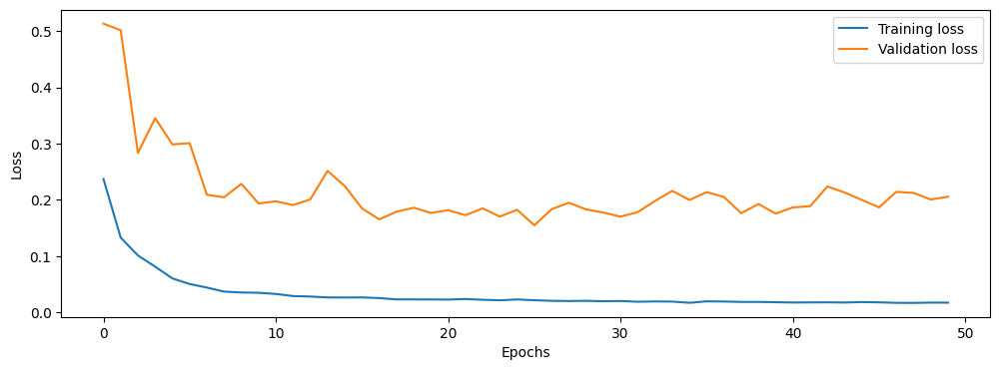

In [9]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, GRU
import matplotlib.pyplot as plt



cols = ['eic_count', 'installed_capacity', 'temperature', 'dewpoint',
        'rain', 'snowfall', 'surface_pressure', 'cloudcover_total', 'windspeed_10m',
        'winddirection_10m', 'shortwave_radiation', 'direct_solar_radiation',
        'diffuse_radiation', 'lowest_price_per_mwh', 'highest_price_per_mwh',
        'elect_prices', 'hour', 'dayofweek', 'quarter', 'month', 'year',
        'dayofyear', 'day', 'target']
scaled_data = pd.DataFrame()


    # Extract the necessary columns and convert them to float
df_for_training = train_df[cols].astype(float)

    # Normalize the dataset
scaler = StandardScaler()
df_for_training_scaled = scaler.fit_transform(df_for_training)

trainX = []
trainY = []
n_future = 1  # Number of days we want to look into the future based on the past days.
n_past = 24  # Number of past days we want to use to predict the future.

for i in range(n_past, len(df_for_training_scaled) - n_future + 1):
        trainX.append(df_for_training_scaled[i - n_past:i])
        trainY.append(df_for_training_scaled[i + n_future - 1:i + n_future, -1])  # Target column is the last one

trainX, trainY = np.array(trainX), np.array(trainY)

print('trainX shape == {}.'.format(trainX.shape))

print('trainY shape == {}.'.format(trainY.shape))


# Check if GPU is available
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

# Define the LSTM model
model = Sequential()
model.add(GRU(32, activation='tanh', input_shape=(trainX.shape[1], trainX.shape[2]), return_sequences=True))
model.add(GRU(32, activation='tanh', return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(1))  # Output dimension is 1 as we're predicting a single value
model.compile(optimizer='adam', loss='mse')
model.summary()


    # Fit the model
history = model.fit(trainX, trainY, epochs=50, batch_size=10, validation_split=0.1, verbose=1)

    # Plot training history
plt.plot(history.history['loss'], label='Training loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

  


15/15 [==============================] - 1s 7ms/step


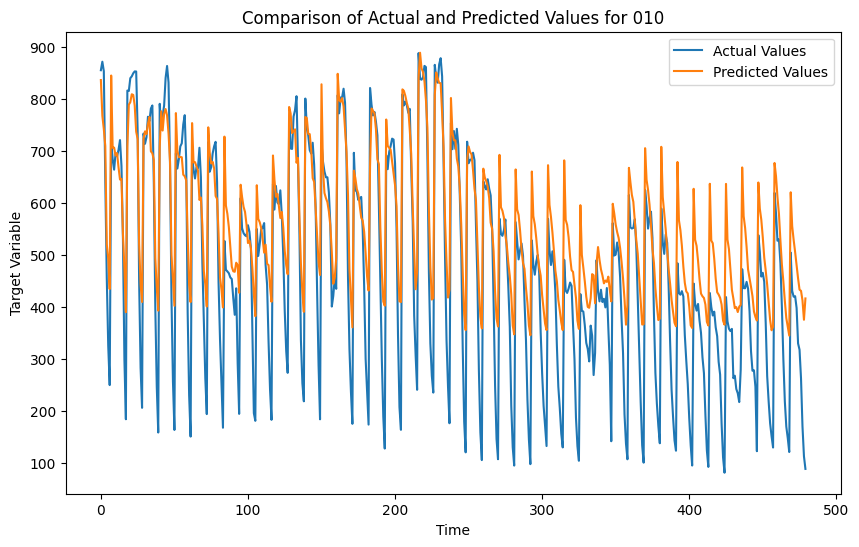

R2 Score: 0.6523577914277413
MSE: 15786.914350517793
RMSE: 125.64598819905788
MAE: 99.41256706339519



In [10]:
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score


df_test = test_df[cols].astype(float)

# Use the scaler from the training to transform the test data
df_test_scaµled1= scaler.fit(df_test)
df_test_scaled = scaler.transform(df_test)

# Initialize the lists for testX and testY
testX = []
testY = []


# Prepare testX and testY
for i in range(n_past, len(df_test_scaled) - n_future + 1):
    testX.append(df_test_scaled[i - n_past:i])
    testY.append(df_test_scaled[i + n_future - 1:i + n_future, -1])  # Assuming the last column is still the target

testX, testY = np.array(testX), np.array(testY)



n_days_for_prediction = 480



target_scaler = StandardScaler()
target_scaler.fit(df_test[['target']])


# Predict on the last n_days_for_prediction
prediction_scaled = model.predict(testX[-n_days_for_prediction:])
prediction = target_scaler.inverse_transform(prediction_scaled)
actual = target_scaler.inverse_transform(testY[-n_days_for_prediction:])


# Calculate the metrics
r2 = r2_score(actual, prediction)
mse = mean_squared_error(actual, prediction)
rmse = np.sqrt(mse)
mae = mean_absolute_error(actual, prediction)

# Plotting
plt.figure(figsize=(10,6))
plt.plot(actual, label='Actual Values')
plt.plot(prediction, label='Predicted Values')
plt.title(f'Comparison of Actual and Predicted Values for 010')
plt.xlabel('Time')
plt.ylabel('Target Variable')
plt.legend()
plt.show()


print(f"R2 Score: {r2}")
print(f"MSE: {mse}")
print(f"RMSE: {rmse}")
print(f"MAE: {mae}\n")


In [ ]:
# prompt: I want take just the dataframe from grouped_test_prod who have the combinaion (county=0 , product_type=1, is_busenss=0) and to save it as df_test

df_test = grouped_test.get_group((0, 1, 0))


**lstm for production**

In [ ]:
cols = ['eic_count', 'installed_capacity', 'temperature', 'dewpoint',
        'rain', 'snowfall', 'surface_pressure', 'cloudcover_total', 'windspeed_10m',
        'winddirection_10m', 'shortwave_radiation', 'direct_solar_radiation',
        'diffuse_radiation', 'lowest_price_per_mwh', 'highest_price_per_mwh',
        'elect_prices', 'hour', 'dayofweek', 'quarter', 'month', 'year',
        'dayofyear', 'day', 'target']

8/8 [==============================] - 3s 10ms/step


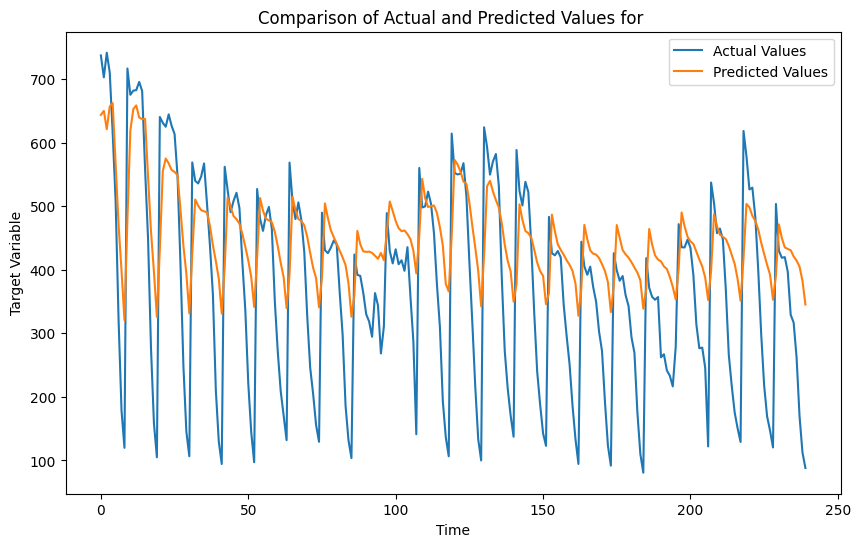

R2 Score: 0.2985313831827151
MSE: 18882.899140769507
RMSE: 137.4150615499244
MAE: 110.8918782155355



In [28]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from keras.models import load_model
import matplotlib.pyplot as plt

# Load your saved model
df_test = test_df[cols].astype(float)

scaler = StandardScaler()


# Use the scaler from the training to transform the test data
df_test_scaled1= scaler.fit(df_test)
df_test_scaled = scaler.transform(df_test)

# Initialize the lists for testX and testY
testX = []
testY = []
 # Same as during training
n_days_for_prediction=120
# Prepare testX and testY
for i in range(n_past, len(df_test_scaled) - n_future + 1):
    testX.append(df_test_scaled[i - n_past:i])
    testY.append(df_test_scaled[i + n_future - 1:i + n_future, -1])  # Assuming the last column is still the target

testX, testY = np.array(testX), np.array(testY)





n_days_for_prediction = 240



target_scaler = StandardScaler()
target_scaler.fit(df_test[['target']])


# Predict on the last n_days_for_prediction
prediction_scaled = model.predict(testX[-n_days_for_prediction:])
prediction = target_scaler.inverse_transform(prediction_scaled)
actual = target_scaler.inverse_transform(testY[-n_days_for_prediction:])

# Calculate the metrics
r2 = r2_score(actual, prediction)
mse = mean_squared_error(actual, prediction)
rmse = np.sqrt(mse)
mae = mean_absolute_error(actual, prediction)

# Plotting
plt.figure(figsize=(10,6))
plt.plot(actual, label='Actual Values')
plt.plot(prediction, label='Predicted Values')
plt.title(f'Comparison of Actual and Predicted Values for ')
plt.xlabel('Time')
plt.ylabel('Target Variable')
plt.legend()
plt.show()

# Print metrics
print(f"R2 Score: {r2}")
print(f"MSE: {mse}")
print(f"RMSE: {rmse}")
print(f"MAE: {mae}\n")



In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
import matplotlib.pyplot as plt

scaled_data = pd.DataFrame()

# Keep a list to store scalers for each group for the target variable
target_scalers = []

# Initialize lists to store metrics for each group
r2_scores = []
mses = []
rmses = []
maes = []
n_days_for_prediction=1200
# Assuming grouped_data is defined somewhere
# Iterate over each group
for name, group in grouped_data:
    # Your existing code to prepare training data...

    # Save the scaler for the target variable
    target_scaler = StandardScaler()
    target_scaler.fit(group[['target']])
    target_scalers.append(target_scaler)

    # Your existing model training code...

    # After training the model, predict on the test set or a slice of training set for demonstration
    prediction_scaled = model.predict(trainX[-n_days_for_prediction:])

    # Reverse scaling for the prediction and the actual values
    prediction = target_scaler.inverse_transform(prediction_scaled)
    actual = target_scaler.inverse_transform(trainY[-n_days_for_prediction:])

    # Calculate the metrics
    r2 = r2_score(actual, prediction)
    mse = mean_squared_error(actual, prediction)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(actual, prediction)

    # Store metrics in their respective lists
    r2_scores.append(r2)
    mses.append(mse)
    rmses.append(rmse)
    maes.append(mae)

    # Plotting the real values vs predictions
    plt.figure(figsize=(10,6))
    plt.plot(actual, label='Actual Values')
    plt.plot(prediction, label='Predicted Values')
    plt.title(f'Comparison of Actual and Predicted Values for {name}')
    plt.xlabel('Time')
    plt.ylabel('Target Variable')
    plt.legend()
    plt.show()

# Print or store the metrics as needed
# For example, to print them:
for i, name in enumerate(grouped_data):
    print(f"Group: {name}")
    print(f"R2 Score: {r2_scores[i]}")
    print(f"MSE: {mses[i]}")
    print(f"RMSE: {rmses[i]}")
    print(f"MAE: {maes[i]}\n")


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from keras.models import load_model
import matplotlib.pyplot as plt

# Load your saved model
model_path = '/content/drive/MyDrive/LstMmodel1.h5' # Make sure the path is correctly formatted
model = load_model(model_path)

# Example of how grouped_data might be defined or filtered for the specific group
# Assuming 'grouped_data' is a DataFrame that includes a column for each group identifier
# grouped_data = ...

# Filter for the specific group combination (0, 1, 0)
specific_group = grouped_data[grouped_data['group_column'] == (0, 1, 0)]

# Initialize variables for evaluation
n_days_for_prediction = 1200
target_scaler = StandardScaler()

# Assuming 'target' is the column you want to predict
target_scaler.fit(specific_group[['target']])

# Your code to prepare training data goes here...
# Ensure you use specific_group instead of iterating over all groups
# trainX, trainY = ...

# Predict on the test set or a slice of training set for demonstration
prediction_scaled = model.predict(trainX[-n_days_for_prediction:])

# Reverse scaling for the prediction and the actual values
prediction = target_scaler.inverse_transform(prediction_scaled)
actual = target_scaler.inverse_transform(trainY[-n_days_for_prediction:])

# Calculate the metrics
r2 = r2_score(actual, prediction)
mse = mean_squared_error(actual, prediction)
rmse = np.sqrt(mse)
mae = mean_absolute_error(actual, prediction)

# Plotting the real values vs predictions for the specific group
plt.figure(figsize=(10,6))
plt.plot(actual, label='Actual Values')
plt.plot(prediction, label='Predicted Values')
plt.title('Comparison of Actual and Predicted Values for Group (0, 1, 0)')
plt.xlabel('Time')
plt.ylabel('Target Variable')
plt.legend()
plt.show()

# Print the metrics
print(f"Group: (0, 1, 0)")
print(f"R2 Score: {r2}")
print(f"MSE: {mse}")
print(f"RMSE: {rmse}")
print(f"MAE: {mae}\n")



KeyError: 'Column not found: group_column'

38/38 [==============================] - 1s 13ms/step


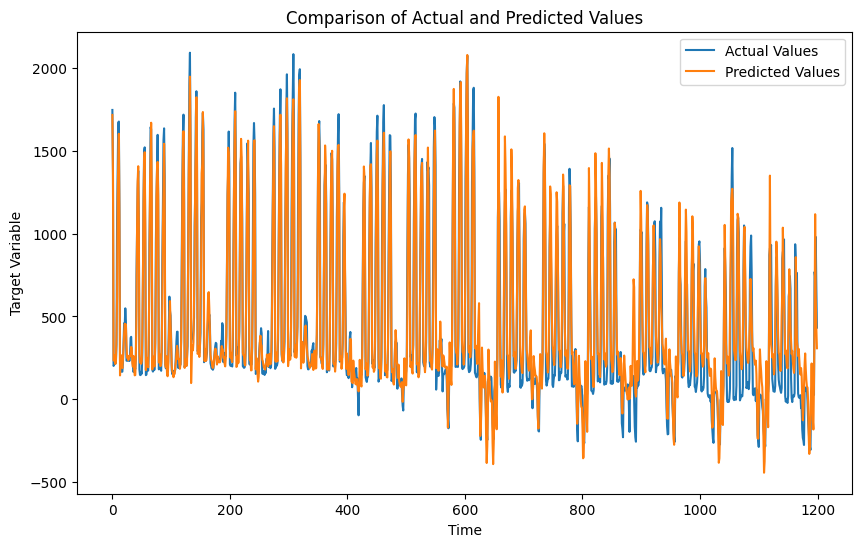

38/38 [==============================] - 1s 14ms/step


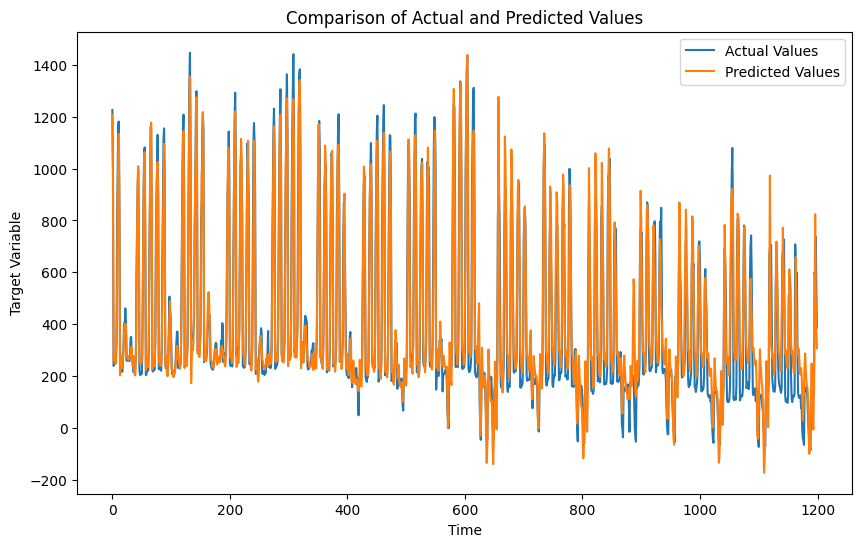

38/38 [==============================] - 1s 16ms/step


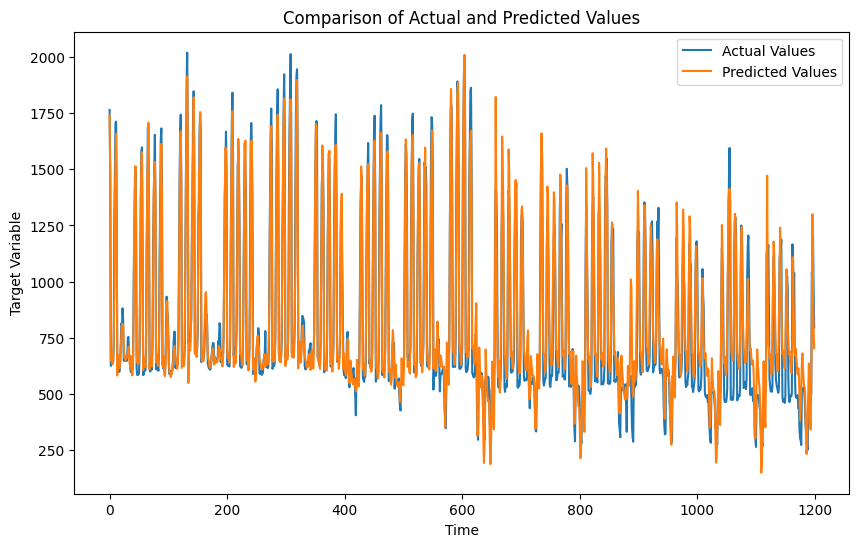

38/38 [==============================] - 1s 14ms/step


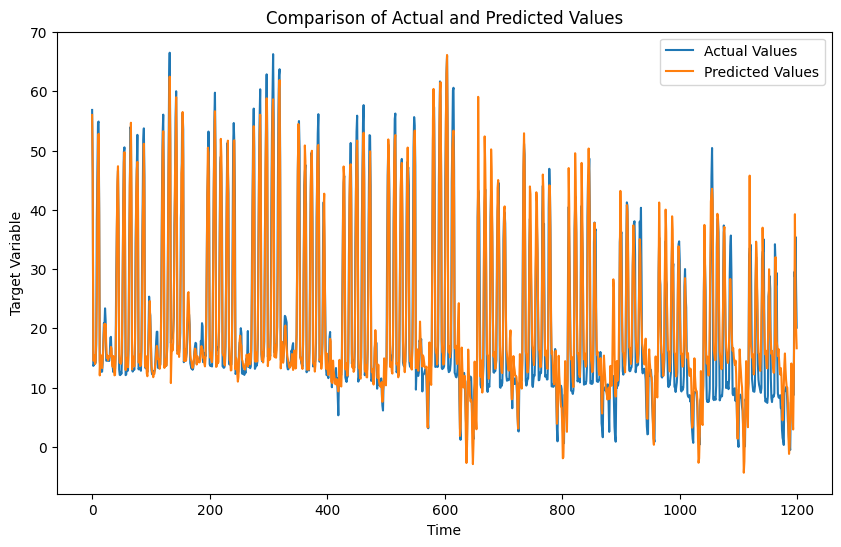

38/38 [==============================] - 1s 15ms/step


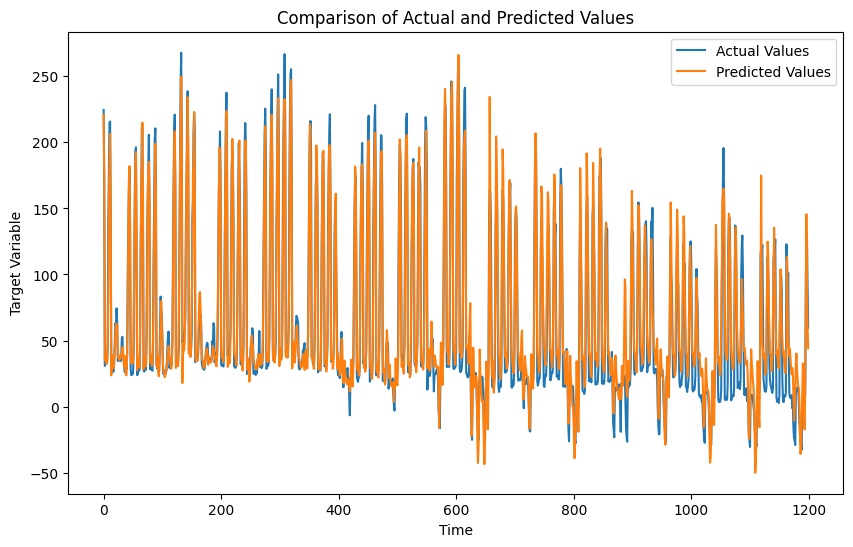

38/38 [==============================] - 1s 14ms/step


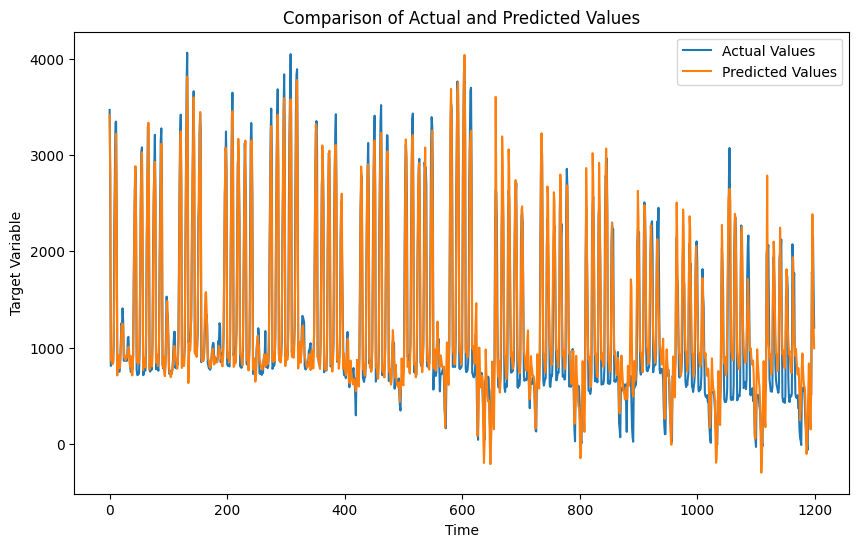

38/38 [==============================] - 1s 14ms/step


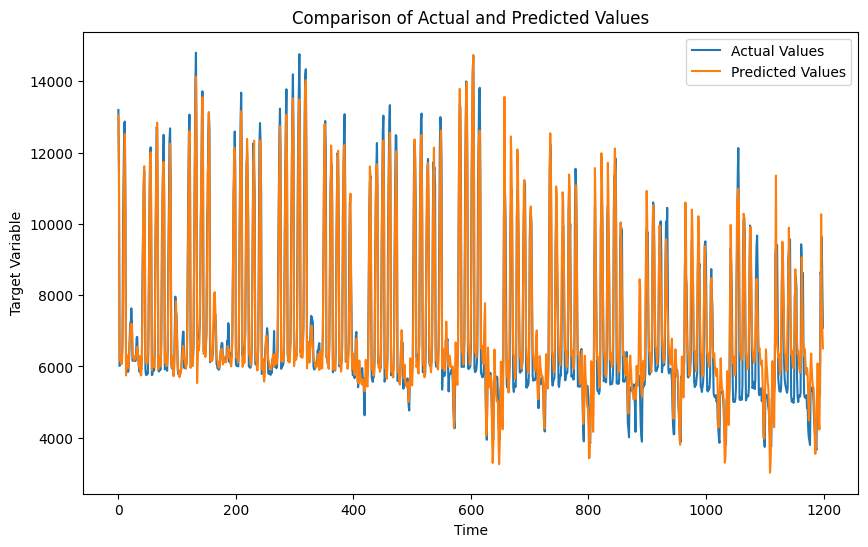

38/38 [==============================] - 1s 17ms/step


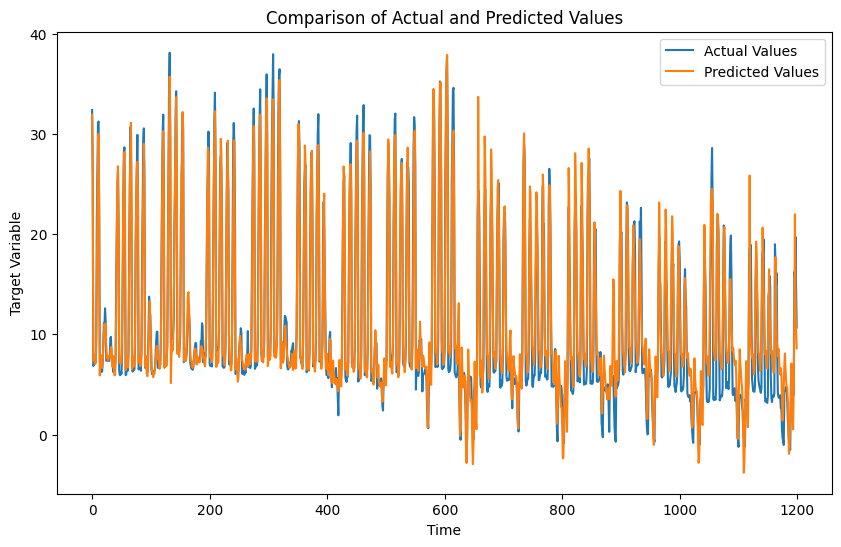

38/38 [==============================] - 1s 19ms/step


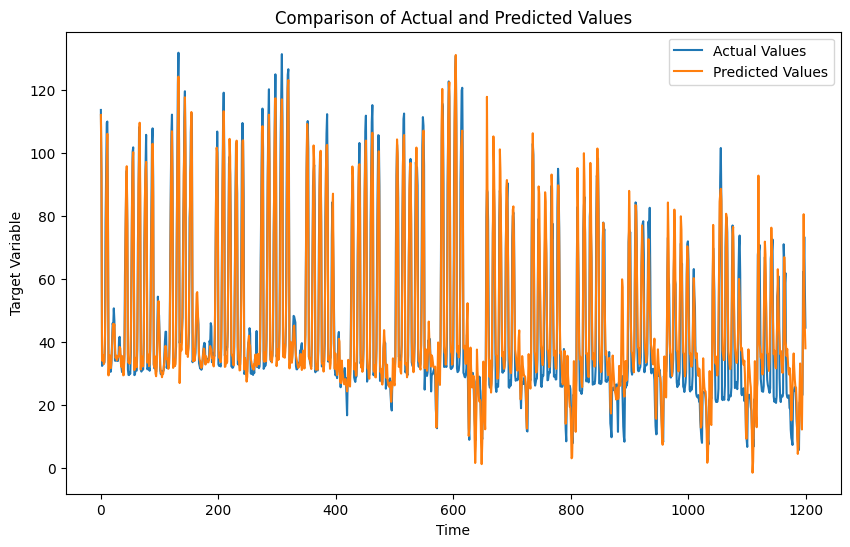

38/38 [==============================] - 1s 20ms/step


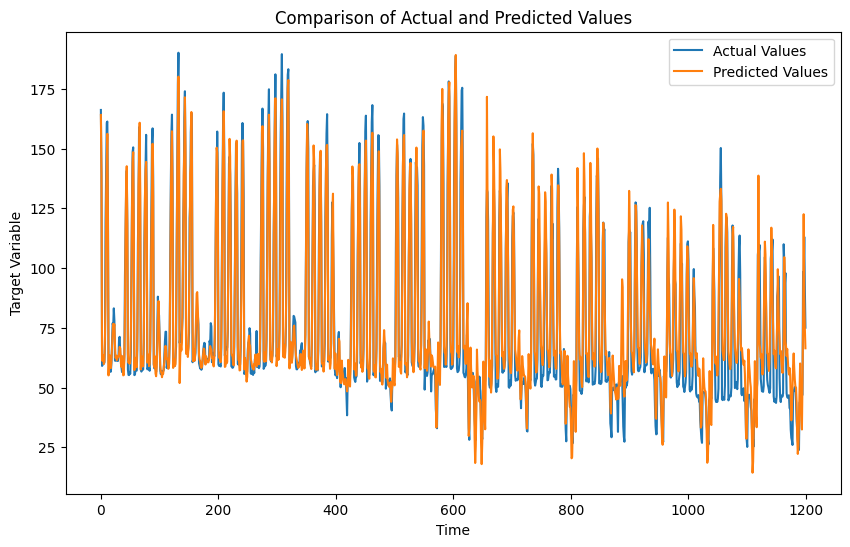

38/38 [==============================] - 1s 21ms/step


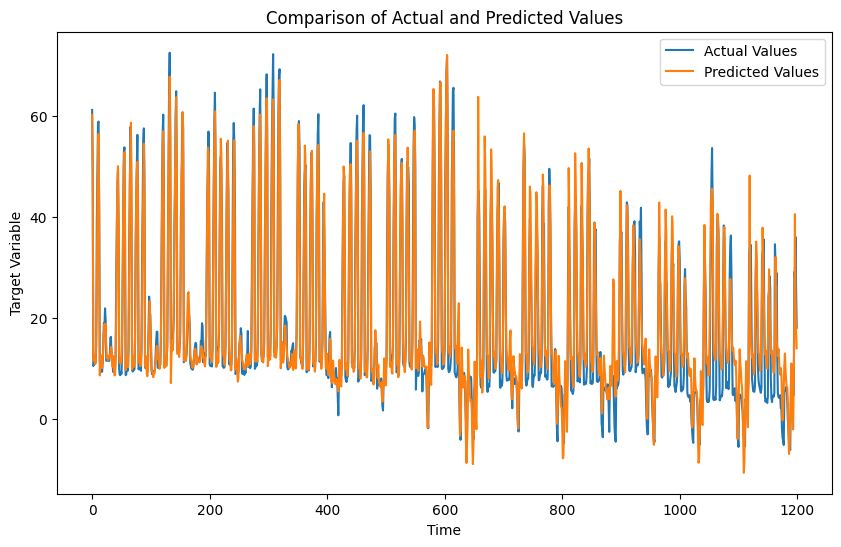

38/38 [==============================] - 1s 18ms/step


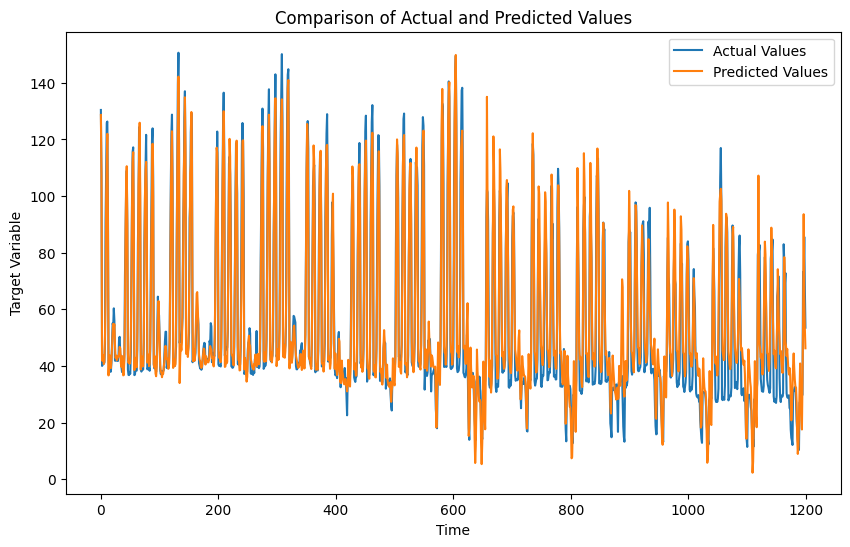

38/38 [==============================] - 1s 18ms/step


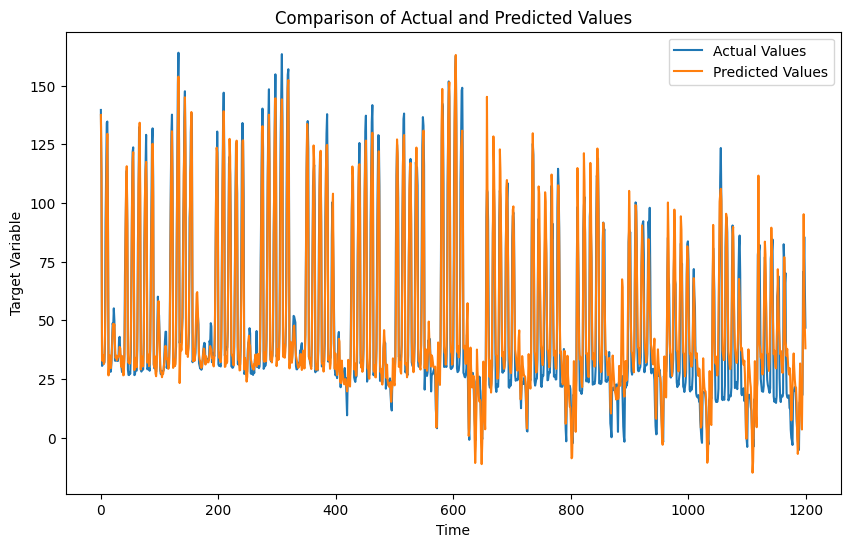

38/38 [==============================] - 1s 17ms/step


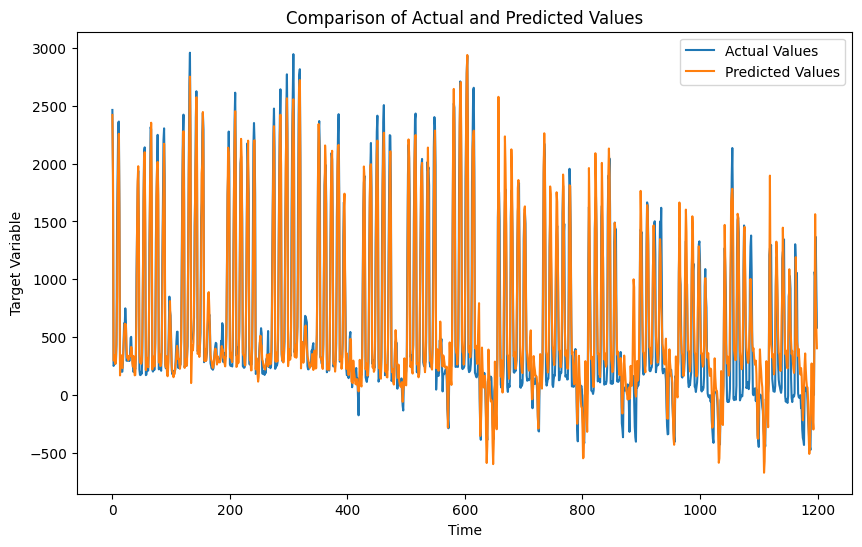

38/38 [==============================] - 1s 17ms/step


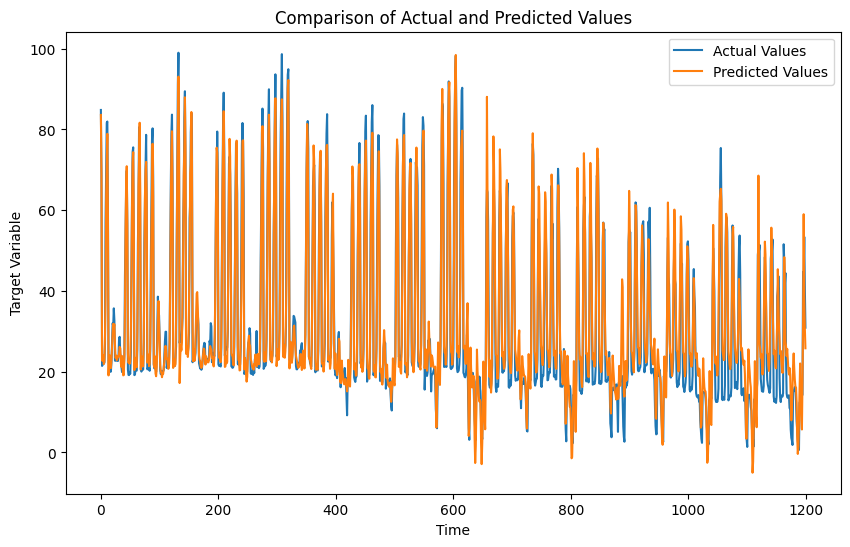

38/38 [==============================] - 1s 16ms/step


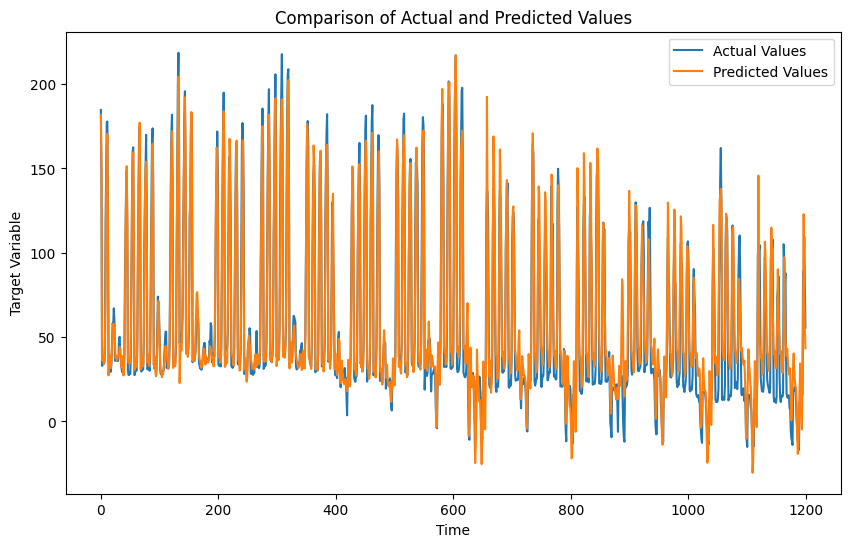

38/38 [==============================] - 1s 16ms/step


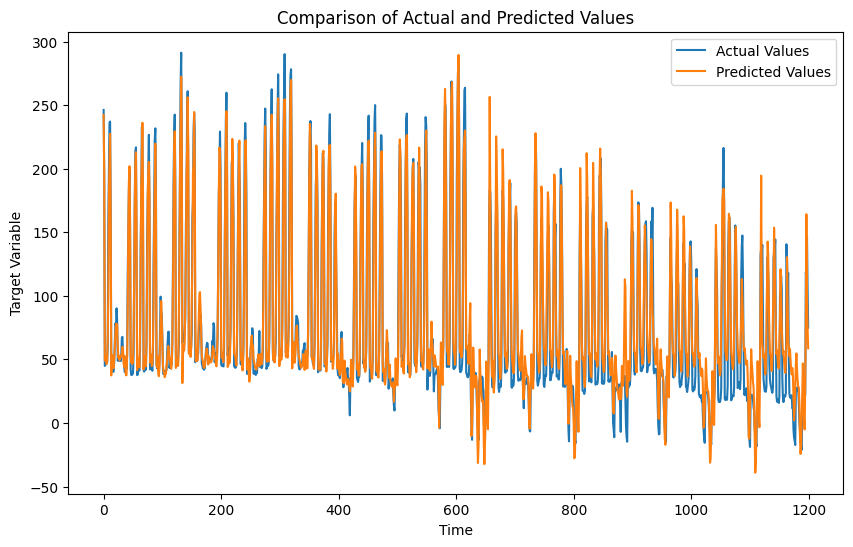

38/38 [==============================] - 1s 17ms/step


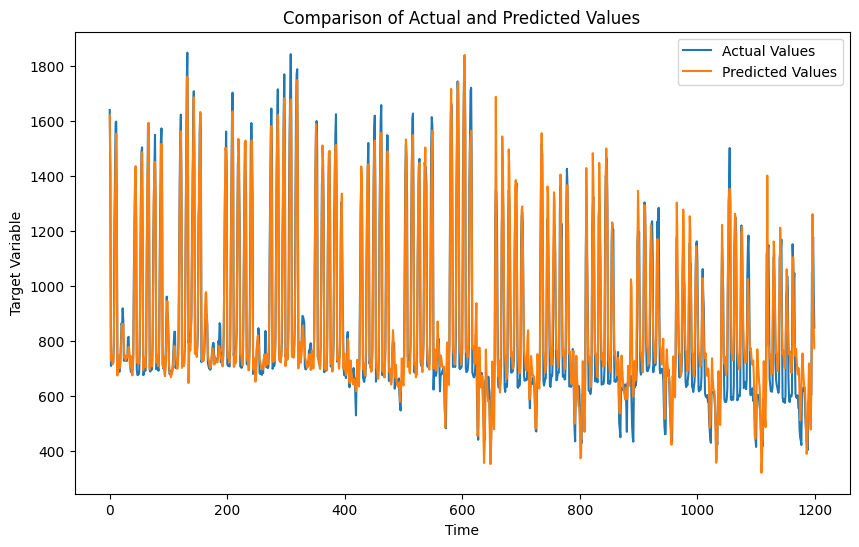

38/38 [==============================] - 1s 21ms/step


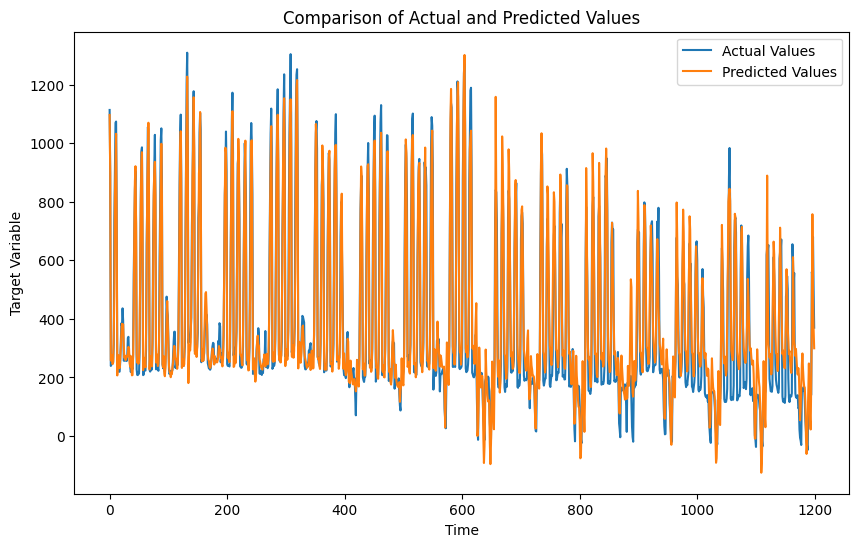

38/38 [==============================] - 1s 18ms/step


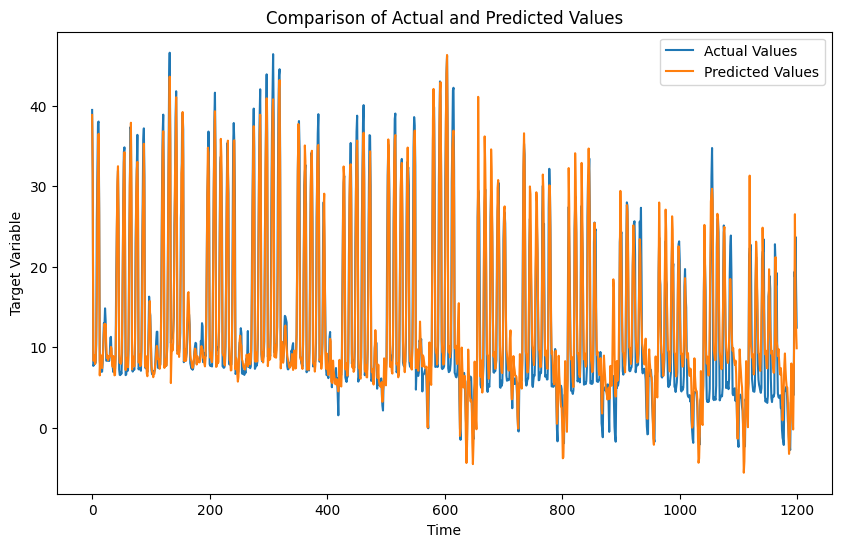

38/38 [==============================] - 1s 23ms/step


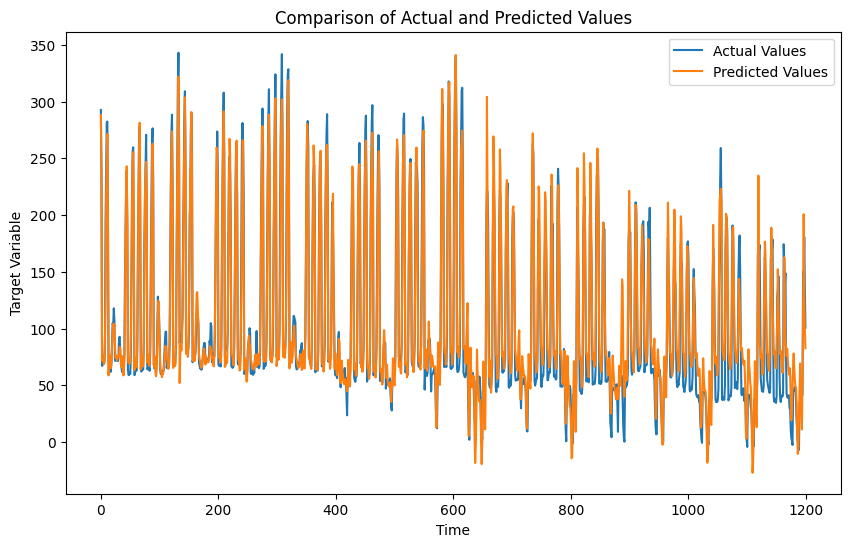

38/38 [==============================] - 1s 19ms/step


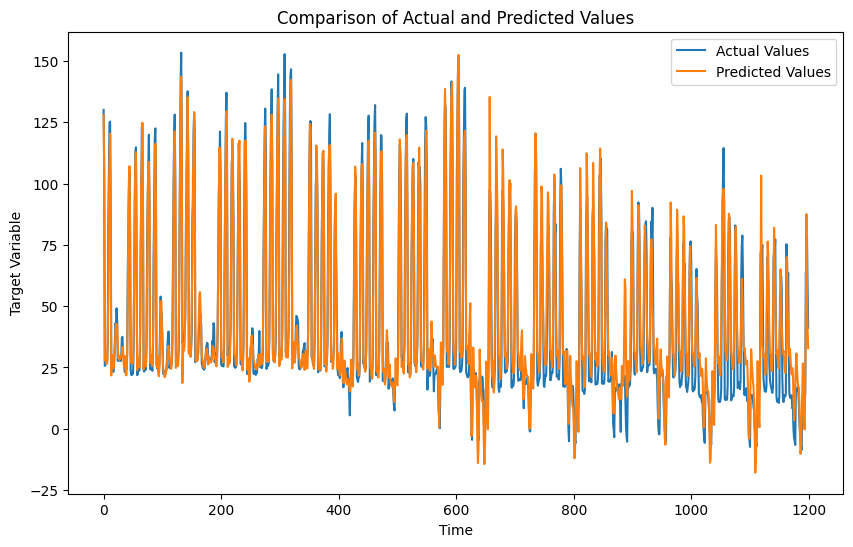

38/38 [==============================] - 1s 19ms/step


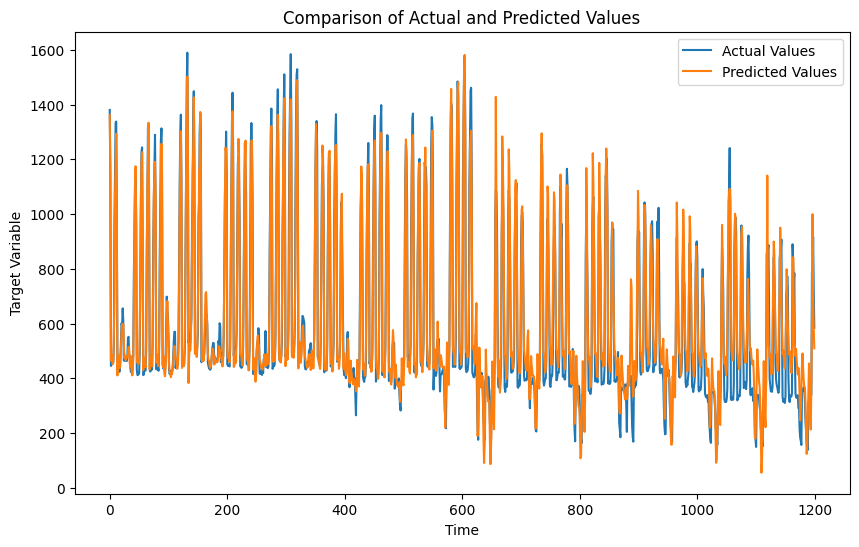

38/38 [==============================] - 1s 18ms/step


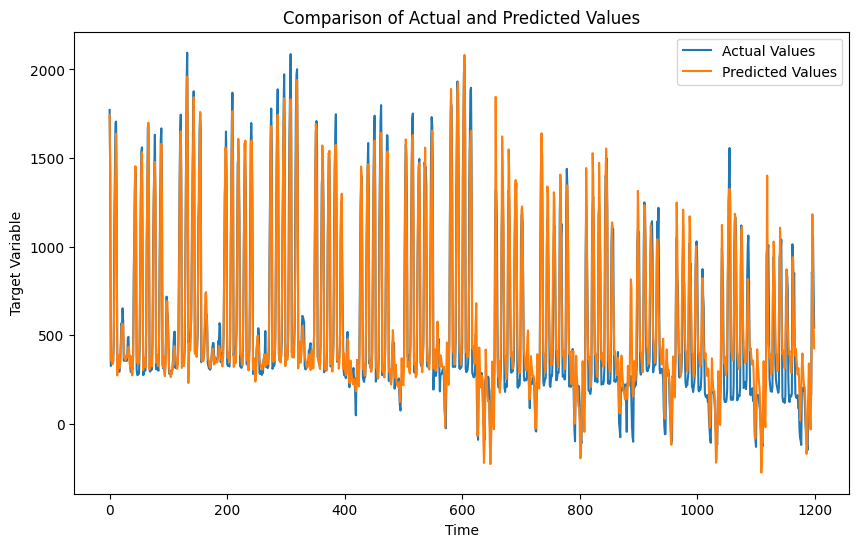

38/38 [==============================] - 1s 17ms/step


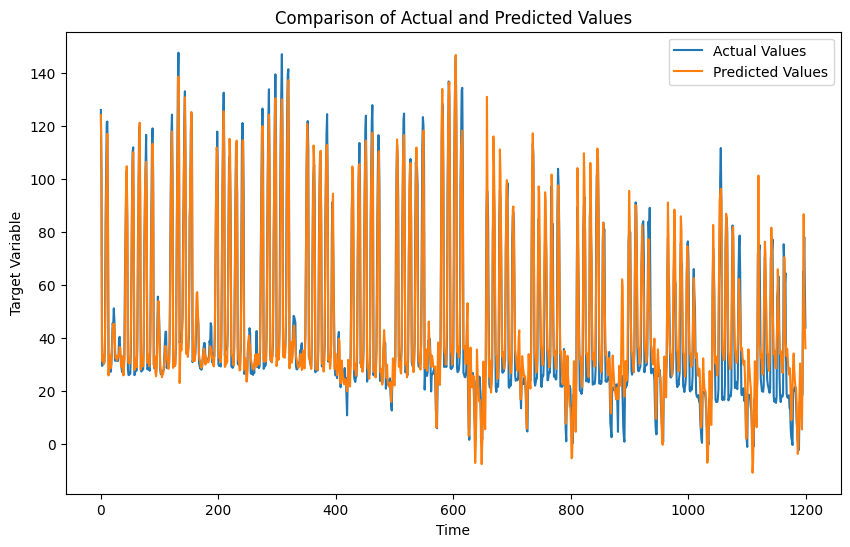

38/38 [==============================] - 1s 16ms/step


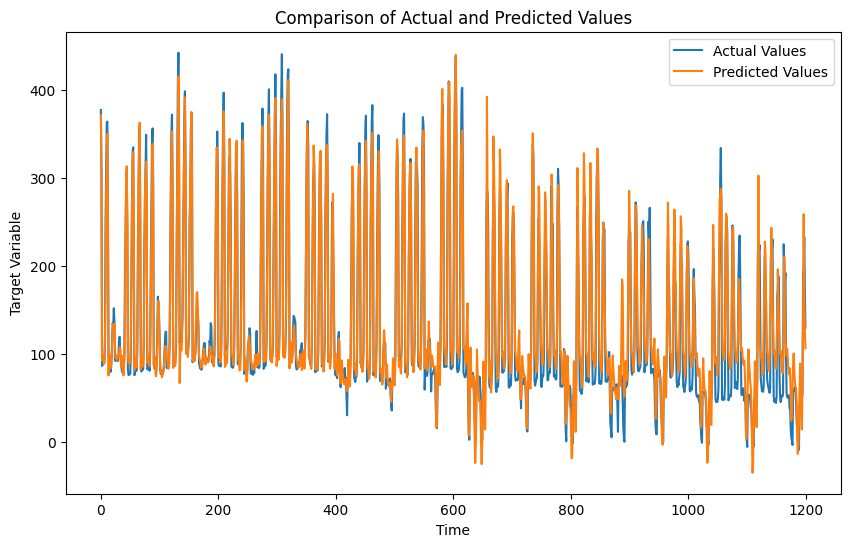

38/38 [==============================] - 1s 16ms/step


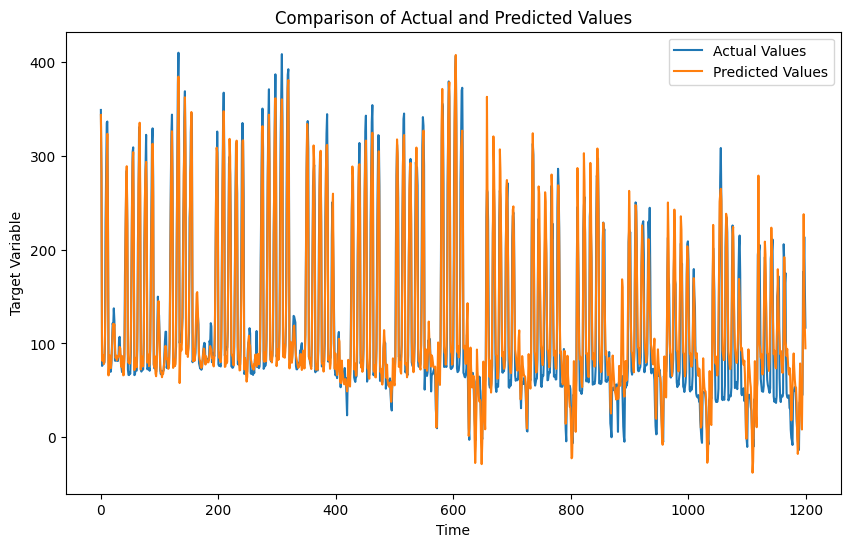

38/38 [==============================] - 1s 17ms/step


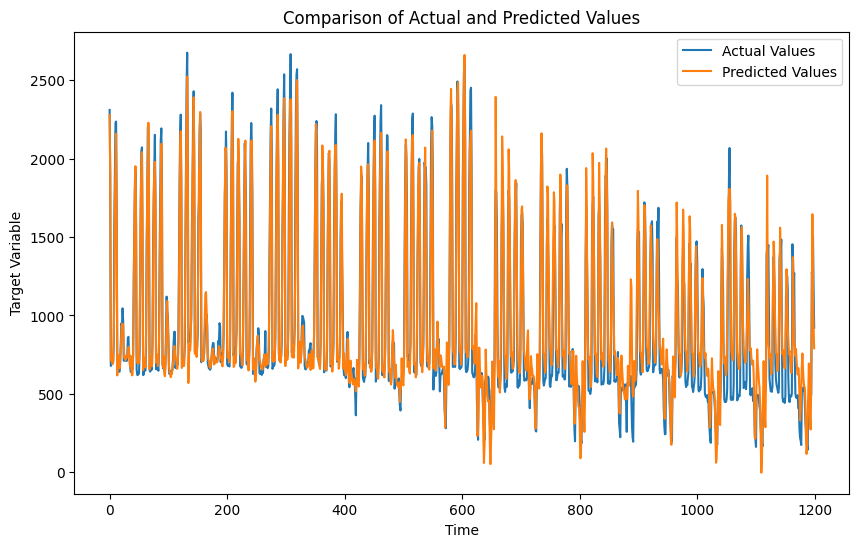

38/38 [==============================] - 1s 22ms/step


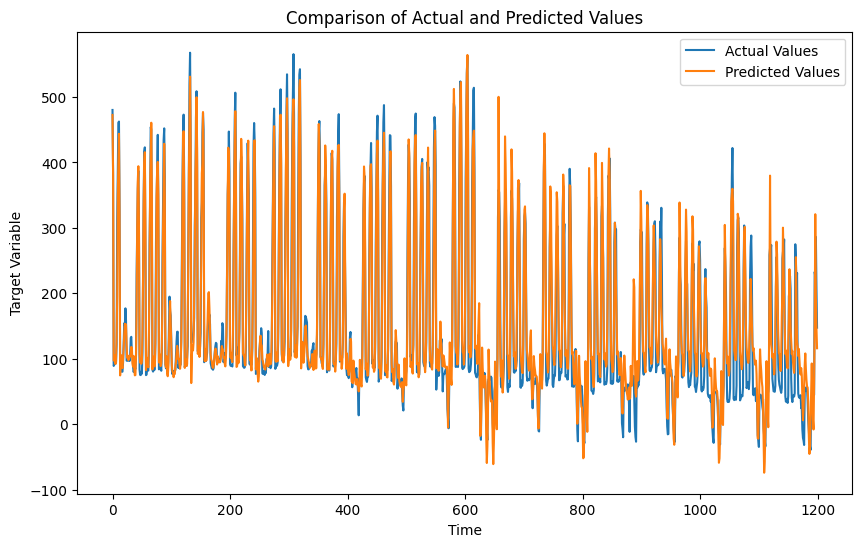

38/38 [==============================] - 1s 18ms/step


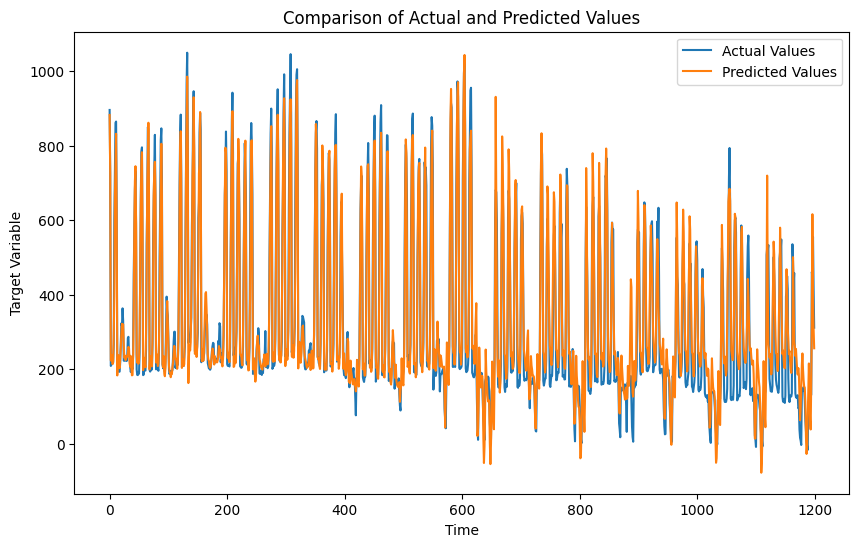

38/38 [==============================] - 1s 17ms/step


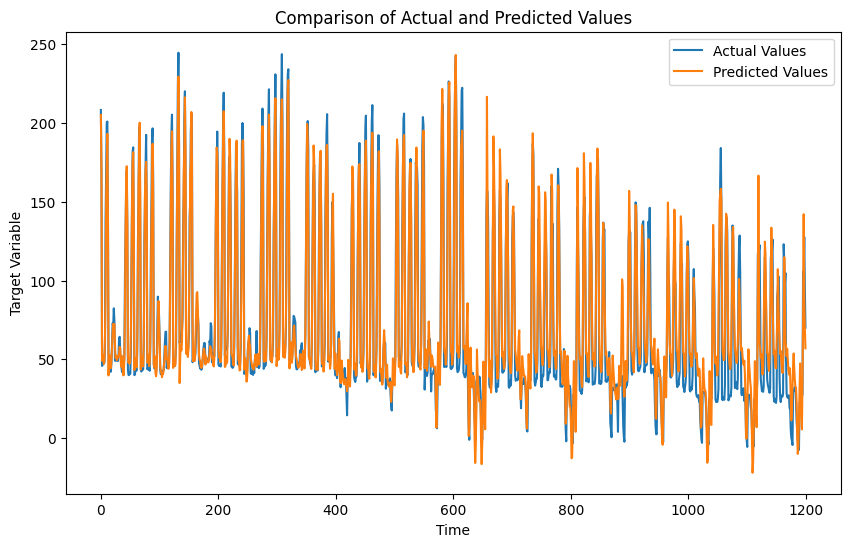

38/38 [==============================] - 1s 18ms/step


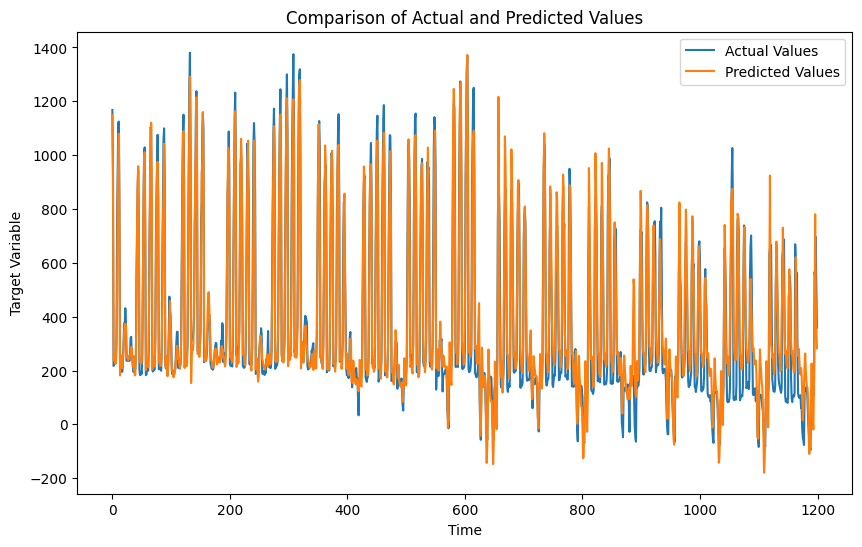

38/38 [==============================] - 1s 18ms/step


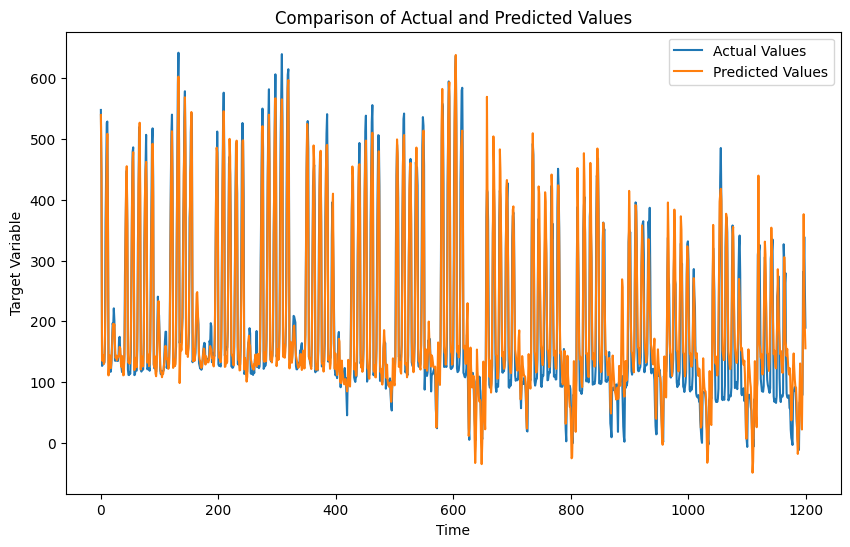

38/38 [==============================] - 1s 19ms/step


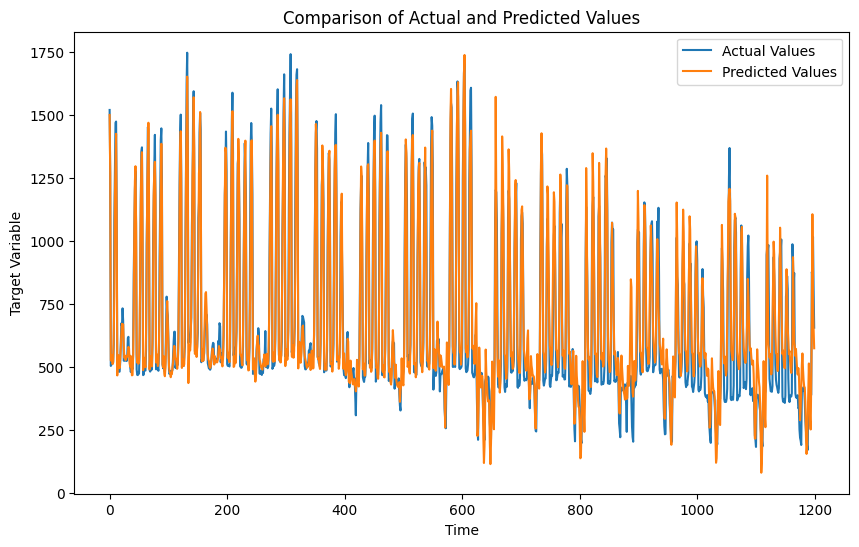

38/38 [==============================] - 1s 18ms/step


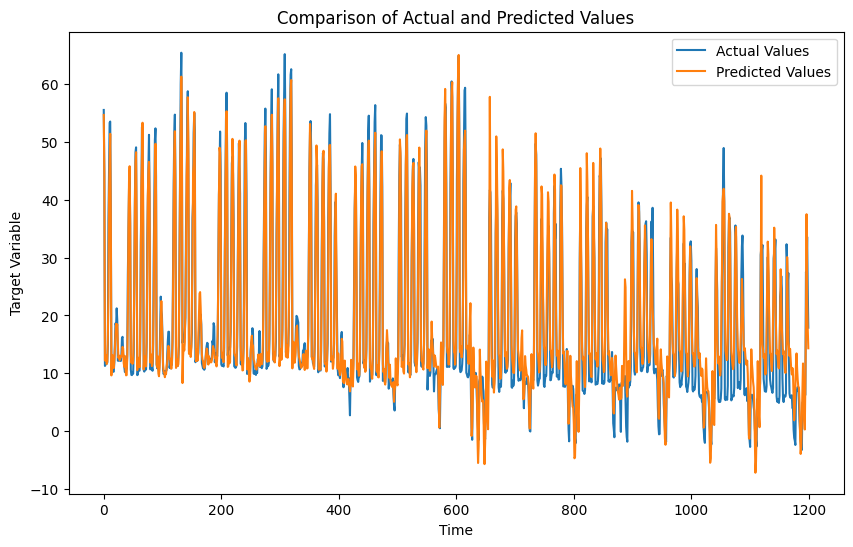

38/38 [==============================] - 1s 20ms/step


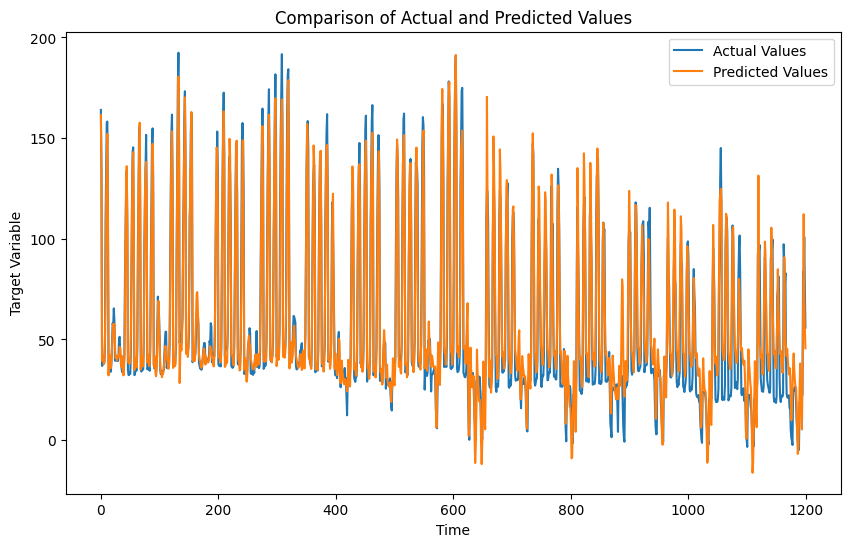

38/38 [==============================] - 1s 18ms/step


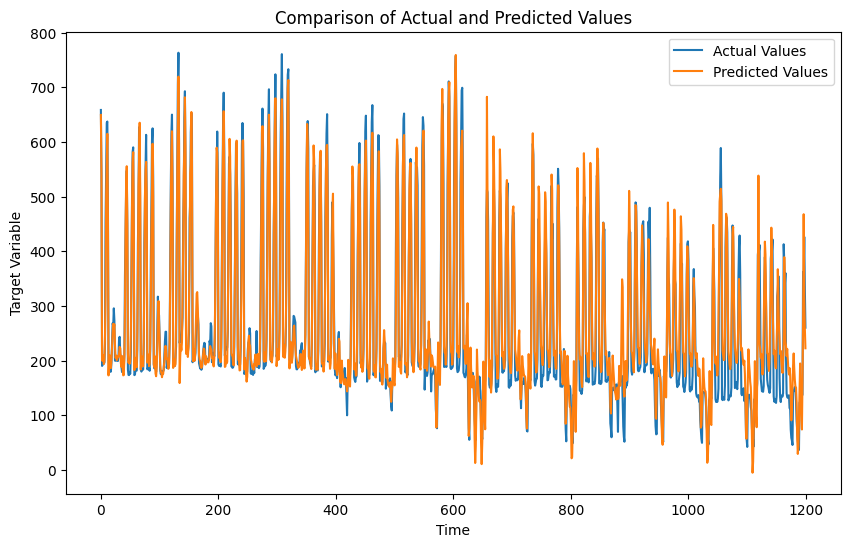

38/38 [==============================] - 1s 19ms/step


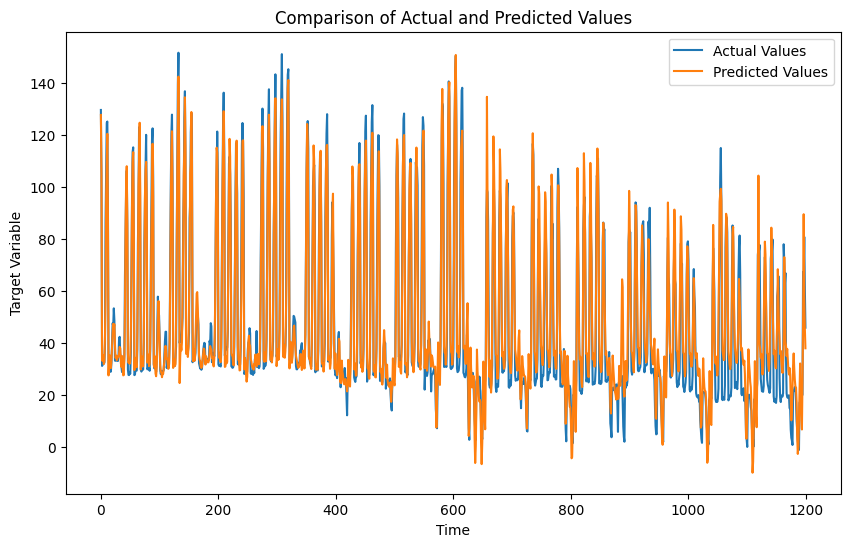

38/38 [==============================] - 1s 20ms/step


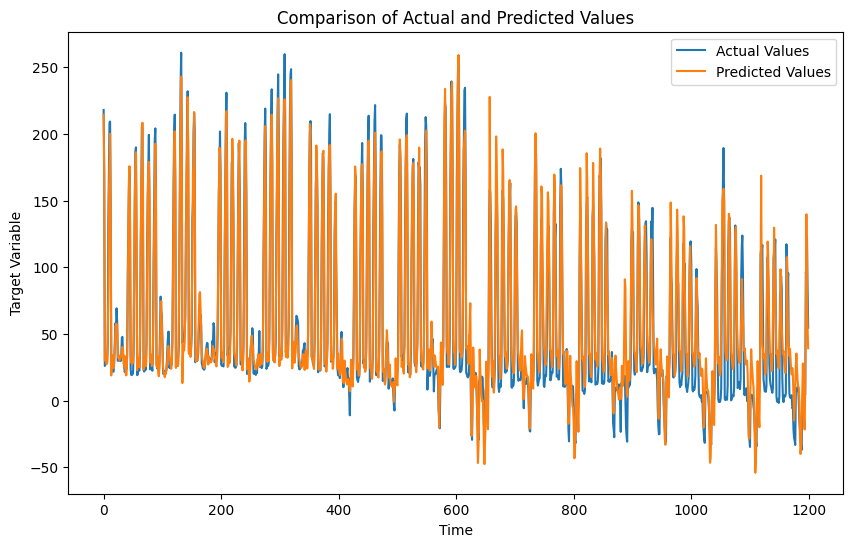

38/38 [==============================] - 1s 17ms/step


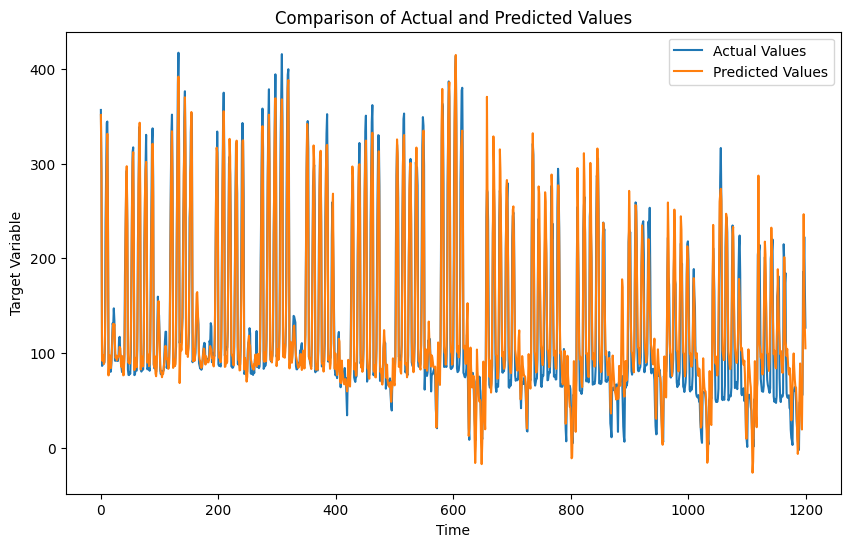

38/38 [==============================] - 1s 16ms/step


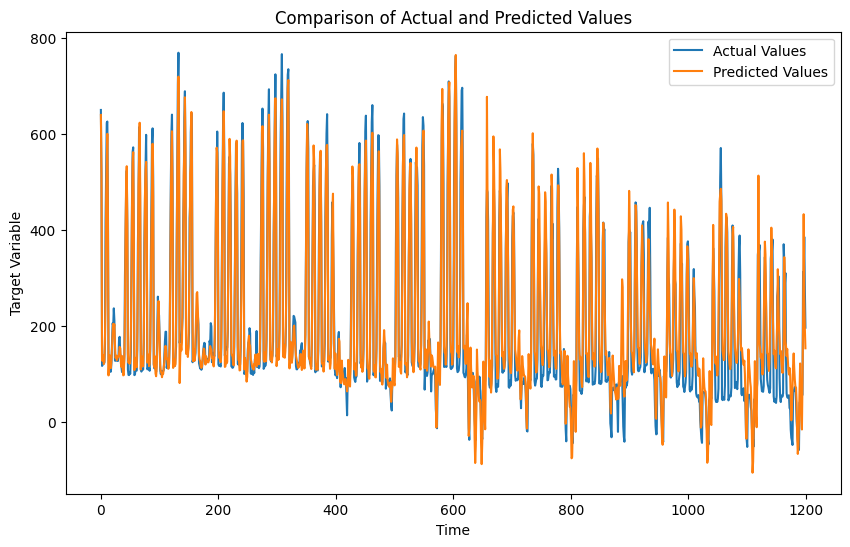

38/38 [==============================] - 1s 17ms/step


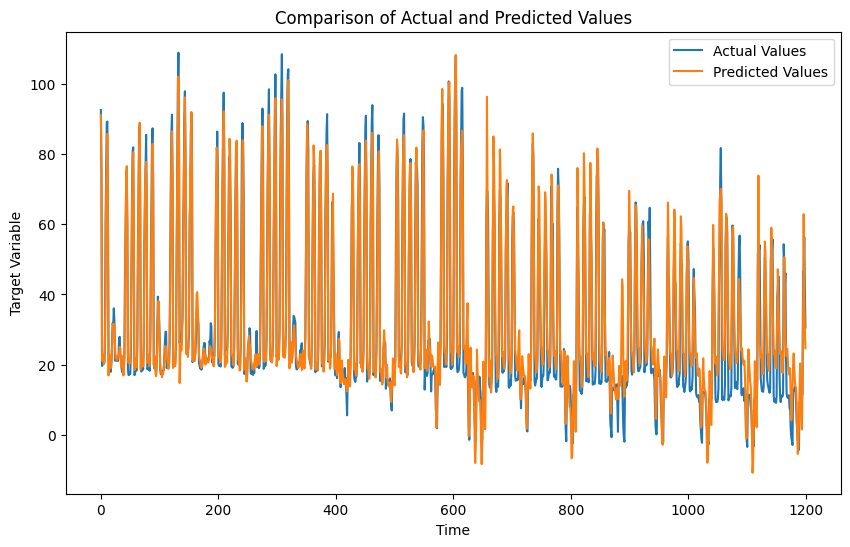

38/38 [==============================] - 1s 19ms/step


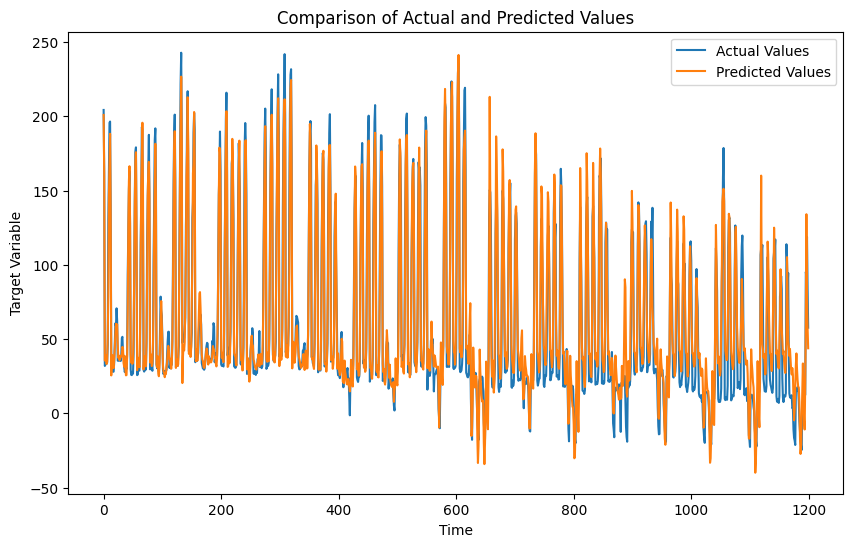

38/38 [==============================] - 1s 18ms/step


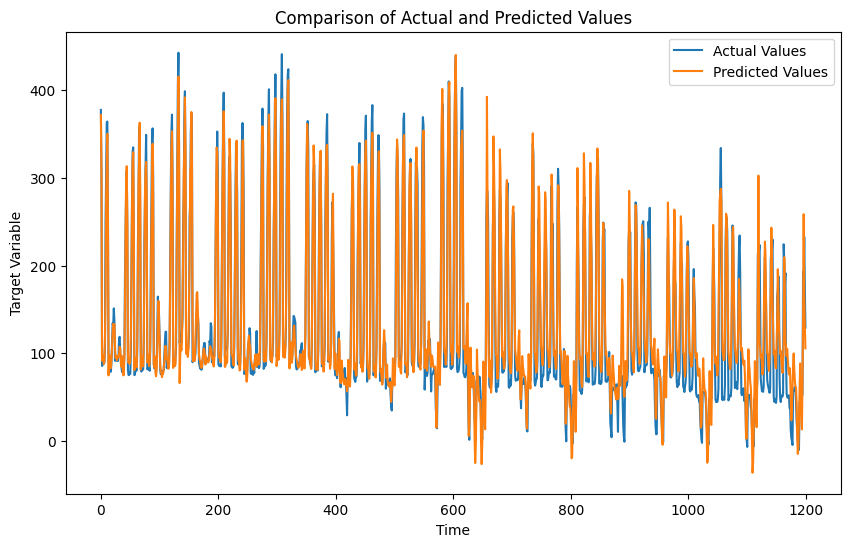

38/38 [==============================] - 1s 17ms/step


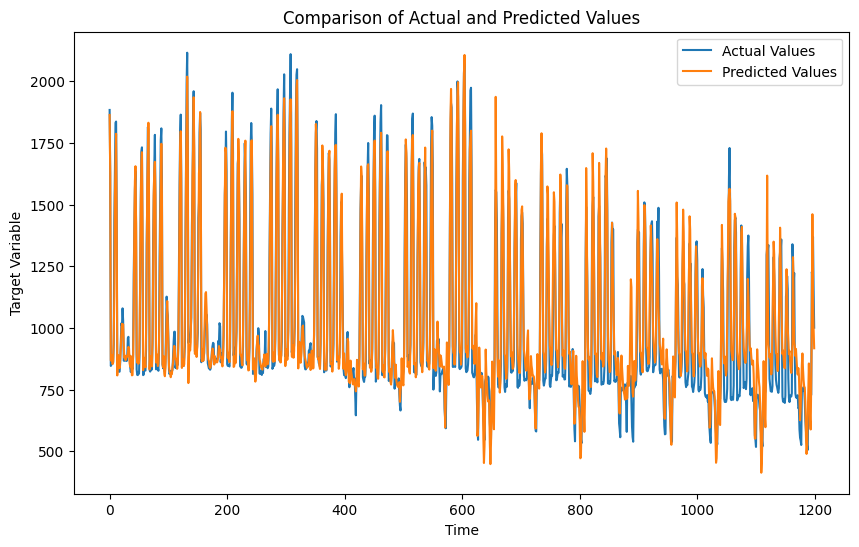

38/38 [==============================] - 1s 22ms/step


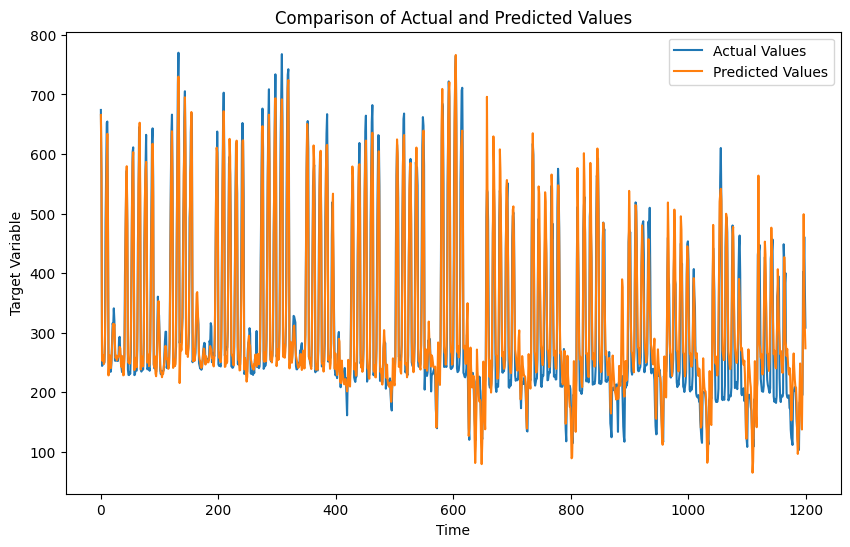

38/38 [==============================] - 1s 17ms/step


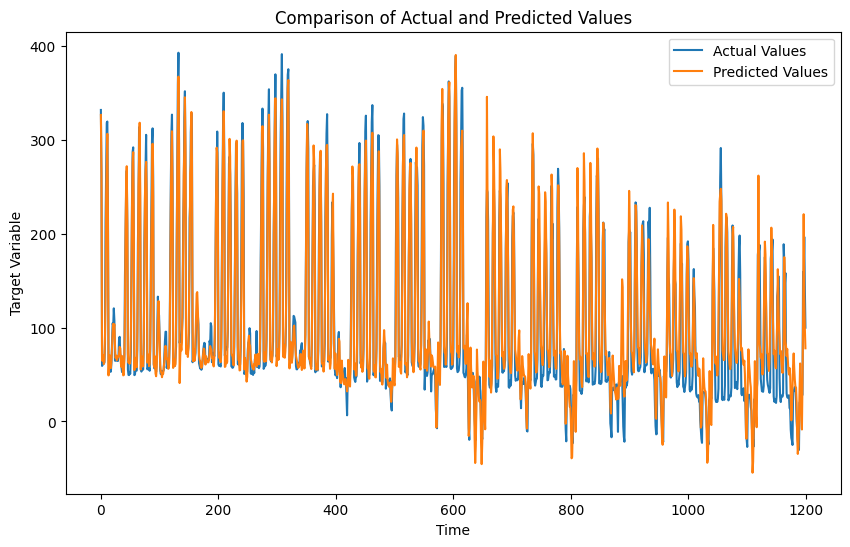

38/38 [==============================] - 1s 19ms/step


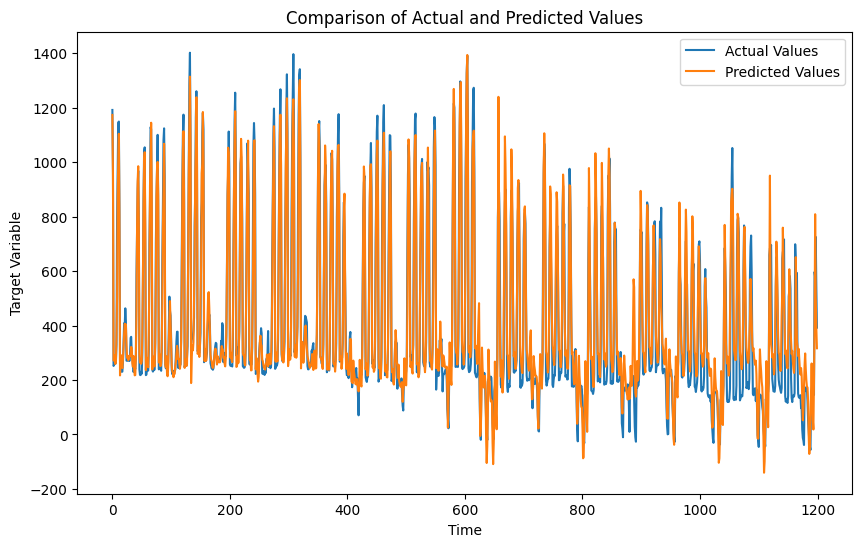

38/38 [==============================] - 1s 22ms/step


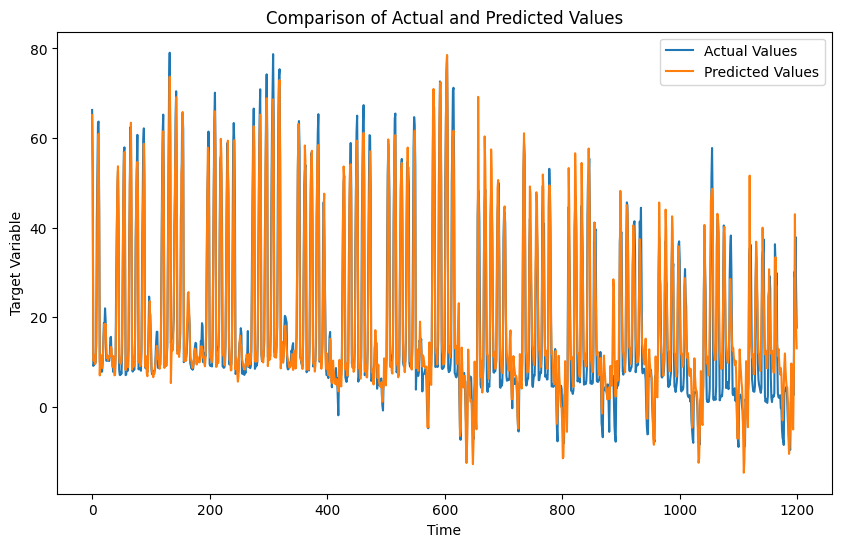

38/38 [==============================] - 1s 18ms/step


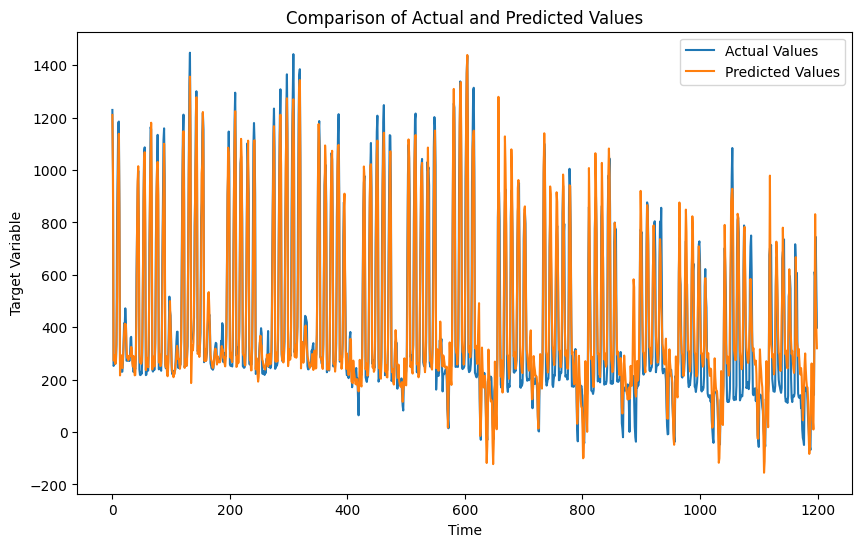

38/38 [==============================] - 1s 18ms/step


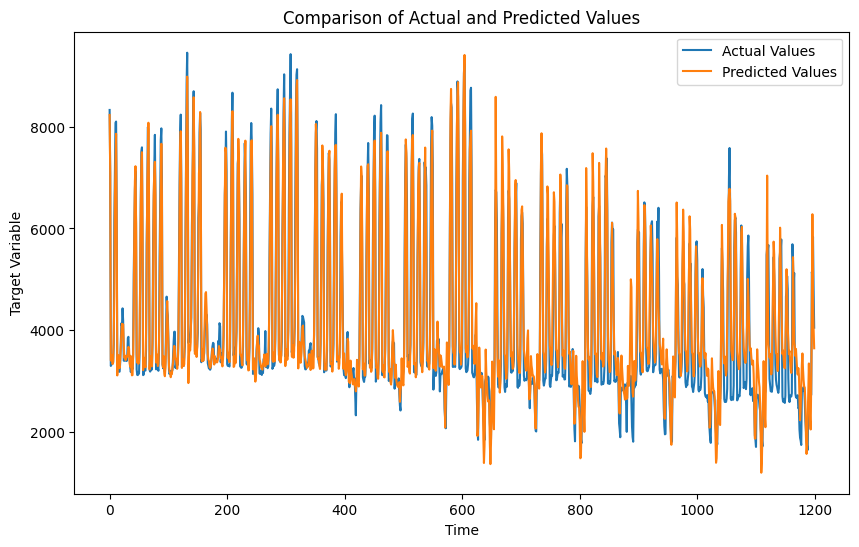

38/38 [==============================] - 1s 17ms/step


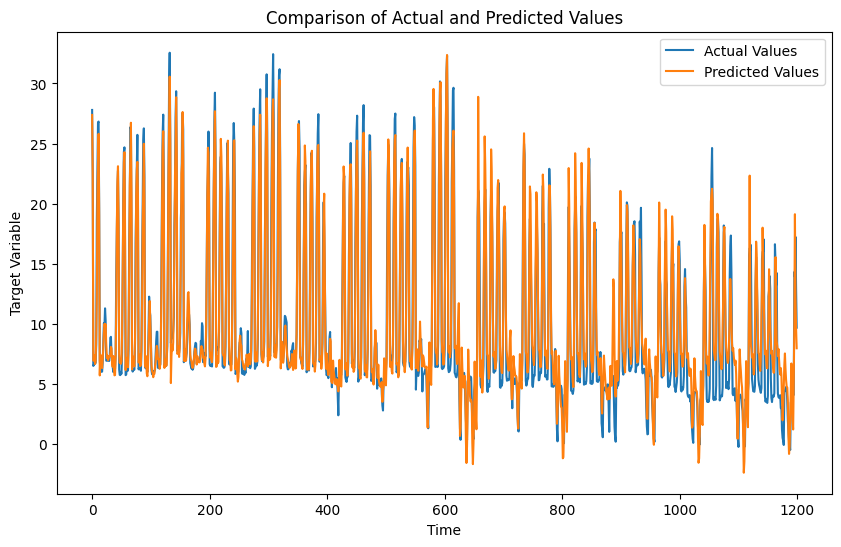

38/38 [==============================] - 1s 17ms/step


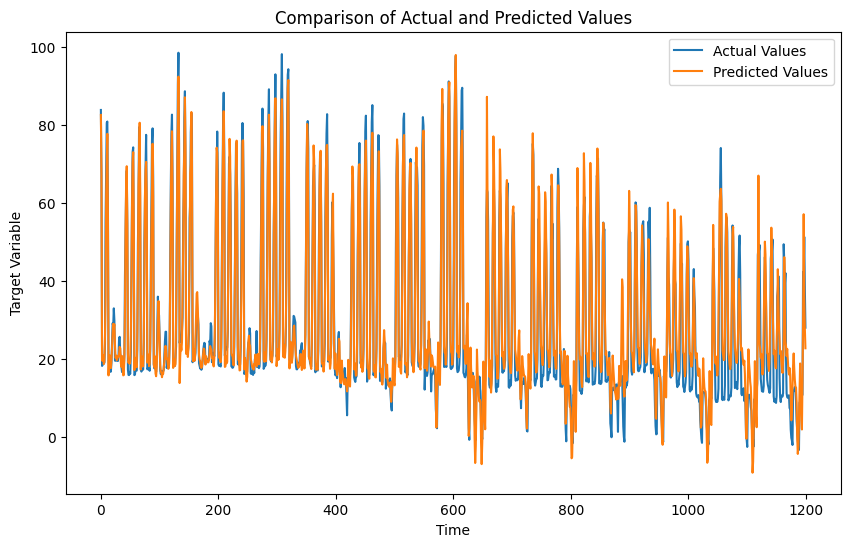

38/38 [==============================] - 1s 19ms/step


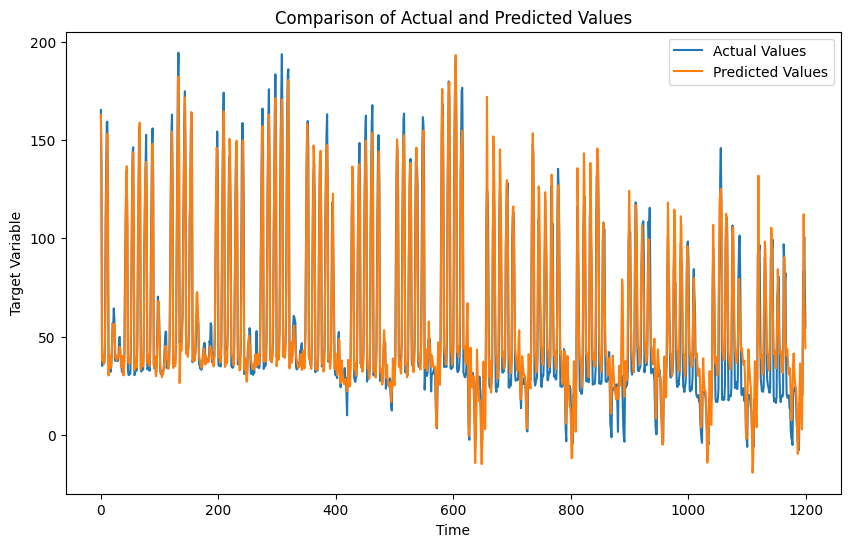

38/38 [==============================] - 1s 18ms/step


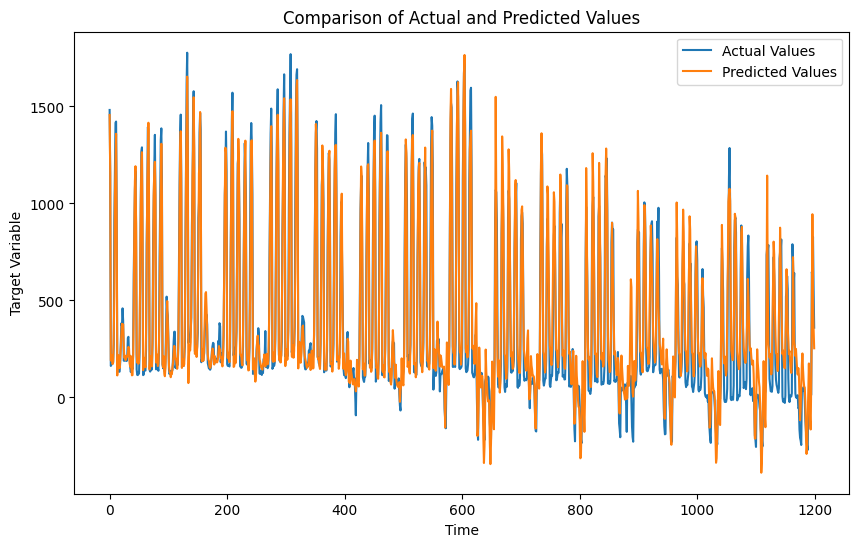

38/38 [==============================] - 1s 18ms/step


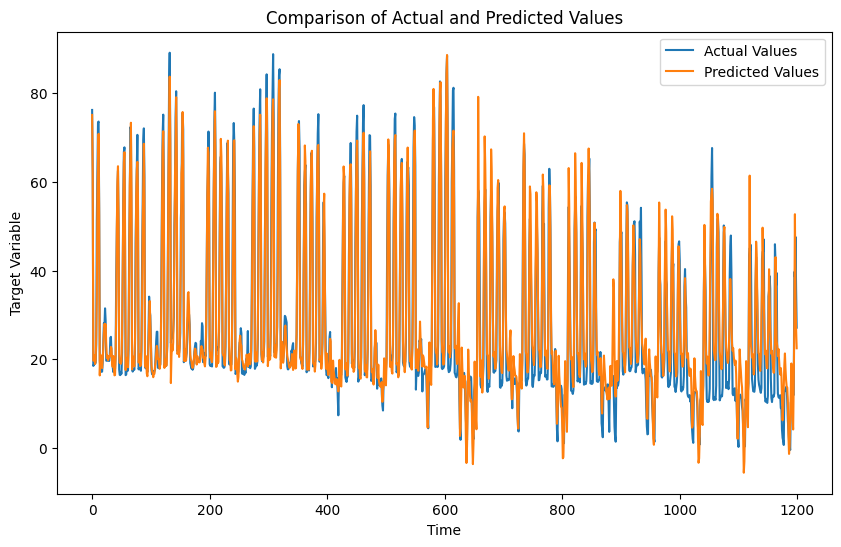

38/38 [==============================] - 1s 21ms/step


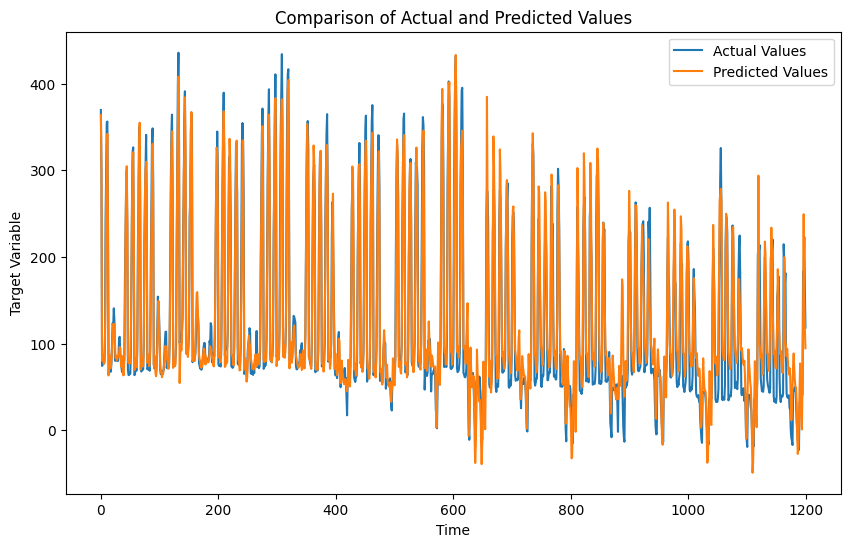

38/38 [==============================] - 1s 21ms/step


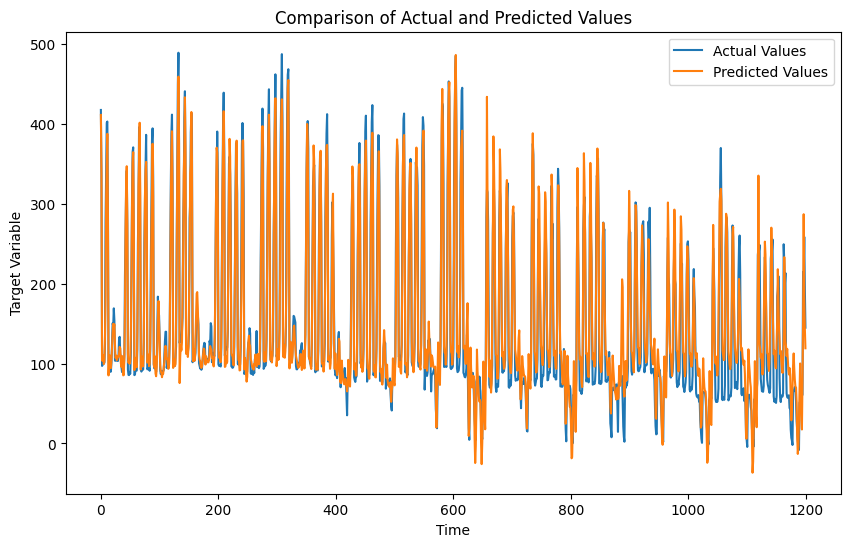

38/38 [==============================] - 1s 18ms/step


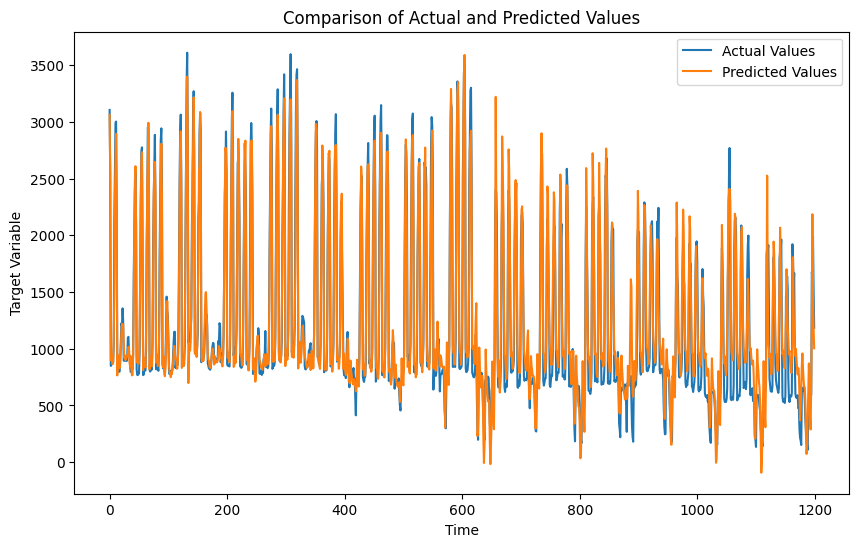

38/38 [==============================] - 1s 18ms/step


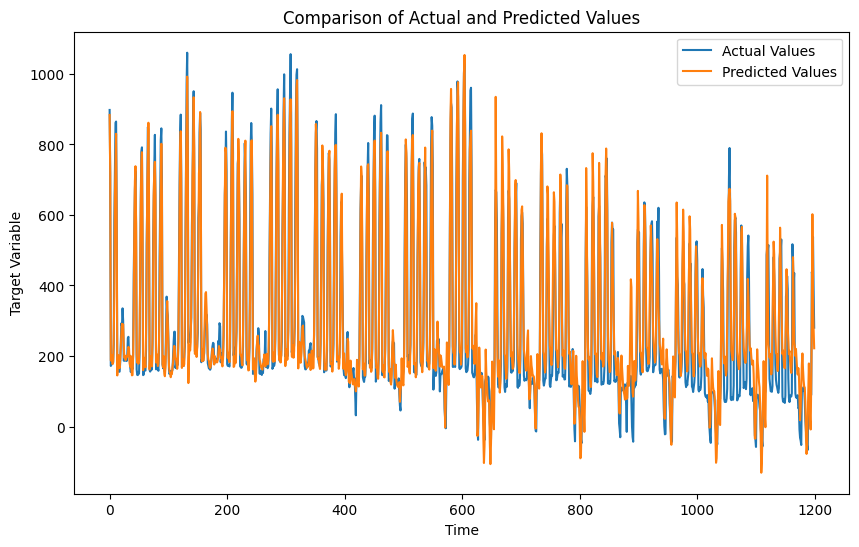

38/38 [==============================] - 1s 18ms/step


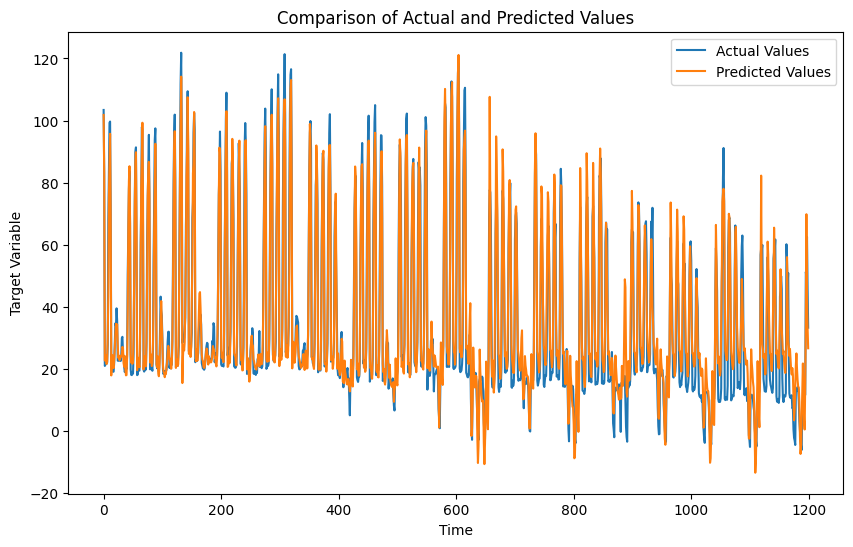

38/38 [==============================] - 1s 18ms/step


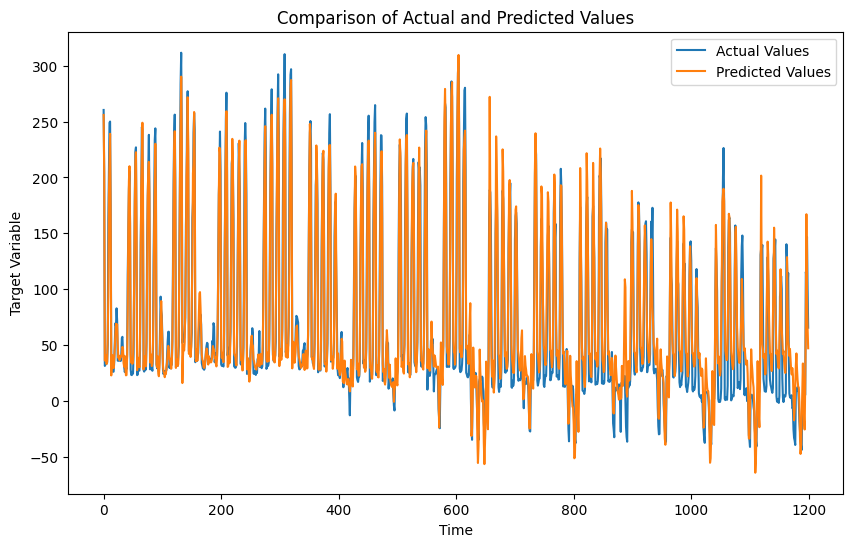

38/38 [==============================] - 1s 18ms/step


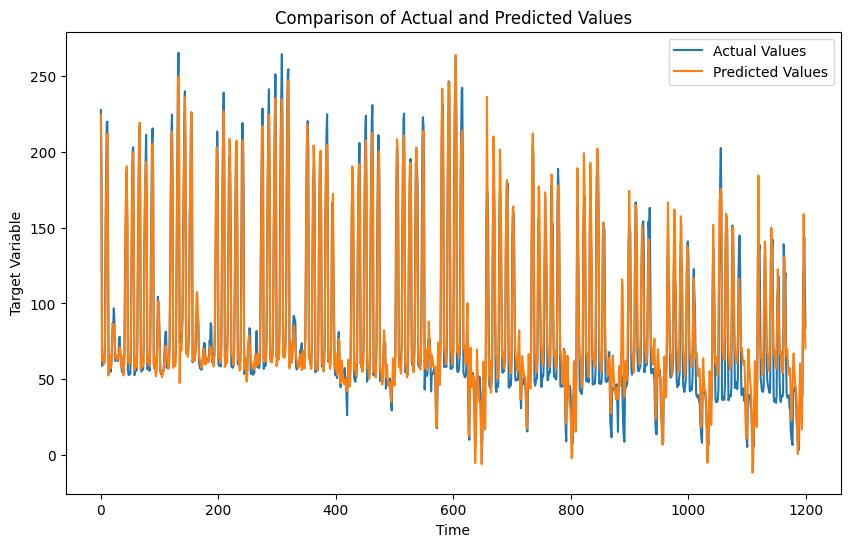

38/38 [==============================] - 1s 18ms/step


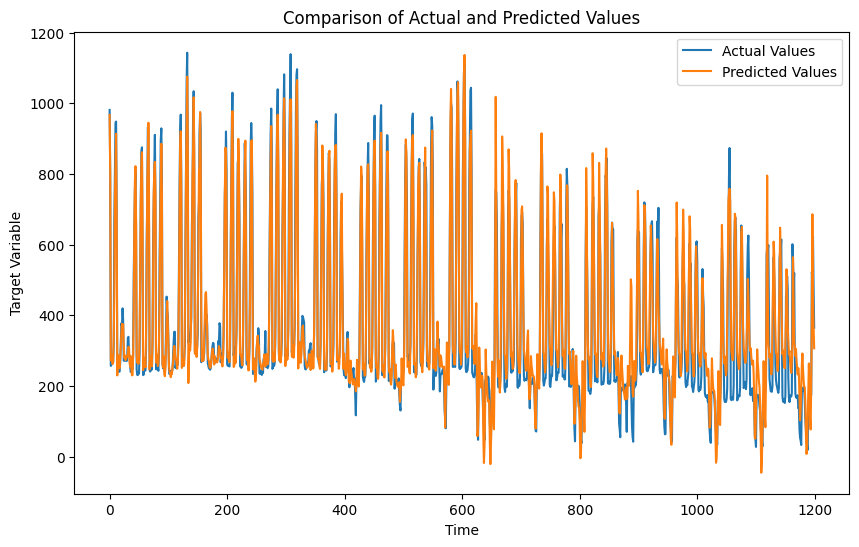

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
import matplotlib.pyplot as plt


scaled_data = pd.DataFrame()

# Keep a list to store scalers for each group for the target variable
target_scalers = []

# Iterate over each group
for name, group in grouped_data:
    # Your existing code to prepare training data...

    # Save the scaler for the target variable
    target_scaler = StandardScaler()
    target_scaler.fit(group[['target']])
    target_scalers.append(target_scaler)

    # Your existing model training code...

    # After training the model, predict on the test set or a slice of training set for demonstration
    prediction_scaled = model.predict(trainX[-n_days_for_prediction:])

    # Reverse scaling for the prediction and the actual values
    prediction = target_scaler.inverse_transform(prediction_scaled)
    actual = target_scaler.inverse_transform(trainY[-n_days_for_prediction:])

    # Plotting the real values vs predictions
    plt.figure(figsize=(10,6))
    plt.plot(actual, label='Actual Values')
    plt.plot(prediction, label='Predicted Values')
    plt.title('Comparison of Actual and Predicted Values')
    plt.xlabel('Time')
    plt.ylabel('Target Variable')
    plt.legend()
    plt.show()

# Note: This script assumes you are evaluating your predictions with the last portion of your training set.
# For a more accurate evaluation, consider creating a separate test set during your data preparation stage.


In [86]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 439422 entries, 0 to 439421
Data columns (total 29 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   Unnamed: 0              439422 non-null  int64  
 1   datetime                439422 non-null  object 
 2   product_type            439422 non-null  int64  
 3   county                  439422 non-null  int64  
 4   eic_count               439422 non-null  int64  
 5   installed_capacity      439422 non-null  float64
 6   is_business             439422 non-null  int64  
 7   target                  439422 non-null  float64
 8   temperature             439422 non-null  float64
 9   dewpoint                439422 non-null  float64
 10  rain                    439422 non-null  float64
 11  snowfall                439422 non-null  float64
 12  surface_pressure        439422 non-null  float64
 13  cloudcover_total        439422 non-null  float64
 14  windspeed_10m       

**using lgbm for production✅**

In [88]:
selected_columns = ['product_type', 'county', 'eic_count', 'installed_capacity', 'is_business', 'temperature', 'dewpoint', 'rain', 'snowfall', 'surface_pressure', 'cloudcover_total', 'windspeed_10m', 'winddirection_10m', 'shortwave_radiation', 'direct_solar_radiation', 'diffuse_radiation', 'lowest_price_per_mwh', 'highest_price_per_mwh', 'elect_prices', 'hour', 'dayofweek','target', 'quarter', 'month', 'year', 'dayofyear', 'day']

# Select only the specified columns
df = df[selected_columns]

In [94]:
def divied_data(df):

    X = df.drop(columns=['target'])
    y = df['target']

    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.05, random_state=42)
    return X_train, X_val, y_train, y_val
X_train, X_val, y_train, y_val = divied_data(df)

In [95]:
X_train

,product_type,county,eic_count,installed_capacity,is_business,temperature,dewpoint,rain,snowfall,surface_pressure,...,lowest_price_per_mwh,highest_price_per_mwh,elect_prices,hour,dayofweek,quarter,month,year,dayofyear,day
350189,1,2,12,161.50,0,1.050000,-0.275000,0.075,0.1750,977.650000,...,114.74,125.52,16.94,2,1,2,4,2022,95,5
277320,1,14,33,441.00,0,-3.000000,-13.666667,0.000,0.0000,1017.533333,...,83.02,88.70,107.16,9,6,1,3,2022,86,27
160860,3,15,46,1753.20,1,20.480000,16.500000,0.000,0.0000,1004.480000,...,191.82,216.00,207.11,1,1,3,8,2022,228,16
311409,3,2,27,649.00,1,-2.175000,-3.800000,0.000,0.0000,984.400000,...,73.40,76.00,110.04,9,0,1,2,2022,52,21
191128,3,3,39,2338.70,1,-7.133333,-8.433333,0.000,0.0000,993.200000,...,86.62,87.69,129.92,6,5,4,12,2021,338,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
259178,1,10,11,336.50,1,15.000000,11.900000,0.025,0.0000,1009.100000,...,160.00,205.00,437.79,0,3,3,7,2022,209,28
365838,3,5,73,2691.50,1,-0.250000,-0.500000,0.000,0.0525,976.025000,...,78.74,84.00,135.07,7,0,1,2,2022,38,7
131932,3,3,107,1441.63,0,2.500000,-0.666667,0.000,0.0000,1006.166667,...,44.74,49.00,96.89,8,6,1,3,2023,78,19
146867,3,0,477,19252.81,1,9.300000,5.766667,0.000,0.0000,1015.450000,...,36.00,40.15,85.60,6,0,2,5,2023,135,15


In [98]:
def create_model_lgb(model, X_train, X_val, y_train, y_val):

    model.fit(X_train, y_train)

    pred_train = model.predict(X_train)
    pred_val = model.predict(X_val)

    train_eval = evaluation_metric(y_train, pred_train)
    val_eval = evaluation_metric(y_val, pred_val)

    print("Evaluation")
    print("Train Score : %.4f" % train_eval)
    print("Test Score : %.4f" % val_eval)

    return model

In [99]:
evaluation_metric = mean_absolute_error

model = create_model_lgb(LGBMRegressor(num_leaves=512,
                          max_depth=22,
                          learning_rate=0.27,
                                       n_estimators=96,
                          random_state=42), X_train, X_val, y_train, y_val)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.059920 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4321
[LightGBM] [Info] Number of data points in the train set: 417450, number of used features: 26
[LightGBM] [Info] Start training from score 465.102547


Evaluation
Train Score : 18.0034
Test Score : 26.1768


In [100]:
X_train

,product_type,county,eic_count,installed_capacity,is_business,temperature,dewpoint,rain,snowfall,surface_pressure,...,lowest_price_per_mwh,highest_price_per_mwh,elect_prices,hour,dayofweek,quarter,month,year,dayofyear,day
350189,1,2,12,161.50,0,1.050000,-0.275000,0.075,0.1750,977.650000,...,114.74,125.52,16.94,2,1,2,4,2022,95,5
277320,1,14,33,441.00,0,-3.000000,-13.666667,0.000,0.0000,1017.533333,...,83.02,88.70,107.16,9,6,1,3,2022,86,27
160860,3,15,46,1753.20,1,20.480000,16.500000,0.000,0.0000,1004.480000,...,191.82,216.00,207.11,1,1,3,8,2022,228,16
311409,3,2,27,649.00,1,-2.175000,-3.800000,0.000,0.0000,984.400000,...,73.40,76.00,110.04,9,0,1,2,2022,52,21
191128,3,3,39,2338.70,1,-7.133333,-8.433333,0.000,0.0000,993.200000,...,86.62,87.69,129.92,6,5,4,12,2021,338,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
259178,1,10,11,336.50,1,15.000000,11.900000,0.025,0.0000,1009.100000,...,160.00,205.00,437.79,0,3,3,7,2022,209,28
365838,3,5,73,2691.50,1,-0.250000,-0.500000,0.000,0.0525,976.025000,...,78.74,84.00,135.07,7,0,1,2,2022,38,7
131932,3,3,107,1441.63,0,2.500000,-0.666667,0.000,0.0000,1006.166667,...,44.74,49.00,96.89,8,6,1,3,2023,78,19
146867,3,0,477,19252.81,1,9.300000,5.766667,0.000,0.0000,1015.450000,...,36.00,40.15,85.60,6,0,2,5,2023,135,15


In [101]:
from lightgbm import LGBMRegressor
from sklearn.model_selection import KFold
import numpy as np

def optimizer(trial, X, y, K):
    # Define the hyper-parameter combinations to be adjusted
    num_leaves = trial.suggest_categorical('num_leaves', [512])  # Grid Search
    max_depth = trial.suggest_categorical('max_depth', [22])
    learning_rate = trial.suggest_float('learning_rate', 0.25, 0.3)  # low, high range
    n_estimators = trial.suggest_int('n_estimators', 50, 100)  # low, high range

    # Specify the model, initially testing with RF can save time before using LGBM
    model = LGBMRegressor(num_leaves=num_leaves,
                          max_depth=max_depth,
                          learning_rate=learning_rate,
                          n_estimators=n_estimators,
                          random_state=42)

    # Implement K-Fold Cross Validation
    folds = KFold(n_splits=K)
    losses = []

    for train_idx, val_idx in folds.split(X, y):
        X_train, X_val = X.iloc[train_idx, :], X.iloc[val_idx, :]
        y_train, y_val = y.iloc[train_idx], y.iloc[val_idx]

        model.fit(X_train, y_train)
        preds = model.predict(X_val)
        loss = evaluation_metric(y_val, preds)  # Assuming evaluation_metric is defined elsewhere
        losses.append(loss)

    # Return the average loss across all K-Folds
    return np.mean(losses)


In [59]:
from lightgbm import  LGBMRegressor
from sklearn.metrics import r2_score
from xgboost import XGBRegressor
from catboost import CatBoostRegressor
from sklearn.ensemble import VotingRegressor
from sklearn.ensemble import HistGradientBoostingRegressor,ExtraTreesRegressor,RandomForestRegressor,BaggingRegressor

In [92]:

train_size = int(len(df) * 0.8)
train = df[:train_size]
test = df[train_size:]

In [78]:
features=['county','is_business','product_type']
X=train[features].values
y=train['target'].values
xtrain,xtest,ytrain,ytest=train_test_split(X,y,test_size=0.2,random_state=42)


def MAE(y_true,y_pred):
    return np.mean(abs(y_true-y_pred))
lgbm=LGBMRegressor()
lgbm.fit(xtrain,ytrain)
y_pred=lgbm.predict(xtest)
print(f"train_pred:{MAE(ytest,y_pred)}")
print(f"train_r2:{r2_score(ytest,y_pred)}")

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002276 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 21
[LightGBM] [Info] Number of data points in the train set: 281229, number of used features: 3
[LightGBM] [Info] Start training from score 464.788955
train_pred:163.52852290360676
train_r2:0.8786042500622288


In [103]:

X=X_train
y=y_train
xtrain,xtest,ytrain,ytest=train_test_split(X,y,test_size=0.2,random_state=42)


def MAE(y_true,y_pred):
    return np.mean(abs(y_true-y_pred))
lgbm1=LGBMRegressor()
lgbm1.fit(xtrain,ytrain)
y_pred=lgbm1.predict(xtest)
print(f"train_pred:{MAE(ytest,y_pred)}")
print(f"train_r2:{r2_score(ytest,y_pred)}")

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.192097 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4324
[LightGBM] [Info] Number of data points in the train set: 333960, number of used features: 26
[LightGBM] [Info] Start training from score 466.388507
train_pred:60.58042718253019
train_r2:0.9879170521054509


In [104]:
def MAE(y_true,y_pred):
    return np.mean(abs(y_true-y_pred))
xgbr=XGBRegressor()
xgbr.fit(xtrain,ytrain)
y_pred=xgbr.predict(xtest)
print(f"train_pred:{MAE(ytest,y_pred)}")
print(f"train_r2:{r2_score(ytest,y_pred)}")

train_pred:47.378964614749286
train_r2:0.9917245322624022


In [87]:
df = data.sample(frac=1).reset_index(drop=True)

In [105]:
test

,product_type,county,eic_count,installed_capacity,is_business,temperature,dewpoint,rain,snowfall,surface_pressure,...,highest_price_per_mwh,elect_prices,hour,dayofweek,target,quarter,month,year,dayofyear,day
351537,3,9,36,994.08,1,2.200000,1.433333,0.0,0.0000,1013.600,...,133.00,168.00,8,0,800.482,4,10,2022,304,31
351538,3,7,167,2054.38,0,1.660000,-1.400000,0.0,0.0000,994.600,...,133.84,87.60,9,0,131.037,2,4,2022,94,4
351539,3,4,69,1002.00,0,-7.366667,-8.733333,0.0,0.0000,1026.000,...,146.97,452.34,9,5,125.474,4,12,2022,337,3
351540,3,1,60,583.90,0,17.400000,14.700000,0.0,0.0000,1023.500,...,204.10,123.80,4,3,33.550,3,8,2022,223,11
351541,1,8,17,551.50,0,11.000000,10.400000,0.0,0.0000,1006.600,...,122.00,90.41,2,5,13.446,4,10,2022,302,29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
439417,1,0,49,1543.50,1,3.050000,-0.450000,0.0,0.0000,1013.950,...,67.79,45.25,1,1,666.196,4,10,2021,292,19
439418,1,11,89,923.90,0,-2.200000,-3.450000,0.0,0.0525,1002.275,...,110.00,143.15,5,0,127.845,1,3,2022,66,7
439419,1,14,39,413.50,0,2.566667,2.366667,0.0,0.0000,1023.100,...,108.00,124.30,2,0,30.648,4,11,2022,318,14
439420,3,8,80,949.47,0,5.000000,3.500000,0.0,0.0000,1011.700,...,115.00,9.17,2,0,65.205,4,11,2022,311,7


C:\Users\Ghada\AppData\Local\Temp\ipykernel_26172\2547421492.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['predicted'] = xgbr.predict(X_test)
C:\Users\Ghada\AppData\Local\Temp\ipykernel_26172\2547421492.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['datetime'] = pd.to_datetime(test[['year', 'month', 'day', 'hour']])


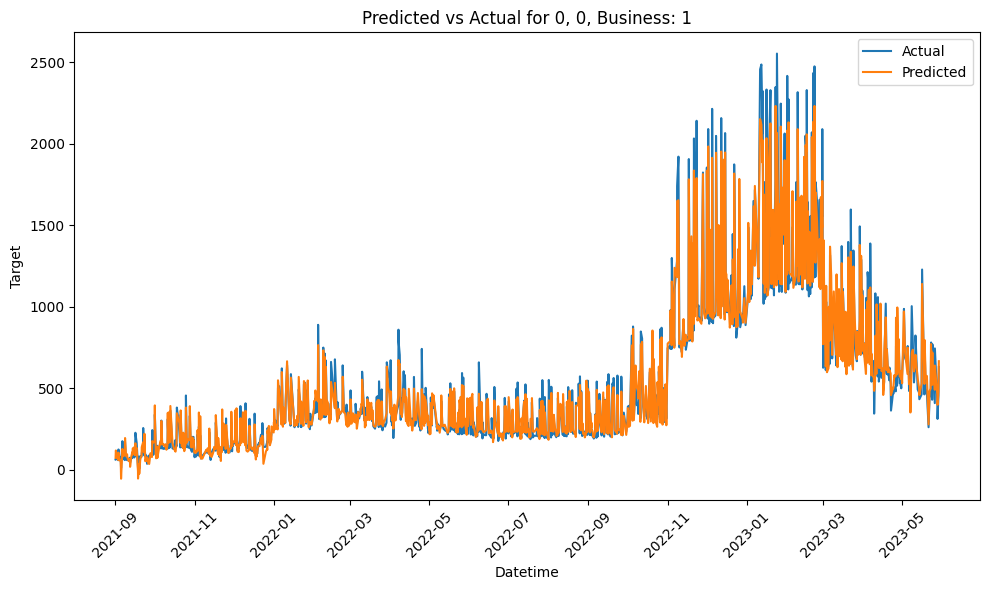

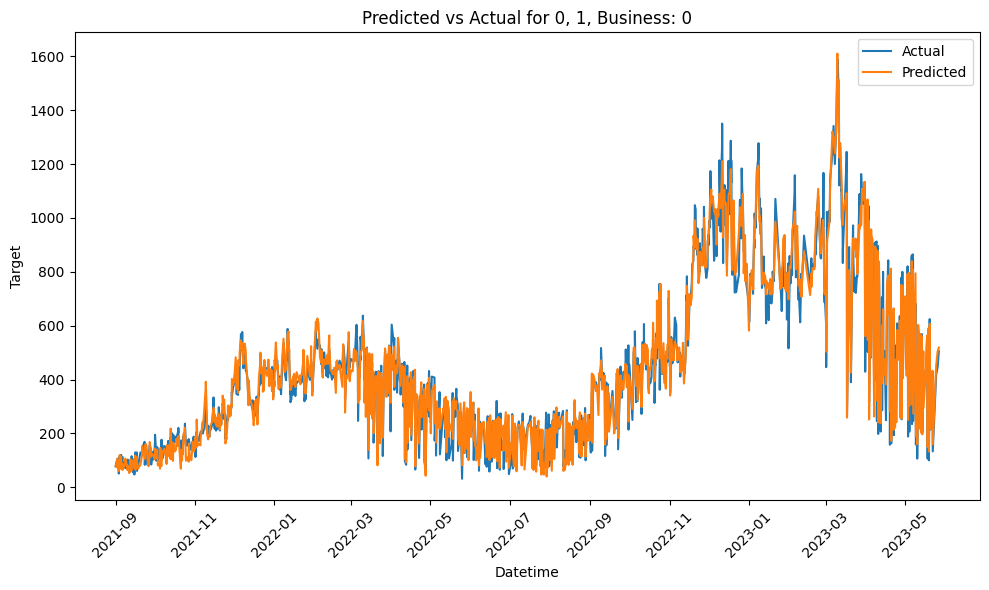

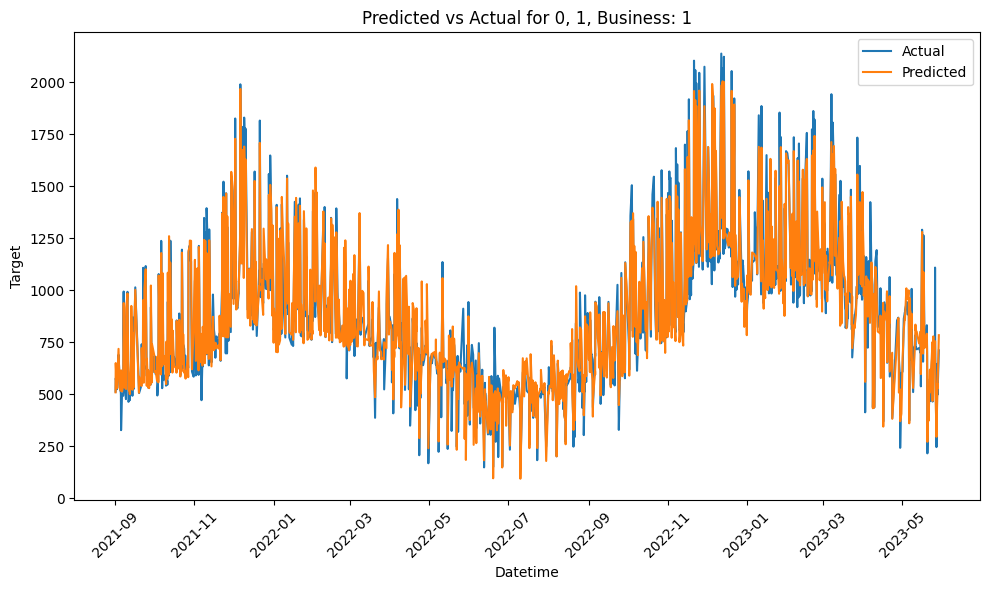

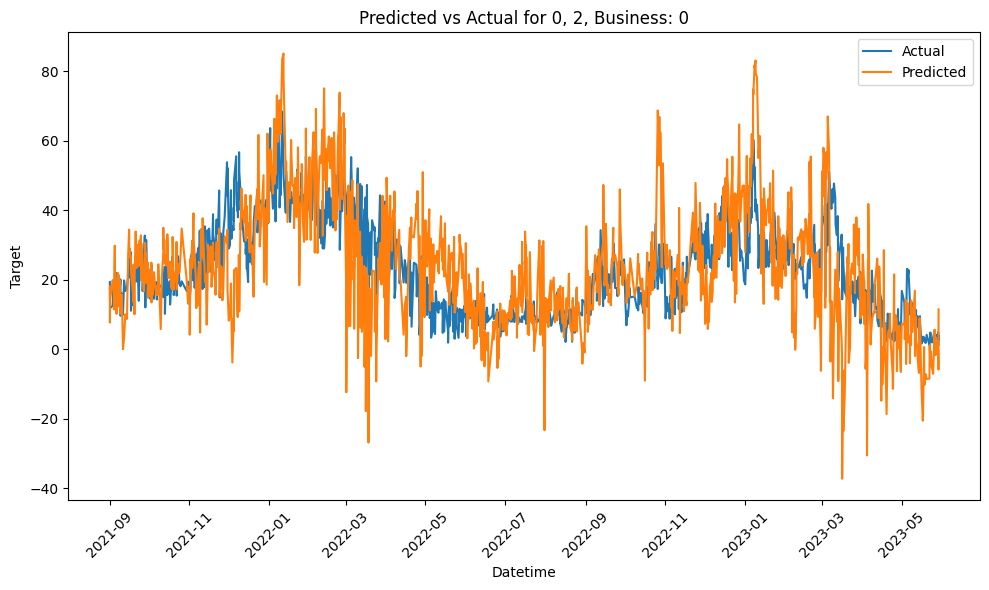

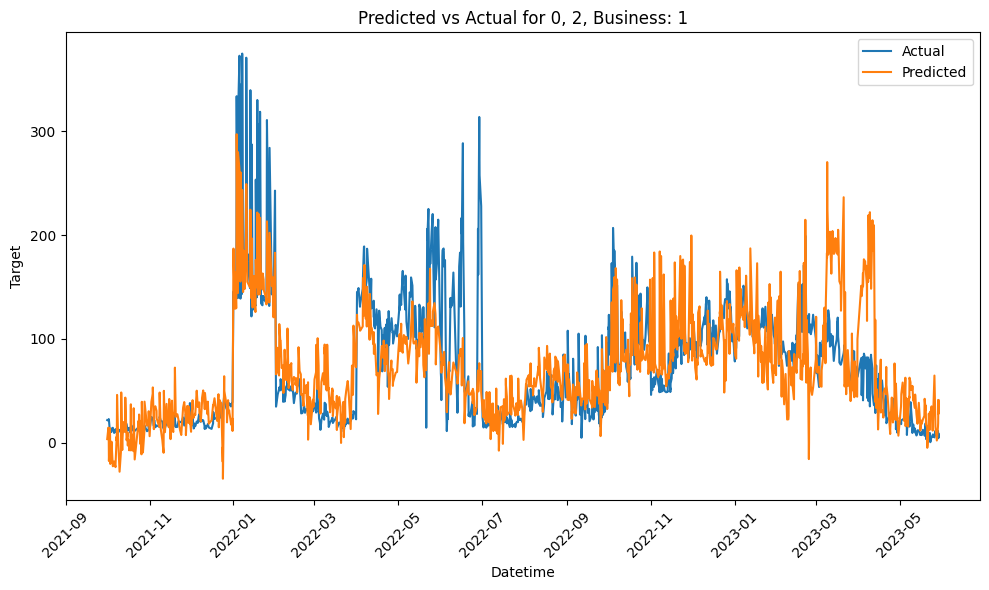

...

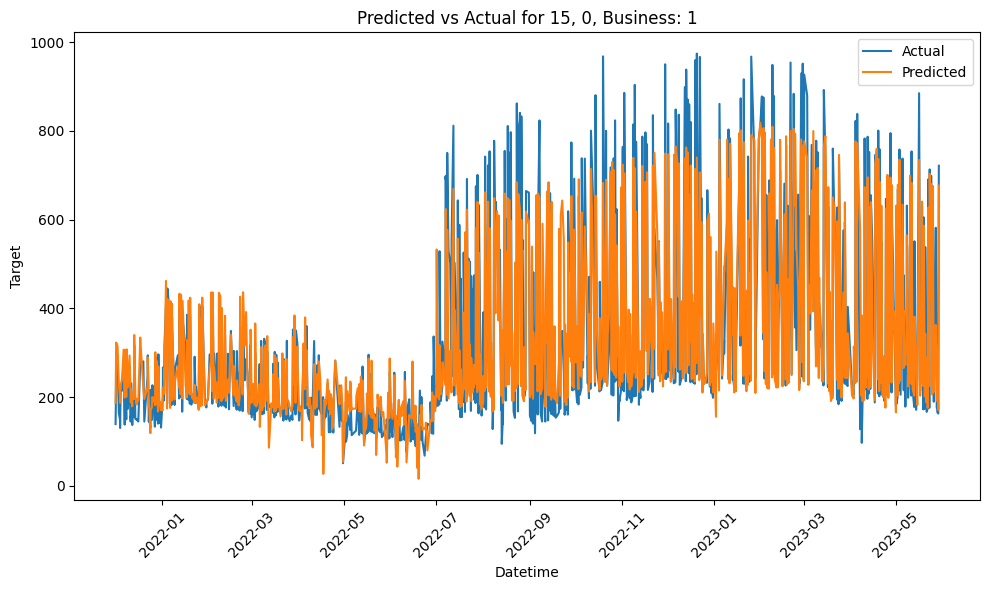

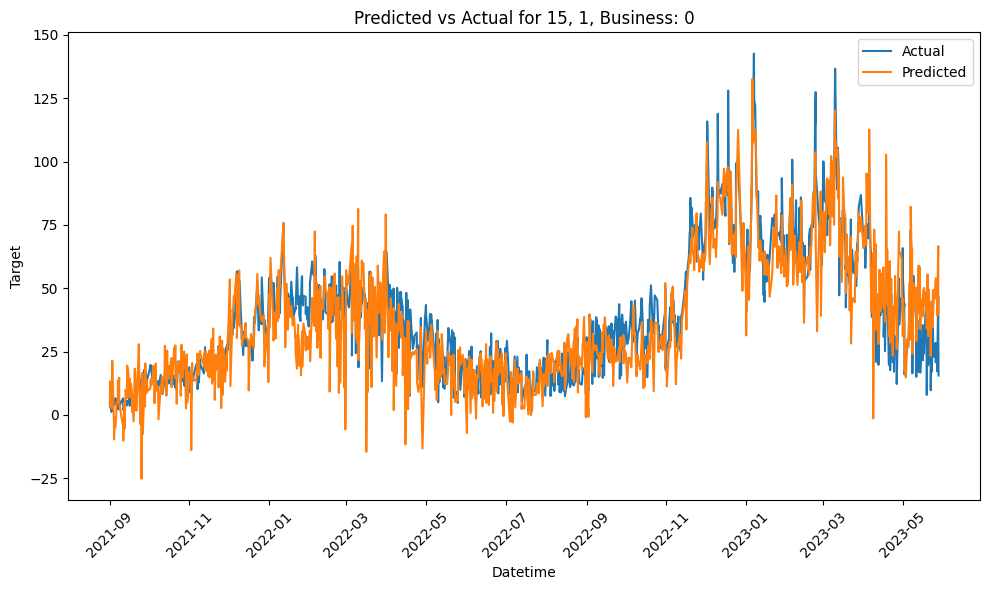

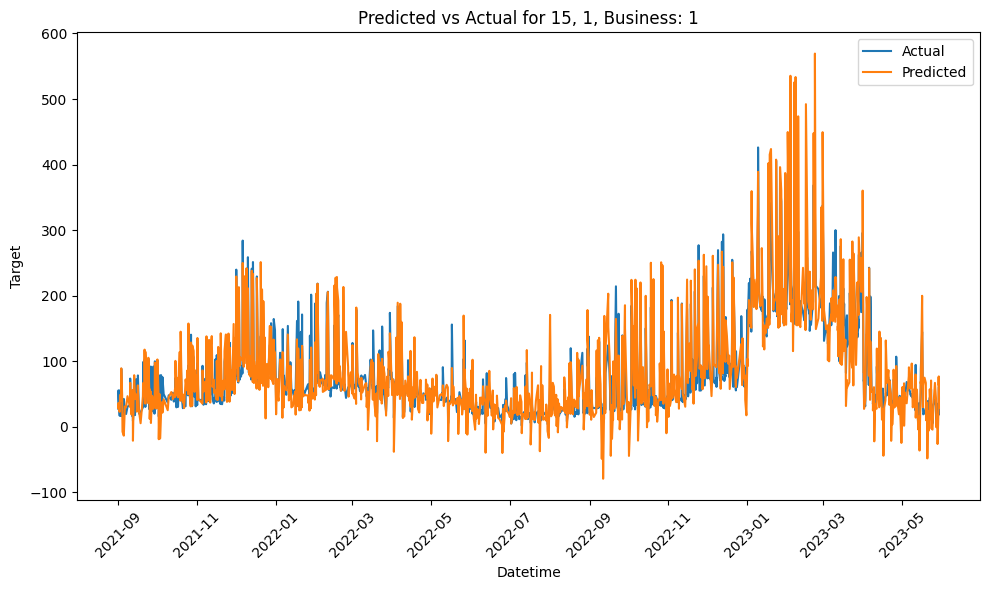

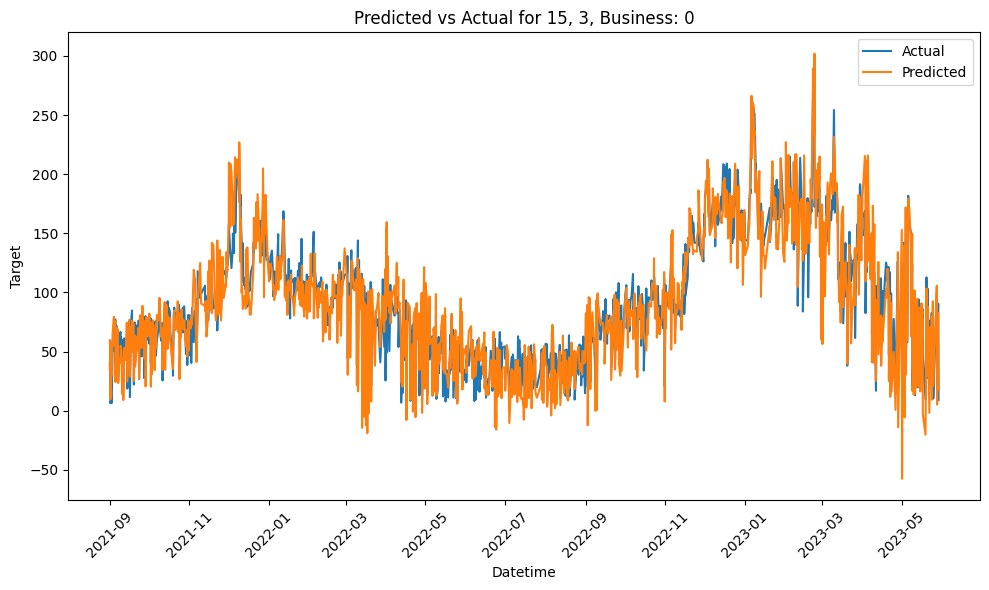

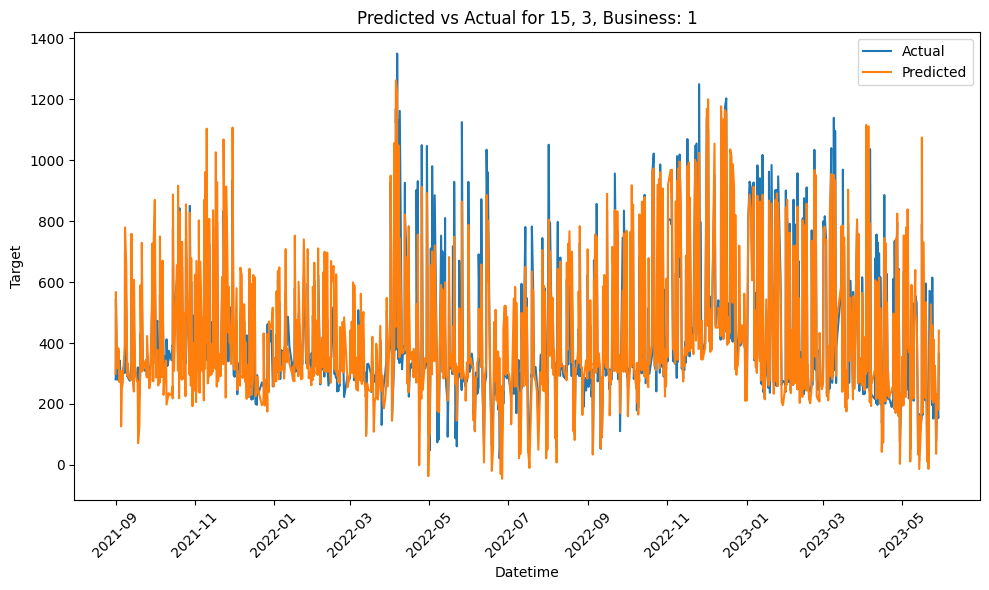

In [106]:


# Predict for the entire test dataset
X_test = test.drop(columns=['target'])
test['predicted'] = xgbr.predict(X_test)

# Now, for plotting predicted vs actual for each group
groups = test.groupby(['county', 'product_type', 'is_business'])
test['datetime'] = pd.to_datetime(test[['year', 'month', 'day', 'hour']])
for (county, product_type, is_business), group in groups:
    # Sort the group by datetime for plotting
    group = group.sort_values('datetime')

    plt.figure(figsize=(10, 6))
    plt.plot(group['datetime'], group['target'], label='Actual')
    plt.plot(group['datetime'], group['predicted'], label='Predicted')

    plt.title(f'Predicted vs Actual for {county}, {product_type}, Business: {is_business}')
    plt.xlabel('Datetime')
    plt.ylabel('Target')
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

In [69]:
selected_columns = ['product_type', 'county', 'eic_count', 'installed_capacity', 'is_business', 'temperature', 'dewpoint', 'rain', 'snowfall', 'surface_pressure', 'cloudcover_total', 'windspeed_10m', 'winddirection_10m', 'shortwave_radiation', 'direct_solar_radiation', 'diffuse_radiation', 'lowest_price_per_mwh', 'highest_price_per_mwh', 'elect_prices', 'hour', 'dayofweek','target', 'quarter', 'month', 'year', 'dayofyear', 'day']

# Select only the specified columns
test1 = test[selected_columns]

In [83]:
X_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87885 entries, 351537 to 439421
Data columns (total 28 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   product_type            87885 non-null  int64         
 1   county                  87885 non-null  int64         
 2   eic_count               87885 non-null  int64         
 3   installed_capacity      87885 non-null  float64       
 4   is_business             87885 non-null  int64         
 5   temperature             87885 non-null  float64       
 6   dewpoint                87885 non-null  float64       
 7   rain                    87885 non-null  float64       
 8   snowfall                87885 non-null  float64       
 9   surface_pressure        87885 non-null  float64       
 10  cloudcover_total        87885 non-null  float64       
 11  windspeed_10m           87885 non-null  float64       
 12  winddirection_10m       87885 non-null  

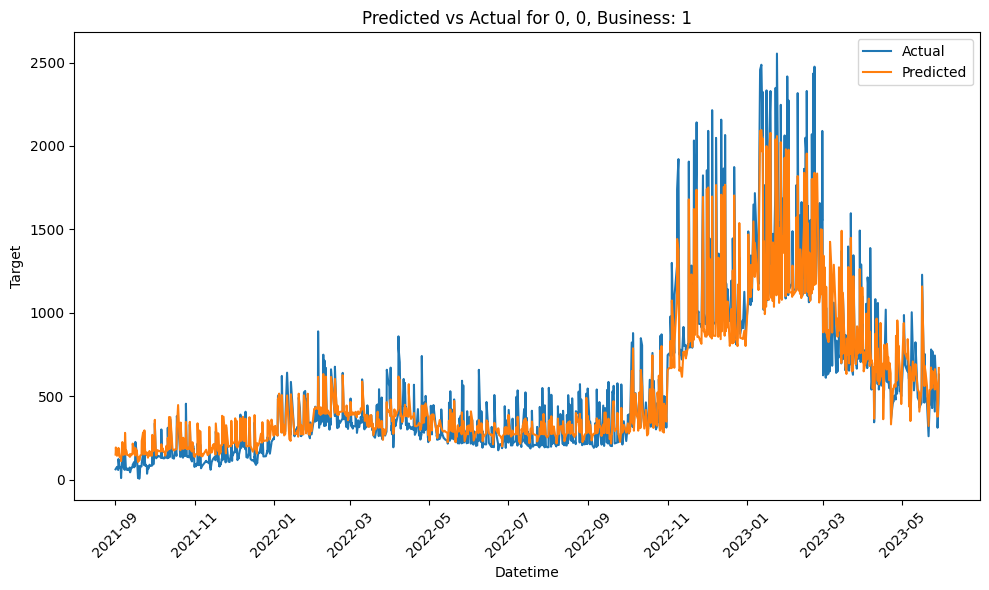

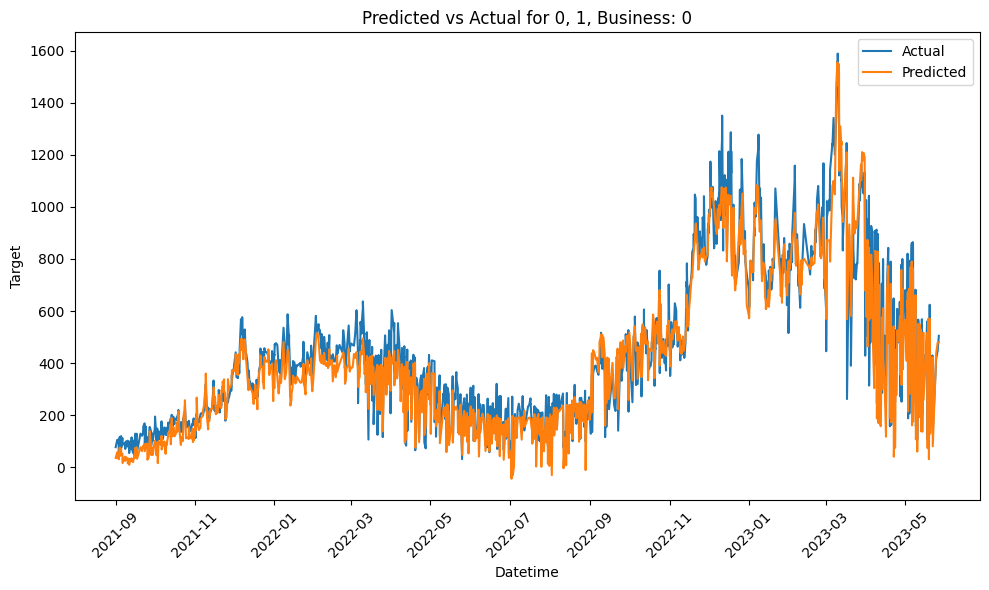

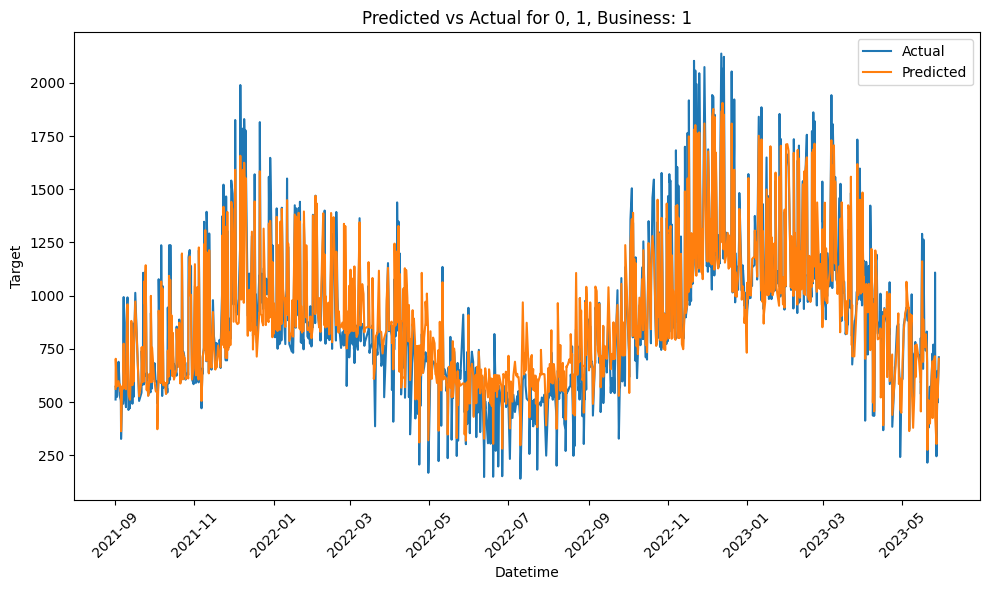

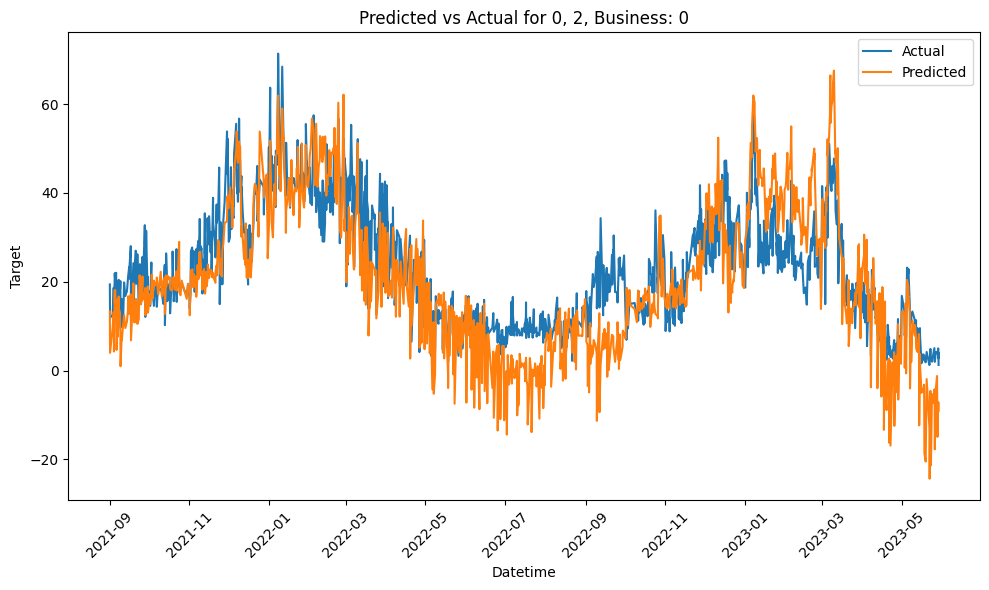

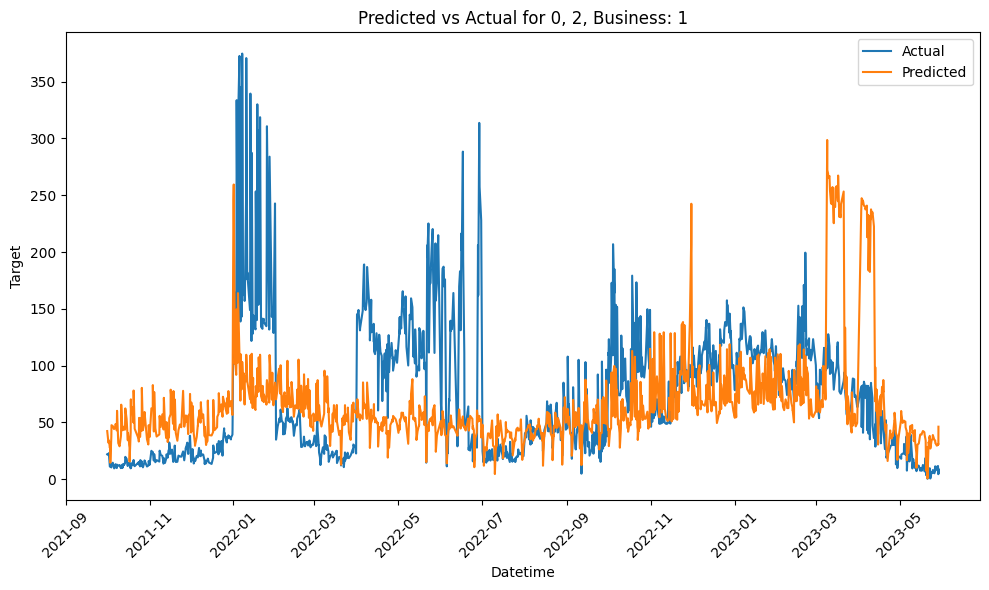

...

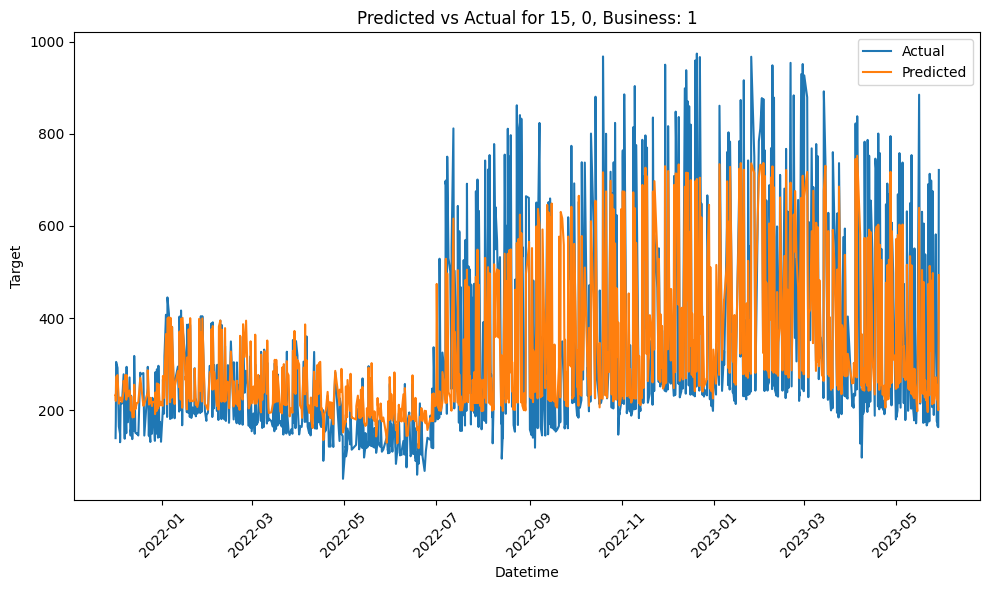

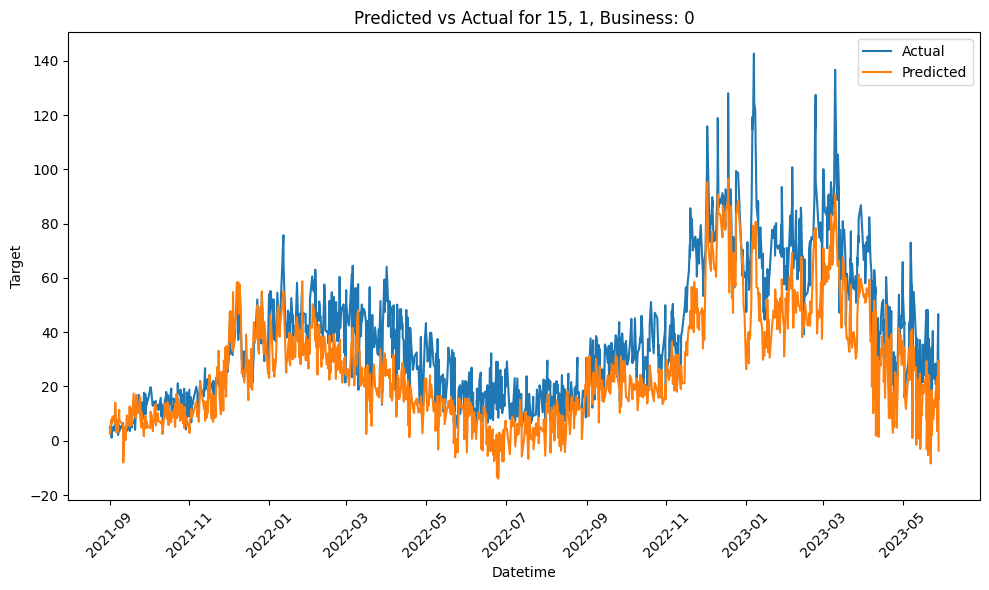

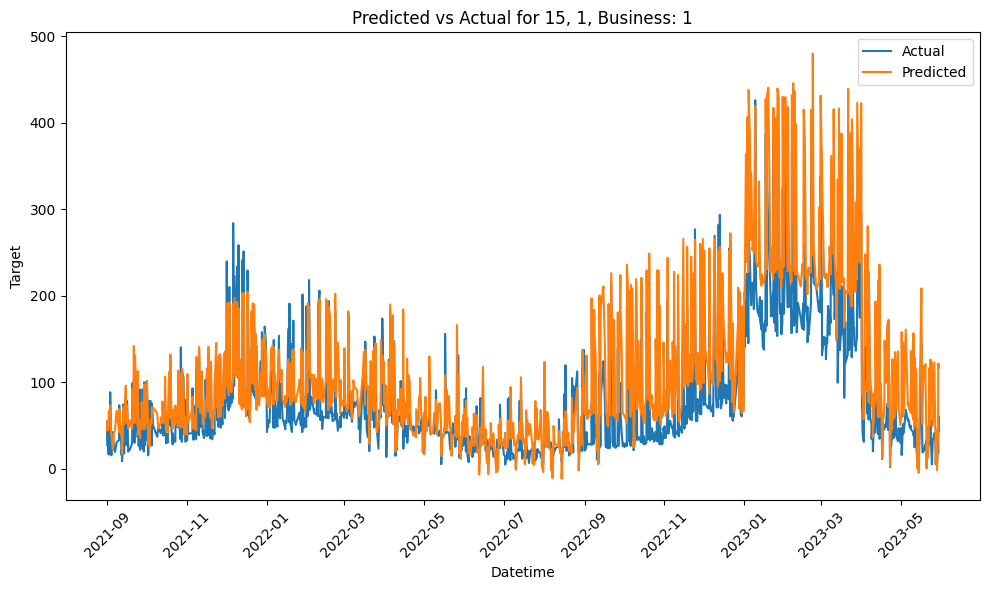

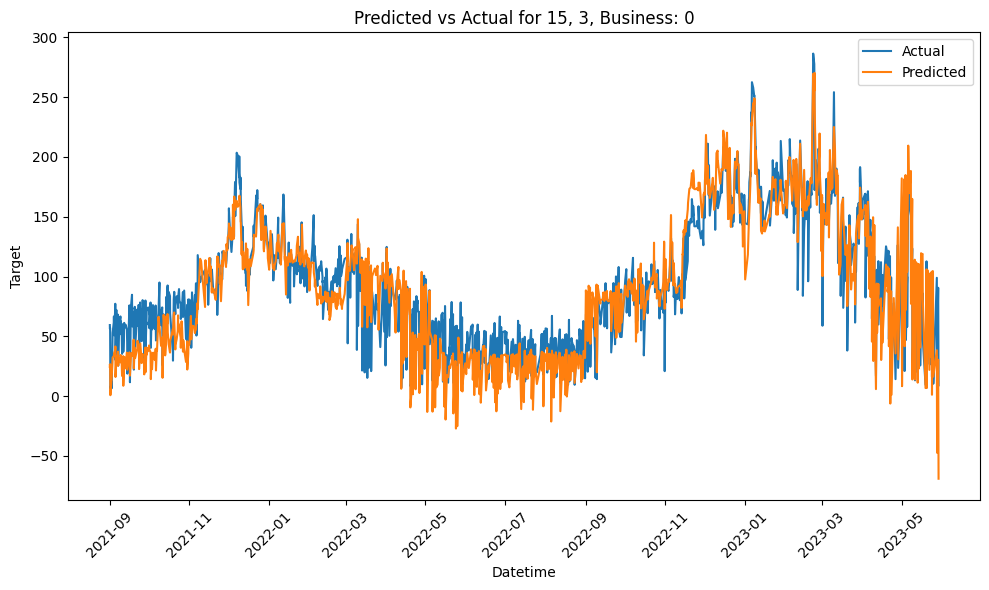

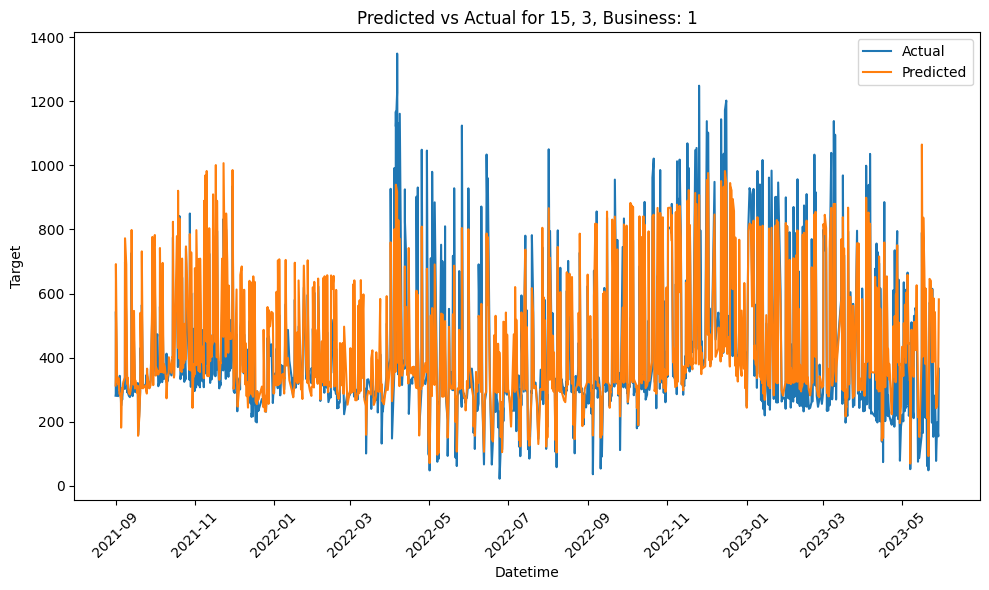

In [117]:

# Predict for the entire test dataset
X_test1 = test.drop(columns=['target'])
test['predicted'] = lgbm1.predict(X_test1)

# Now, for plotting predicted vs actual for each group
groups = test.groupby(['county', 'product_type', 'is_business'])
test['datetime'] = pd.to_datetime(test[['year', 'month', 'day', 'hour']])
for (county, product_type, is_business), group in groups:
    # Sort the group by datetime for plotting
    group = group.sort_values('datetime')

    plt.figure(figsize=(10, 6))
    plt.plot(group['datetime'], group['target'], label='Actual')
    plt.plot(group['datetime'], group['predicted'], label='Predicted')

    plt.title(f'Predicted vs Actual for {county}, {product_type}, Business: {is_business}')
    plt.xlabel('Datetime')
    plt.ylabel('Target')
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

In [110]:
test

,product_type,county,eic_count,installed_capacity,is_business,temperature,dewpoint,rain,snowfall,surface_pressure,...,hour,dayofweek,target,quarter,month,year,dayofyear,day,predicted,datetime
351537,3,9,36,994.08,1,2.200000,1.433333,0.0,0.0000,1013.600,...,8,0,800.482,4,10,2022,304,31,688.164856,2022-10-31 08:00:00
351538,3,7,167,2054.38,0,1.660000,-1.400000,0.0,0.0000,994.600,...,9,0,131.037,2,4,2022,94,4,172.678299,2022-04-04 09:00:00
351539,3,4,69,1002.00,0,-7.366667,-8.733333,0.0,0.0000,1026.000,...,9,5,125.474,4,12,2022,337,3,150.983658,2022-12-03 09:00:00
351540,3,1,60,583.90,0,17.400000,14.700000,0.0,0.0000,1023.500,...,4,3,33.550,3,8,2022,223,11,23.892078,2022-08-11 04:00:00
351541,1,8,17,551.50,0,11.000000,10.400000,0.0,0.0000,1006.600,...,2,5,13.446,4,10,2022,302,29,16.081469,2022-10-29 02:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
439417,1,0,49,1543.50,1,3.050000,-0.450000,0.0,0.0000,1013.950,...,1,1,666.196,4,10,2021,292,19,621.025391,2021-10-19 01:00:00
439418,1,11,89,923.90,0,-2.200000,-3.450000,0.0,0.0525,1002.275,...,5,0,127.845,1,3,2022,66,7,127.568634,2022-03-07 05:00:00
439419,1,14,39,413.50,0,2.566667,2.366667,0.0,0.0000,1023.100,...,2,0,30.648,4,11,2022,318,14,31.653688,2022-11-14 02:00:00
439420,3,8,80,949.47,0,5.000000,3.500000,0.0,0.0000,1011.700,...,2,0,65.205,4,11,2022,311,7,48.405319,2022-11-07 02:00:00


In [116]:
selected_columns = ['product_type', 'county', 'eic_count', 'installed_capacity', 'is_business', 'temperature', 'dewpoint', 'rain', 'snowfall', 'surface_pressure', 'cloudcover_total', 'windspeed_10m', 'winddirection_10m', 'shortwave_radiation', 'direct_solar_radiation', 'diffuse_radiation', 'lowest_price_per_mwh', 'highest_price_per_mwh', 'elect_prices', 'hour', 'dayofweek','target', 'quarter', 'month', 'year', 'dayofyear', 'day']

# Select only the specified columns
test = test[selected_columns]

In [113]:
test

,product_type,county,eic_count,installed_capacity,is_business,temperature,dewpoint,rain,snowfall,surface_pressure,...,highest_price_per_mwh,elect_prices,hour,dayofweek,target,quarter,month,year,dayofyear,day
351537,3,9,36,994.08,1,2.200000,1.433333,0.0,0.0000,1013.600,...,133.00,168.00,8,0,800.482,4,10,2022,304,31
351538,3,7,167,2054.38,0,1.660000,-1.400000,0.0,0.0000,994.600,...,133.84,87.60,9,0,131.037,2,4,2022,94,4
351539,3,4,69,1002.00,0,-7.366667,-8.733333,0.0,0.0000,1026.000,...,146.97,452.34,9,5,125.474,4,12,2022,337,3
351540,3,1,60,583.90,0,17.400000,14.700000,0.0,0.0000,1023.500,...,204.10,123.80,4,3,33.550,3,8,2022,223,11
351541,1,8,17,551.50,0,11.000000,10.400000,0.0,0.0000,1006.600,...,122.00,90.41,2,5,13.446,4,10,2022,302,29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
439417,1,0,49,1543.50,1,3.050000,-0.450000,0.0,0.0000,1013.950,...,67.79,45.25,1,1,666.196,4,10,2021,292,19
439418,1,11,89,923.90,0,-2.200000,-3.450000,0.0,0.0525,1002.275,...,110.00,143.15,5,0,127.845,1,3,2022,66,7
439419,1,14,39,413.50,0,2.566667,2.366667,0.0,0.0000,1023.100,...,108.00,124.30,2,0,30.648,4,11,2022,318,14
439420,3,8,80,949.47,0,5.000000,3.500000,0.0,0.0000,1011.700,...,115.00,9.17,2,0,65.205,4,11,2022,311,7


In [103]:
features.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6994 entries, 0 to 6993
Data columns (total 26 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   product_type            6994 non-null   int64  
 1   county                  6994 non-null   int64  
 2   eic_count               6994 non-null   int64  
 3   installed_capacity      6994 non-null   float64
 4   is_business             6994 non-null   int64  
 5   temperature             6994 non-null   float64
 6   dewpoint                6994 non-null   float64
 7   rain                    6994 non-null   float64
 8   snowfall                6994 non-null   float64
 9   surface_pressure        6994 non-null   float64
 10  cloudcover_total        6994 non-null   float64
 11  windspeed_10m           6994 non-null   float64
 12  winddirection_10m       6994 non-null   float64
 13  shortwave_radiation     6994 non-null   float64
 14  direct_solar_radiation  6994 non-null   float

In [104]:
target.info()

<class 'pandas.core.series.Series'>
Index: 6994 entries, 0 to 6993
Series name: target
Non-Null Count  Dtype  
--------------  -----  
6994 non-null   float64
dtypes: float64(1)
memory usage: 109.3 KB


In [143]:
features.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6994 entries, 0 to 6993
Data columns (total 26 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   product_type            6994 non-null   int64  
 1   county                  6994 non-null   int64  
 2   eic_count               6994 non-null   int64  
 3   installed_capacity      6994 non-null   float64
 4   is_business             6994 non-null   int64  
 5   temperature             6994 non-null   float64
 6   dewpoint                6994 non-null   float64
 7   rain                    6994 non-null   float64
 8   snowfall                6994 non-null   float64
 9   surface_pressure        6994 non-null   float64
 10  cloudcover_total        6994 non-null   float64
 11  windspeed_10m           6994 non-null   float64
 12  winddirection_10m       6994 non-null   float64
 13  shortwave_radiation     6994 non-null   float64
 14  direct_solar_radiation  6994 non-null   float

In [122]:
df = df[[col for col in df.columns if col != 'target'] + ['target']]

In [75]:
df1=df1[[col for col in df1.columns if col != 'target'] + ['target']]

In [76]:
df1.drop(columns=['datetime','Unnamed: 0'], inplace=True)

In [123]:
df.drop(columns=['datetime','Unnamed: 0'], inplace=True)

X_train shape: (5569, 32, 26)
y_train shape: (5569, 1)
Epoch 1/100
140/140 [==============================] - 5s 16ms/step - loss: 0.0381 - mse: 0.0381 - val_loss: 0.0055 - val_mse: 0.0055
Epoch 2/100
140/140 [==============================] - 1s 10ms/step - loss: 0.0144 - mse: 0.0144 - val_loss: 0.0048 - val_mse: 0.0048
Epoch 3/100
140/140 [==============================] - 1s 11ms/step - loss: 0.0112 - mse: 0.0112 - val_loss: 0.0026 - val_mse: 0.0026
Epoch 4/100
140/140 [==============================] - 1s 10ms/step - loss: 0.0094 - mse: 0.0094 - val_loss: 0.0022 - val_mse: 0.0022
Epoch 5/100
140/140 [==============================] - 2s 12ms/step - loss: 0.0084 - mse: 0.0084 - val_loss: 0.0022 - val_mse: 0.0022
Epoch 6/100
140/140 [==============================] - 2s 13ms/step - loss: 0.0080 - mse: 0.0080 - val_loss: 0.0023 - val_mse: 0.0023
Epoch 7/100
140/140 [==============================] - 2s 11ms/step - loss: 0.0074 - mse: 0.0074 - val_loss: 0.0025 - val_mse: 0.0025
Epoch 8

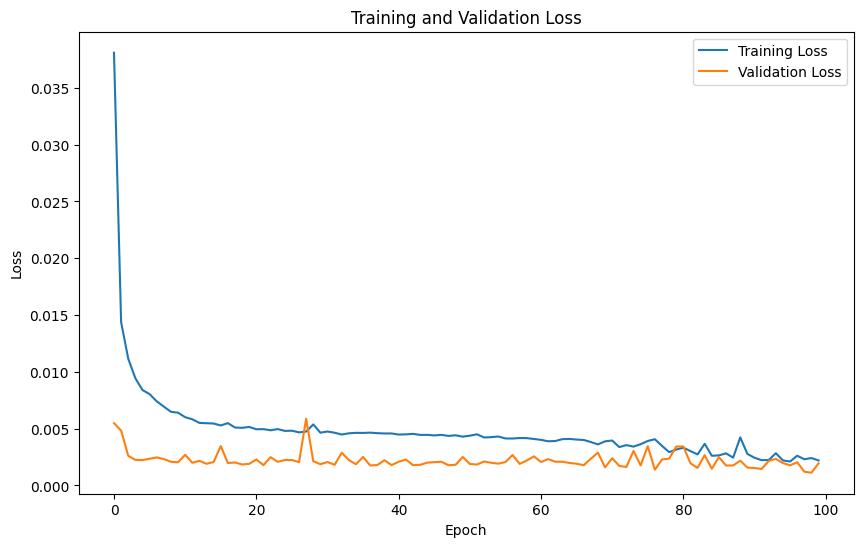

In [186]:
import tensorflow as tf
from tensorflow.keras import layers, models
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split

class SegRNN(models.Model):
    def __init__(self, input_dim, hidden_dim, window_length, output_dim, num_channels):
        super(SegRNN, self).__init__()
        self.hidden_dim = hidden_dim
        self.window_length = window_length
        self.num_segments = input_dim // window_length
        self.output_dim = output_dim
        self.num_channels = num_channels

        # Encoding layers
        self.proj = layers.Dense(hidden_dim, activation='relu')
        self.gru = layers.GRU(hidden_dim, return_sequences=True, return_state=True)
        self.dropout = layers.Dropout(0.5)
        
        # Decoding layers
        self.positional_embeddings = self.add_weight(
            shape=(self.num_segments, hidden_dim),
            initializer='random_normal', trainable=True)
        self.prediction_layer = layers.Dense(output_dim)

    def call(self, x):
        # Reshape x to (batch_size, window_length, num_channels)
        x = tf.reshape(x, (-1, self.window_length, self.num_channels))
    
        # Pass x through the projection layer and then to GRU
        x = self.proj(x)
        x = self.gru(x)  # Output from GRU will be (all_hidden_states, last_hidden_state)
        
        # Extract the last hidden state
        hn = x[1]  # x[1] contains the last hidden state
        
        # Modify hn shape to include a new axis for tiling
        hn = tf.expand_dims(hn, 1)

        # Tiling operation along the segment dimension
        multiples = [1, self.num_segments, 1]  # [batch_size, num_segments, hidden_dim]
        hn = tf.tile(hn, multiples)

        # Adding positional embeddings
        hn += self.positional_embeddings  # Broadcasting will happen automatically

        # Apply dropout and prediction layer
        y_pred = self.dropout(hn)
        y_pred = self.prediction_layer(y_pred)
        
        # Reshape output to (batch_size, num_segments * output_dim)
        y_pred = tf.reshape(y_pred, [-1, self.num_segments * self.output_dim])
        return y_pred

# Assuming your dataset is loaded correctly and preprocessed
# Example DataFrame load (Ensure your DataFrame is correctly defined)
# df = pd.read_csv('yourfile.csv')

# Normalize the features
scaler = MinMaxScaler()
df_scaled = scaler.fit_transform(df.iloc[:, :-1])  # Assuming the last column is the target

# Prepare input-output pairs for training
window_length = 32
num_samples = len(df_scaled) - window_length

X = np.zeros((num_samples, window_length, 26))  # 26 features
y = np.zeros((num_samples,))

for i in range(num_samples):
    X[i] = df_scaled[i:i+window_length]
    y[i] = df_scaled[i+window_length, -1]  

# Reshape y to match model output shape
y = y.reshape(-1, 1)

# Split data into training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)

# Define model parameters
sequence_length = window_length
num_features = 26
num_classes = 1
input_dim = sequence_length * num_features
hidden_dim = 64
output_dim = num_classes
num_channels = num_features

# Create and compile the model
model = SegRNN(input_dim, hidden_dim, window_length, output_dim, num_channels)
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])

# Train the model
#model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

44/44 [==============================] - 3s 13ms/step


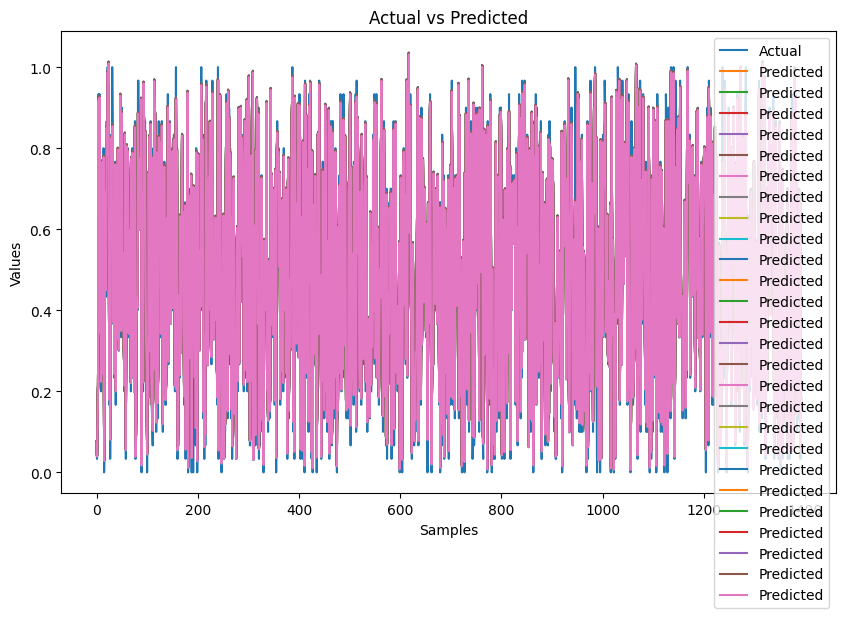

In [183]:
import matplotlib.pyplot as plt

# Make predictions on the test set
y_pred = model.predict(X_test)

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test, label='Actual')
plt.plot(y_pred, label='Predicted')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()
plt.show()


44/44 [==============================] - 2s 7ms/step


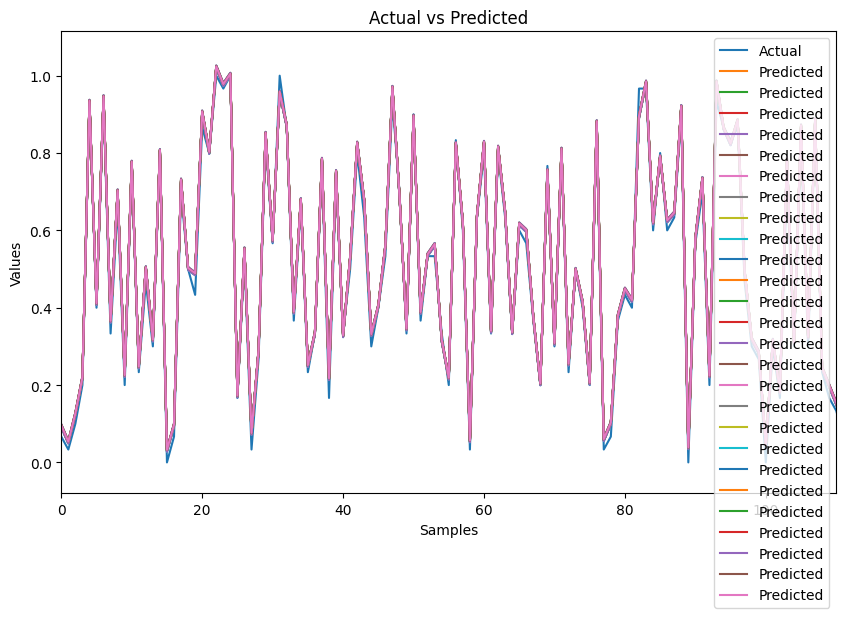

In [187]:
import matplotlib.pyplot as plt

# Make predictions on the test set
y_pred = model.predict(X_test)

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test, label='Actual')
plt.plot(y_pred, label='Predicted')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(0, 110)  # Set the x-axis limits for the first 12 samples
plt.legend()
plt.show()


X_train shape: (5569, 32, 26)
y_train shape: (5569, 1)
Epoch 1/100
140/140 [==============================] - 9s 14ms/step - loss: 0.2630 - mse: 0.2630 - val_loss: 0.2019 - val_mse: 0.2019
Epoch 2/100
140/140 [==============================] - 1s 8ms/step - loss: 0.1491 - mse: 0.1491 - val_loss: 0.1114 - val_mse: 0.1114
Epoch 3/100
140/140 [==============================] - 1s 8ms/step - loss: 0.0953 - mse: 0.0953 - val_loss: 0.0827 - val_mse: 0.0827
Epoch 4/100
140/140 [==============================] - 1s 8ms/step - loss: 0.0783 - mse: 0.0783 - val_loss: 0.0697 - val_mse: 0.0697
Epoch 5/100
140/140 [==============================] - 1s 8ms/step - loss: 0.0616 - mse: 0.0616 - val_loss: 0.0482 - val_mse: 0.0482
Epoch 6/100
140/140 [==============================] - 2s 11ms/step - loss: 0.0368 - mse: 0.0368 - val_loss: 0.0248 - val_mse: 0.0248
Epoch 7/100
140/140 [==============================] - 2s 11ms/step - loss: 0.0200 - mse: 0.0200 - val_loss: 0.0152 - val_mse: 0.0152
Epoch 8/100

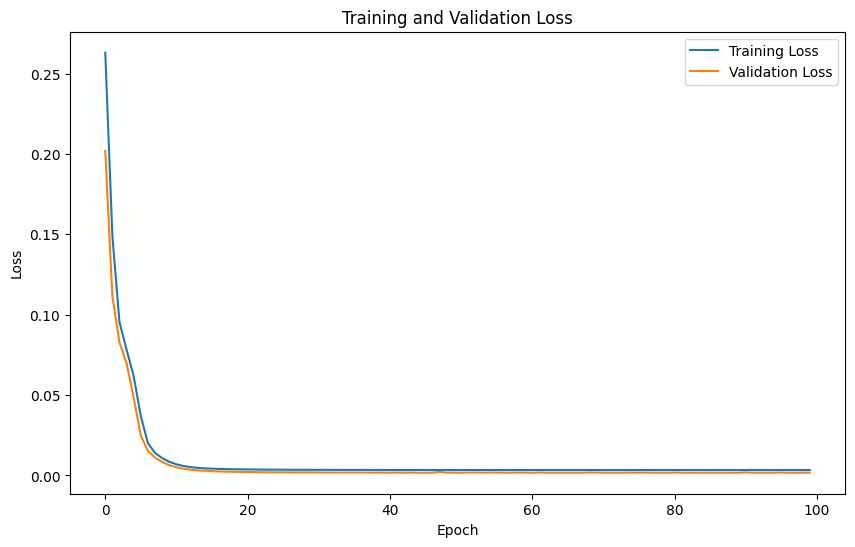

In [65]:
class SegRNN(models.Model):
    def __init__(self, num_features, window_length, num_segments, hidden_dim, output_dim):
        super(SegRNN, self).__init__()
        self.num_features = num_features
        self.window_length = window_length
        self.num_segments = num_segments
        self.hidden_dim = hidden_dim
        self.output_dim = output_dim

        self.proj = layers.Dense(hidden_dim, activation='relu')
        self.gru = layers.GRU(hidden_dim, return_sequences=True)
        self.prediction_layer = layers.Dense(output_dim)
        self.dropout = layers.Dropout(0.2)

    def call(self, x):
        
        x = self.proj(x)
        x = tf.reshape(x, (-1, self.num_segments, self.hidden_dim))
        x = self.gru(x)
        hn = x[:, -1, :]
        y_pred = self.prediction_layer(hn)
        return y_pred

num_features = 26
window_length = 32
num_segments = 8  # You need to decide how to define num_segments based on your data and model design
hidden_dim = 64
output_dim = 1

model = SegRNN(num_features, window_length, num_segments, hidden_dim, output_dim)
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])


# Ensure the output shape is (batch_size, 1)
scaler = MinMaxScaler()
df_scaled = scaler.fit_transform(df.iloc[:, :-1])  # Assuming the last column is the target

# Prepare input-output pairs for training
window_length = 32
num_samples = len(df_scaled) - window_length

X = np.zeros((num_samples, window_length, 26))  # 26 features
y = np.zeros((num_samples,))

for i in range(num_samples):
    X[i] = df_scaled[i:i+window_length]
    y[i] = df_scaled[i+window_length, -1]  

# Reshape y to match model output shape
y = y.reshape(-1, 1)



# Split data into training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)



# Create and compile the model
model = SegRNN(input_dim, hidden_dim, window_length, output_dim, num_channels)
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])

# Train the model
#model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()





44/44 [==============================] - 2s 9ms/step


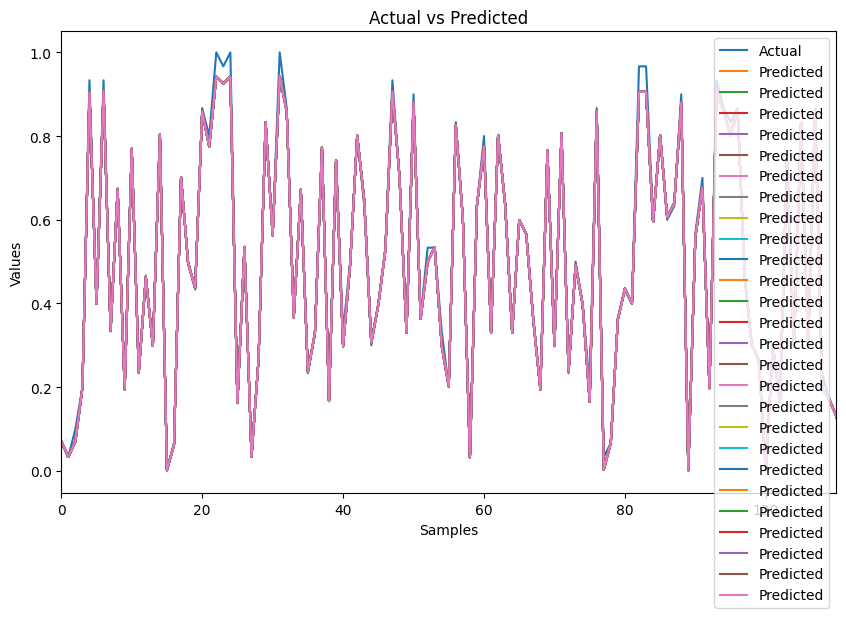

In [66]:
import matplotlib.pyplot as plt

# Make predictions on the test set
y_pred = model.predict(X_test)

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test, label='Actual')
plt.plot(y_pred, label='Predicted')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(0, 110)  # Set the x-axis limits for the first 12 samples
plt.legend()
plt.show()


X_train shape: (5569, 32, 26)
y_train shape: (5569, 1)
Epoch 1/60
140/140 [==============================] - 11s 18ms/step - loss: 0.2528 - mse: 0.2528 - val_loss: 0.1746 - val_mse: 0.1746
Epoch 2/60
140/140 [==============================] - 2s 11ms/step - loss: 0.1272 - mse: 0.1272 - val_loss: 0.0814 - val_mse: 0.0814
Epoch 3/60
140/140 [==============================] - 1s 8ms/step - loss: 0.0752 - mse: 0.0752 - val_loss: 0.0471 - val_mse: 0.0471
Epoch 4/60
140/140 [==============================] - 1s 8ms/step - loss: 0.0511 - mse: 0.0511 - val_loss: 0.0272 - val_mse: 0.0272
Epoch 5/60
140/140 [==============================] - 1s 8ms/step - loss: 0.0411 - mse: 0.0411 - val_loss: 0.0193 - val_mse: 0.0193
Epoch 6/60
140/140 [==============================] - 1s 8ms/step - loss: 0.0328 - mse: 0.0328 - val_loss: 0.0154 - val_mse: 0.0154
Epoch 7/60
140/140 [==============================] - 1s 8ms/step - loss: 0.0297 - mse: 0.0297 - val_loss: 0.0126 - val_mse: 0.0126
Epoch 8/60
140/140

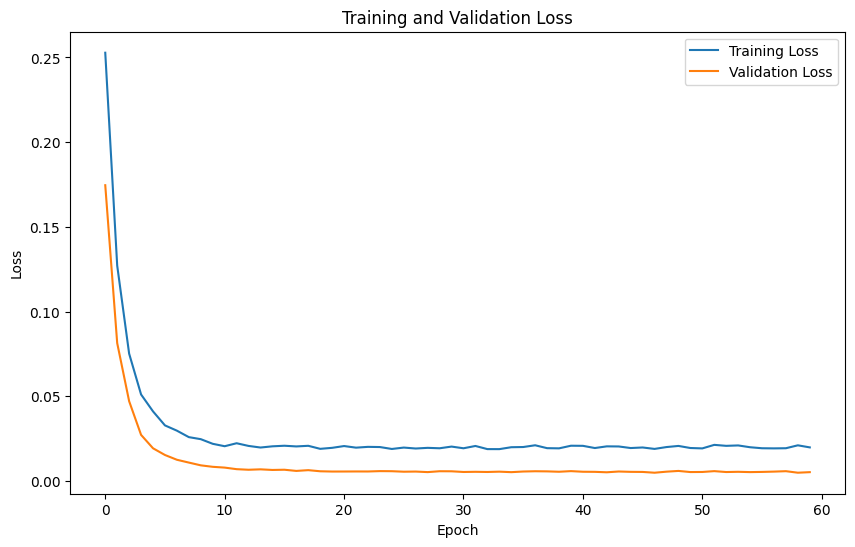

In [72]:
import tensorflow as tf
from tensorflow.keras import layers, models

class SegRNN(models.Model):
    def __init__(self, num_features, window_length, num_segments, hidden_dim, output_dim):
        super(SegRNN, self).__init__()
        self.num_features = num_features
        self.window_length = window_length
        self.num_segments = num_segments
        self.hidden_dim = hidden_dim
        self.output_dim = output_dim

        # Define the layers
        self.proj = layers.Dense(hidden_dim, activation='relu')
        self.gru = layers.GRU(hidden_dim, return_sequences=True)
        self.prediction_layer = layers.Dense(output_dim)
        self.dropout = layers.Dropout(0.2)  # Dropout layer

    def call(self, x):
        # Projection layer
        x = self.proj(x)
        # Reshape x to fit the GRU layer input requirements
        x = tf.reshape(x, (-1, self.num_segments, self.hidden_dim))
        # GRU layer processing
        x = self.gru(x)
        # Select the last output for each sequence
        hn = x[:, -1, :]
        # Apply dropout to the last hidden state output
        hn = self.dropout(hn)
        # Prediction layer
        y_pred = self.prediction_layer(hn)
        return y_pred


num_features = 26
window_length = 32
num_segments = 8  # You need to decide how to define num_segments based on your data and model design
hidden_dim = 64
output_dim = 1

model = SegRNN(num_features, window_length, num_segments, hidden_dim, output_dim)
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])


# Ensure the output shape is (batch_size, 1)
scaler = MinMaxScaler()
df_scaled = scaler.fit_transform(df.iloc[:, :-1])  # Assuming the last column is the target

# Prepare input-output pairs for training
window_length = 32
num_samples = len(df_scaled) - window_length

X = np.zeros((num_samples, window_length, 26))  # 26 features
y = np.zeros((num_samples,))

for i in range(num_samples):
    X[i] = df_scaled[i:i+window_length]
    y[i] = df_scaled[i+window_length, -1]  

# Reshape y to match model output shape
y = y.reshape(-1, 1)



# Split data into training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)



# Create and compile the model
model = SegRNN(input_dim, hidden_dim, window_length, output_dim, num_channels)
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])

# Train the model
#model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)
history = model.fit(X_train, y_train, epochs=60, batch_size=32, validation_split=0.2)

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


44/44 [==============================] - 1s 5ms/step


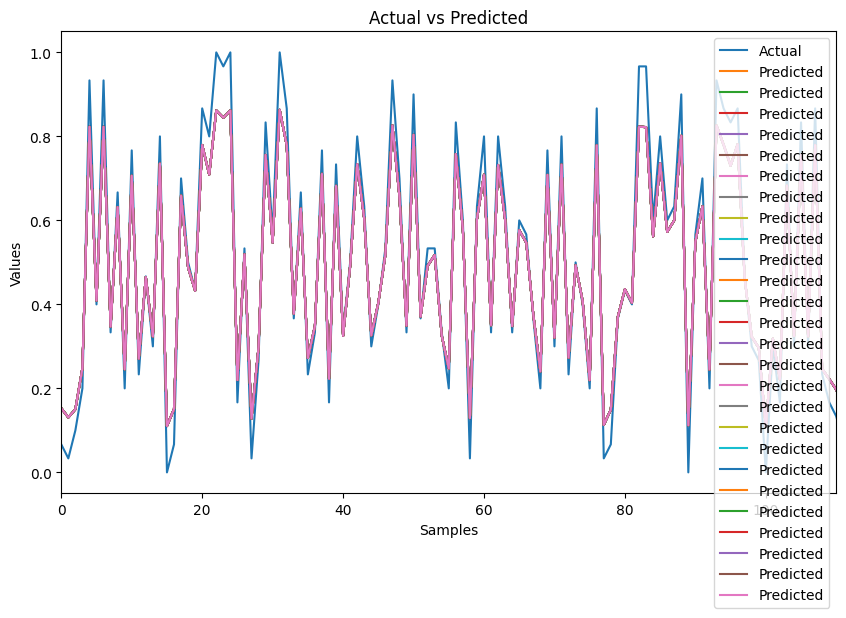

In [73]:
import matplotlib.pyplot as plt

# Make predictions on the test set
y_pred = model.predict(X_test)

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test, label='Actual')
plt.plot(y_pred, label='Predicted')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(0, 110)  # Set the x-axis limits for the first 12 samples
plt.legend()
plt.show()


X_train shape: (5569, 32, 26)
y_train shape: (5569, 1)
Epoch 1/100
140/140 [==============================] - 6s 13ms/step - loss: 0.2469 - mse: 0.2469 - val_loss: 0.1777 - val_mse: 0.1777
Epoch 2/100
140/140 [==============================] - 1s 9ms/step - loss: 0.1363 - mse: 0.1363 - val_loss: 0.1084 - val_mse: 0.1084
Epoch 3/100
140/140 [==============================] - 1s 10ms/step - loss: 0.0969 - mse: 0.0969 - val_loss: 0.0867 - val_mse: 0.0867
Epoch 4/100
140/140 [==============================] - 1s 9ms/step - loss: 0.0841 - mse: 0.0841 - val_loss: 0.0782 - val_mse: 0.0782
Epoch 5/100
140/140 [==============================] - 1s 9ms/step - loss: 0.0754 - mse: 0.0754 - val_loss: 0.0670 - val_mse: 0.0670
Epoch 6/100
140/140 [==============================] - 1s 9ms/step - loss: 0.0581 - mse: 0.0581 - val_loss: 0.0452 - val_mse: 0.0452
Epoch 7/100
140/140 [==============================] - 2s 11ms/step - loss: 0.0363 - mse: 0.0363 - val_loss: 0.0265 - val_mse: 0.0265
Epoch 8/100

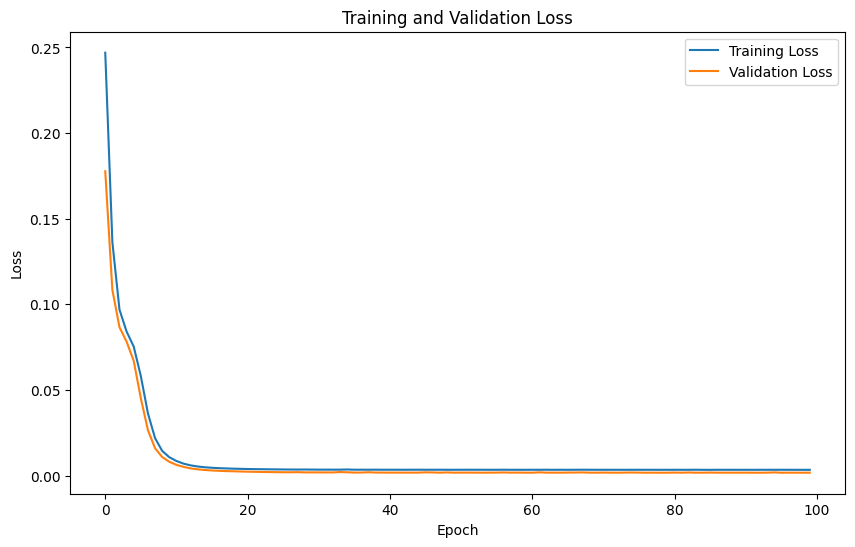

In [77]:
class SegRNN(models.Model):
    def __init__(self, num_features, window_length, num_segments, hidden_dim, output_dim):
        super(SegRNN, self).__init__()
        self.num_features = num_features
        self.window_length = window_length
        self.num_segments = num_segments
        self.hidden_dim = hidden_dim
        self.output_dim = output_dim

        self.proj = layers.Dense(hidden_dim, activation='relu')
        self.gru = layers.GRU(hidden_dim, return_sequences=True)
        self.prediction_layer = layers.Dense(output_dim)
        self.dropout = layers.Dropout(0.2)

    def call(self, x):
        
        x = self.proj(x)
        x = tf.reshape(x, (-1, self.num_segments, self.hidden_dim))
        x = self.gru(x)
        hn = x[:, -1, :]
        y_pred = self.prediction_layer(hn)
        return y_pred

num_features = 26
window_length = 32
num_segments = 8  # You need to decide how to define num_segments based on your data and model design
hidden_dim = 64
output_dim = 1

model = SegRNN(num_features, window_length, num_segments, hidden_dim, output_dim)
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])


# Ensure the output shape is (batch_size, 1)
scaler = MinMaxScaler()
df_scaled = scaler.fit_transform(df1.iloc[:, :-1])  # Assuming the last column is the target

# Prepare input-output pairs for training
window_length = 32
num_samples = len(df_scaled) - window_length

X = np.zeros((num_samples, window_length, 26))  # 26 features
y = np.zeros((num_samples,))

for i in range(num_samples):
    X[i] = df_scaled[i:i+window_length]
    y[i] = df_scaled[i+window_length, -1]  

# Reshape y to match model output shape
y = y.reshape(-1, 1)



# Split data into training and testing
X_train, X_test1, y_train, y_test1 = train_test_split(X, y, test_size=0.2, random_state=42)
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)



# Create and compile the model
model = SegRNN(input_dim, hidden_dim, window_length, output_dim, num_channels)
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])

# Train the model
#model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()



44/44 [==============================] - 1s 6ms/step


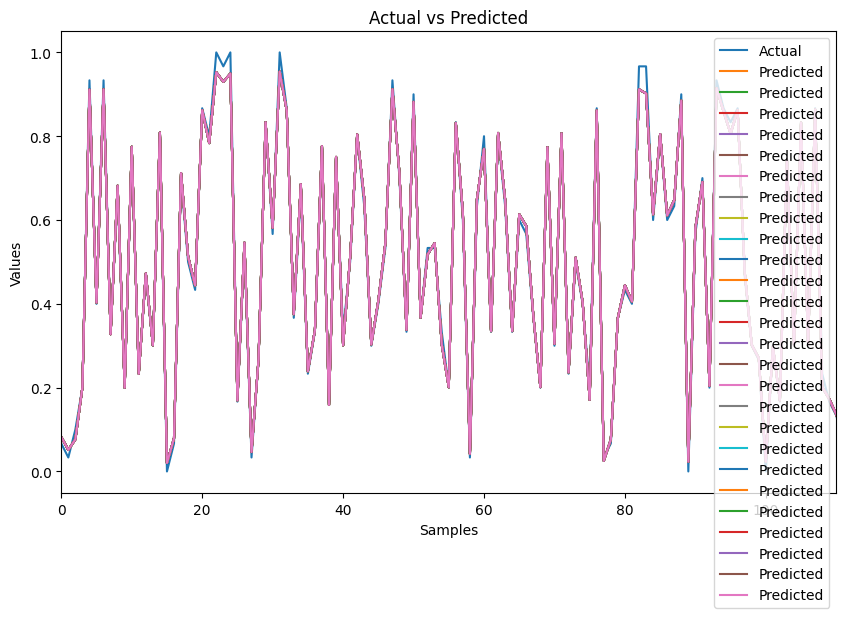

In [78]:
import matplotlib.pyplot as plt

# Make predictions on the test set
y_pred = model.predict(X_test1)

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test1, label='Actual')
plt.plot(y_pred, label='Predicted')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(0, 110)  # Set the x-axis limits for the first 12 samples
plt.legend()
plt.show()


X_train shape: (5569, 32, 26)
y_train shape: (5569, 1)
Epoch 1/100
140/140 [==============================] - 15s 30ms/step - loss: 0.0261 - mse: 0.0261 - val_loss: 0.0040 - val_mse: 0.0040
Epoch 2/100
140/140 [==============================] - 3s 23ms/step - loss: 0.0059 - mse: 0.0059 - val_loss: 0.0029 - val_mse: 0.0029
Epoch 3/100
140/140 [==============================] - 3s 23ms/step - loss: 0.0052 - mse: 0.0052 - val_loss: 0.0022 - val_mse: 0.0022
Epoch 4/100
140/140 [==============================] - 3s 20ms/step - loss: 0.0048 - mse: 0.0048 - val_loss: 0.0027 - val_mse: 0.0027
Epoch 5/100
140/140 [==============================] - 3s 22ms/step - loss: 0.0044 - mse: 0.0044 - val_loss: 0.0022 - val_mse: 0.0022
Epoch 6/100
140/140 [==============================] - 4s 29ms/step - loss: 0.0047 - mse: 0.0047 - val_loss: 0.0029 - val_mse: 0.0029
Epoch 7/100
140/140 [==============================] - 4s 26ms/step - loss: 0.0043 - mse: 0.0043 - val_loss: 0.0040 - val_mse: 0.0040
Epoch 

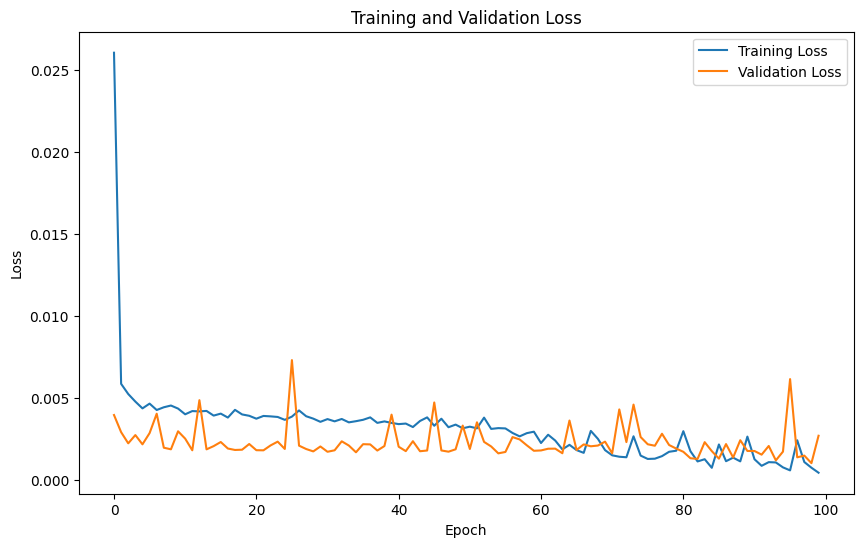

In [138]:
import tensorflow as tf
from tensorflow.keras import layers, models

class SegRNN(models.Model):
    def __init__(self, num_features, window_length, num_segments, hidden_dim, output_dim, prediction_horizon):
        super(SegRNN, self).__init__()
        self.num_features = num_features
        self.window_length = window_length
        self.num_segments = num_segments
        self.hidden_dim = hidden_dim
        self.output_dim = output_dim  # Ensure this is set to 1 for single-value output
        self.prediction_horizon = prediction_horizon

        # Encoding
        self.proj = layers.Dense(hidden_dim, activation='relu')
        self.gru = layers.GRU(hidden_dim, return_sequences=True)
        self.positional_embedding = layers.Embedding(input_dim=prediction_horizon // window_length, output_dim=hidden_dim)
        
        # Decoding
        self.parallel_gru = layers.GRU(hidden_dim, return_sequences=True)
        self.prediction_layer = layers.Dense(output_dim)  # Outputs a single value
        self.dropout = layers.Dropout(0.2)

    def call(self, x):
        # Segment partition and projection
        x = self.proj(x)
        
        
        # Encoding phase with GRU
        x = self.gru(x)
        hn = x[:, -1, :]
        
        # Prepare for parallel decoding
        m = self.prediction_horizon // self.window_length
        hn_repeated = tf.repeat(tf.expand_dims(hn, 1), repeats=m, axis=1)
        pos_embeddings = self.positional_embedding(tf.range(start=0, limit=m))
        combined_input = hn_repeated + pos_embeddings
        
        # Parallel decoding
        y_parallel = self.parallel_gru(combined_input)
        y_parallel = self.dropout(y_parallel)
        y_pred = self.prediction_layer(y_parallel)

        # Reshape or aggregate the outputs for final prediction
        y_pred = tf.reduce_mean(y_pred, axis=1)  # Aggregating over the time steps if needed

        return y_pred

# Example usage:
model = SegRNN(num_features=26, window_length=5, num_segments=10, hidden_dim=64, output_dim=1, prediction_horizon=50)



num_features = 26
window_length = 32
num_segments = 8  # You need to decide how to define num_segments based on your data and model design
hidden_dim = 64
output_dim = 1

model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])


# Ensure the output shape is (batch_size, 1)
scaler = MinMaxScaler()
df_scaled = scaler.fit_transform(df.iloc[:, :-1])  # Assuming the last column is the target

# Prepare input-output pairs for training
window_length = 32
num_samples = len(df_scaled) - window_length

X = np.zeros((num_samples, window_length, 26))  # 26 features
y = np.zeros((num_samples,))

for i in range(num_samples):
    X[i] = df_scaled[i:i+window_length]
    y[i] = df_scaled[i+window_length, -1]  

# Reshape y to match model output shape
y = y.reshape(-1, 1)



# Split data into training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)





# Train the model
#model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


44/44 [==============================] - 6s 11ms/step


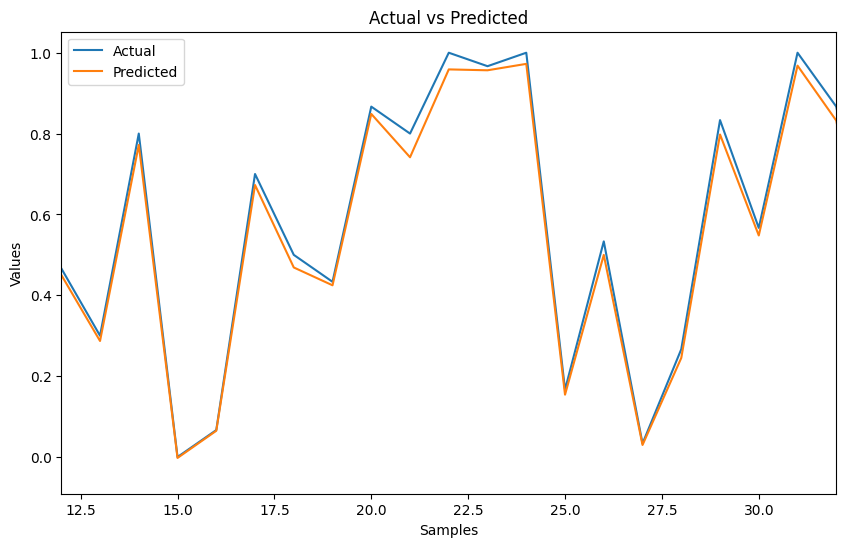

In [139]:
import matplotlib.pyplot as plt

# Make predictions on the test set
y_pred = model.predict(X_test)

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test, label='Actual')
plt.plot(y_pred, label='Predicted')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(12, 32)  # Set the x-axis limits for the first 12 samples
plt.legend()
plt.show()

# Try this model with all clients

In [166]:
file= '../data/consommation.csv'
data=pd.read_csv(file)
cluster=pd.read_csv('../clustering/cluster_client_consumption_pdf.csv')
clustering=pd.merge(data,cluster, on=['county', 'product_type', 'is_business'],how='inner')
grouped_data = data.groupby(['product_type','is_business','county'])


df = grouped_data.get_group((1,0,0))

df = df[[col for col in df.columns if col != 'target'] + ['target']]
df.drop(columns=['datetime','Unnamed: 0'], inplace=True)

In [280]:
df.shape

(6994, 27)

In [167]:
import tensorflow as tf
from tensorflow.keras import layers, models

class SegRNN_complicate(models.Model):
    def __init__(self, num_features, window_length, num_segments, hidden_dim, output_dim, prediction_horizon):
        super(SegRNN_complicate, self).__init__()
        self.num_features = num_features
        self.window_length = window_length
        self.num_segments = num_segments
        self.hidden_dim = hidden_dim
        self.output_dim = output_dim  # Ensure this is set to 1 for single-value output
        self.prediction_horizon = prediction_horizon

        # Encoding
        self.proj = layers.Dense(hidden_dim, activation='relu')
        self.gru = layers.GRU(hidden_dim, return_sequences=True)
        self.positional_embedding = layers.Embedding(input_dim=prediction_horizon // window_length, output_dim=hidden_dim)
        
        # Decoding
        self.parallel_gru = layers.GRU(hidden_dim, return_sequences=True)
        self.prediction_layer = layers.Dense(output_dim)  # Outputs a single value
        self.dropout = layers.Dropout(0.2)

    def call(self, x):
        # Segment partition and projection
        x = self.proj(x)
        
        
        # Encoding phase with GRU
        x = self.gru(x)
        hn = x[:, -1, :]
        
        # Prepare for parallel decoding
        m = self.prediction_horizon // self.window_length
        hn_repeated = tf.repeat(tf.expand_dims(hn, 1), repeats=m, axis=1)
        pos_embeddings = self.positional_embedding(tf.range(start=0, limit=m))
        combined_input = hn_repeated + pos_embeddings
        
        # Parallel decoding
        y_parallel = self.parallel_gru(combined_input)
        y_parallel = self.dropout(y_parallel)
        y_pred = self.prediction_layer(y_parallel)

        # Reshape or aggregate the outputs for final prediction
        y_pred = tf.reduce_mean(y_pred, axis=1)  # Aggregating over the time steps if needed

        return y_pred

X_train shape: (5569, 32, 26)
y_train shape: (5569, 1)
Epoch 1/100
140/140 [==============================] - 11s 28ms/step - loss: 0.0154 - mse: 0.0154 - val_loss: 0.0038 - val_mse: 0.0038
Epoch 2/100
140/140 [==============================] - 3s 19ms/step - loss: 0.0059 - mse: 0.0059 - val_loss: 0.0027 - val_mse: 0.0027
Epoch 3/100
140/140 [==============================] - 3s 18ms/step - loss: 0.0053 - mse: 0.0053 - val_loss: 0.0025 - val_mse: 0.0025
Epoch 4/100
140/140 [==============================] - 2s 17ms/step - loss: 0.0049 - mse: 0.0049 - val_loss: 0.0024 - val_mse: 0.0024
Epoch 5/100
140/140 [==============================] - 3s 20ms/step - loss: 0.0045 - mse: 0.0045 - val_loss: 0.0027 - val_mse: 0.0027
Epoch 6/100
140/140 [==============================] - 2s 16ms/step - loss: 0.0046 - mse: 0.0046 - val_loss: 0.0052 - val_mse: 0.0052
Epoch 7/100
140/140 [==============================] - 2s 14ms/step - loss: 0.0043 - mse: 0.0043 - val_loss: 0.0023 - val_mse: 0.0023
Epoch 

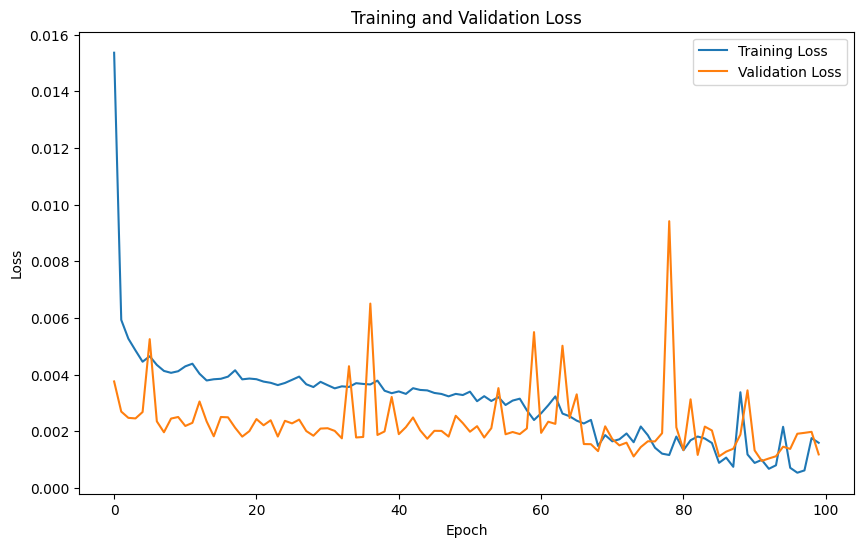

In [168]:
# Example usage:
model = SegRNN_complicate(num_features=26, window_length=5, num_segments=10, hidden_dim=64, output_dim=1, prediction_horizon=50)



num_features = 26
window_length = 32
num_segments = 8  # You need to decide how to define num_segments based on your data and model design
hidden_dim = 64
output_dim = 1

model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])


# Ensure the output shape is (batch_size, 1)
scaler = MinMaxScaler()
df_scaled = scaler.fit_transform(df.iloc[:, :-1])  # Assuming the last column is the target

# Prepare input-output pairs for training
window_length = 32
num_samples = len(df_scaled) - window_length

X = np.zeros((num_samples, window_length, 26))  # 26 features
y = np.zeros((num_samples,))

for i in range(num_samples):
    X[i] = df_scaled[i:i+window_length]
    y[i] = df_scaled[i+window_length, -1]  

# Reshape y to match model output shape
y = y.reshape(-1, 1)



# Split data into training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)





# Train the model
#model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


44/44 [==============================] - 5s 12ms/step


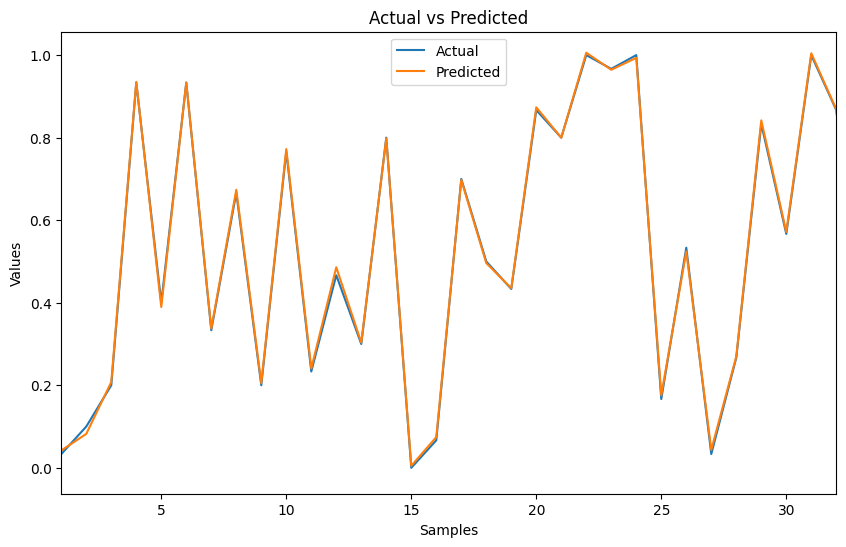

In [161]:
import matplotlib.pyplot as plt

# Make predictions on the test set
y_pred = model.predict(X_test)

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test, label='Actual')
plt.plot(y_pred, label='Predicted')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(1, 32)  # Set the x-axis limits for the first 12 samples
plt.legend()
plt.show()

# Choose the sample model

In [196]:
file= '../data/consommation.csv'
data=pd.read_csv(file)
cluster=pd.read_csv('../clustering/cluster_client_consumption_pdf.csv')
clustering=pd.merge(data,cluster, on=['county', 'product_type', 'is_business'],how='inner')
grouped_data = data.groupby(['product_type','is_business','county'])


df = grouped_data.get_group((1,0,0))

df = df[[col for col in df.columns if col != 'target'] + ['target']]
df.drop(columns=['datetime','Unnamed: 0'], inplace=True)

In [197]:
class SegRNN_Sample(models.Model):
    def __init__(self, num_features, window_length, num_segments, hidden_dim, output_dim):
        super(SegRNN_Sample, self).__init__()
        self.num_features = num_features
        self.window_length = window_length
        self.num_segments = num_segments
        self.hidden_dim = hidden_dim
        self.output_dim = output_dim

        self.proj = layers.Dense(hidden_dim, activation='relu')
        self.gru = layers.GRU(hidden_dim, return_sequences=True)
        self.prediction_layer = layers.Dense(output_dim)
        self.dropout = layers.Dropout(0.2)

    def call(self, x):
        
        x = self.proj(x)
        x = tf.reshape(x, (-1, self.num_segments, self.hidden_dim))
        x = self.gru(x)
        hn = x[:, -1, :]
        y_pred = self.prediction_layer(hn)
        return y_pred

Epoch 1/100
140/140 [==============================] - 8s 17ms/step - loss: 0.0200 - mse: 0.0200 - val_loss: 0.0051 - val_mse: 0.0051
Epoch 2/100
140/140 [==============================] - 2s 14ms/step - loss: 0.0071 - mse: 0.0071 - val_loss: 0.0038 - val_mse: 0.0038
Epoch 3/100
140/140 [==============================] - 2s 18ms/step - loss: 0.0057 - mse: 0.0057 - val_loss: 0.0037 - val_mse: 0.0037
Epoch 4/100
140/140 [==============================] - 2s 14ms/step - loss: 0.0047 - mse: 0.0047 - val_loss: 0.0031 - val_mse: 0.0031
Epoch 5/100
140/140 [==============================] - 3s 18ms/step - loss: 0.0042 - mse: 0.0042 - val_loss: 0.0028 - val_mse: 0.0028
Epoch 6/100
140/140 [==============================] - 2s 17ms/step - loss: 0.0041 - mse: 0.0041 - val_loss: 0.0026 - val_mse: 0.0026
Epoch 7/100
140/140 [==============================] - 2s 12ms/step - loss: 0.0036 - mse: 0.0036 - val_loss: 0.0027 - val_mse: 0.0027
Epoch 8/100
140/140 [==============================] - 1s 10ms

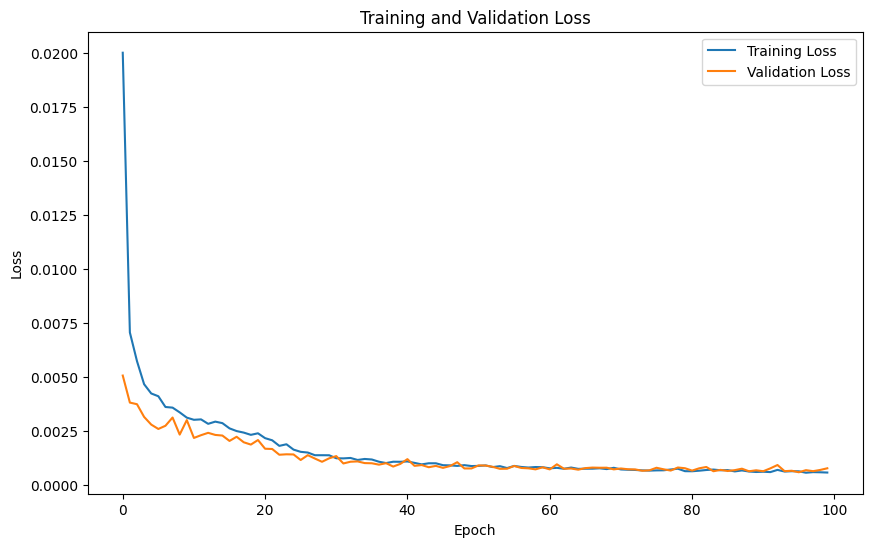

In [226]:
class SegRNN_Sample(models.Model):
    def __init__(self, num_features, window_length, hidden_dim):
        super(SegRNN_Sample, self).__init__()
        self.num_features = num_features
        self.window_length = window_length
        self.hidden_dim = hidden_dim

        self.proj = layers.Dense(hidden_dim, activation='relu')
        self.gru = layers.GRU(hidden_dim, return_sequences=True)  # Set return_sequences to True
        self.prediction_layer = layers.Dense(1)  # Output a single value per window
        self.dropout = layers.Dropout(0.2)

    def call(self, x):
        # Apply Dense layer for initial projection
        x = self.proj(x)

        # Reshape to (batch_size, window_length, hidden_dim)
        x = tf.reshape(x, (-1, self.window_length, self.hidden_dim))

        # Apply GRU layer (return_sequences=True for output at each timestep)
        x = self.gru(x)

        # Apply dropout for regularization
        x = self.dropout(x)

        # Apply final prediction layer to get single output for each window
        # Take the output at the last time step (window_length - 1)
        y_pred = self.prediction_layer(x[:, -1, :])  # Shape should be (batch_size, 1)

        return y_pred


# Define model parameters
num_features = 26
window_length = 20
hidden_dim = 64
output_dim = 1  # For predicting a single value

# Create an instance of SegRNN_Sample model
model = SegRNN_Sample(num_features, window_length, hidden_dim)

# Normalize data
scaler = MinMaxScaler()
df_scaled = scaler.fit_transform(df)

# Prepare input-output pairs for training
num_samples = len(df_scaled) - window_length

X = np.zeros((num_samples, window_length, num_features))  # 26 features
y = np.zeros((num_samples,))

for i in range(num_samples):
    X[i] = df_scaled[i:i+window_length, :-1]
    y[i] = df_scaled[i+window_length, -1]  

# Split data into training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Reshape y to match model output shape
y_train = y_train.reshape(-1, 1)  # Reshape y_train to (num_samples, 1)

# Create and compile model
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])

# Train model
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


44/44 [==============================] - 0s 6ms/step
R² Score: 0.9799207329406555
Mean Absolute Error (MAE): 0.018304253046751436
Mean Squared Error (MSE): 0.0006867542010316986


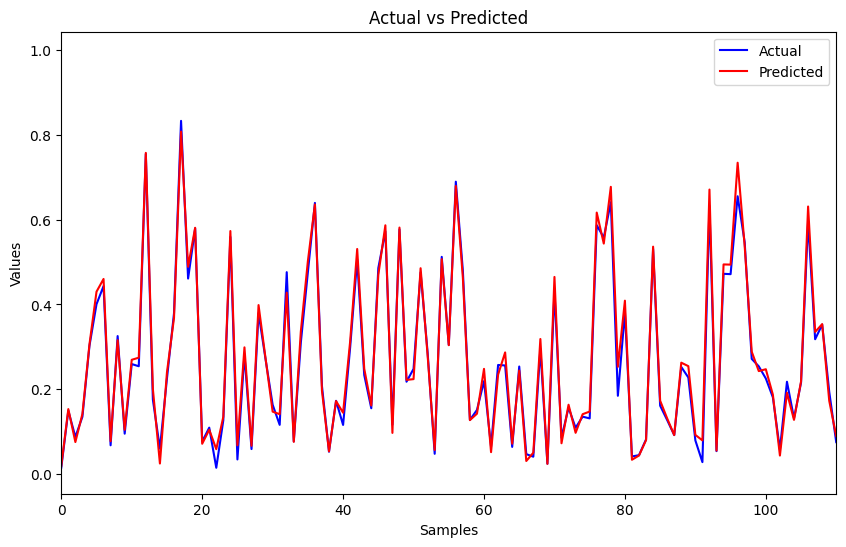

In [230]:
# Assuming y_test and y_pred are already defined and available

from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
y_pred = model.predict(X_test)
# Calculate R² score
r2 = r2_score(y_test, y_pred)
print(f"R² Score: {r2}")

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(y_test, y_pred)
print(f"Mean Absolute Error (MAE): {mae}")

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error (MSE): {mse}")

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test, label='Actual', color='blue')
plt.plot(y_pred, label='Predicted', color='red')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(0, 110)  # Set the x-axis limits for the first 110 samples
plt.legend()
plt.show()

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 3s 10ms/step


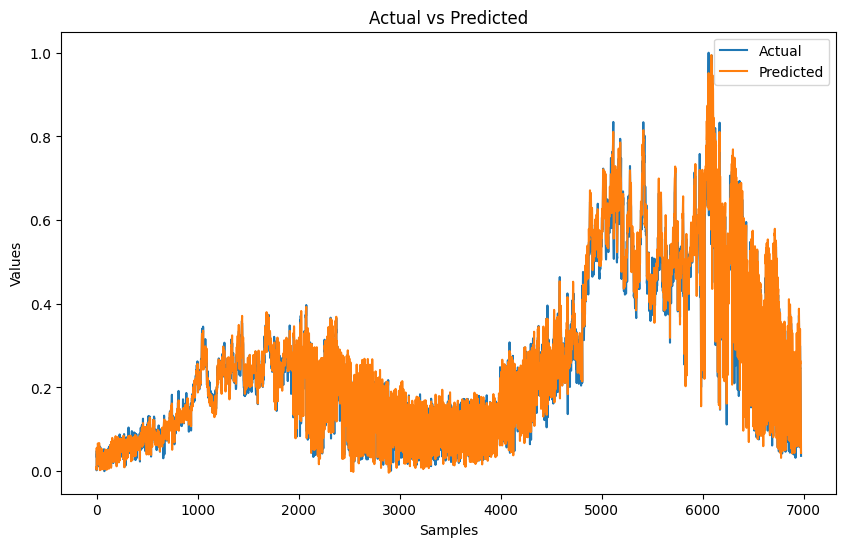

  1/218 [..............................] - ETA: 8s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 4ms/step


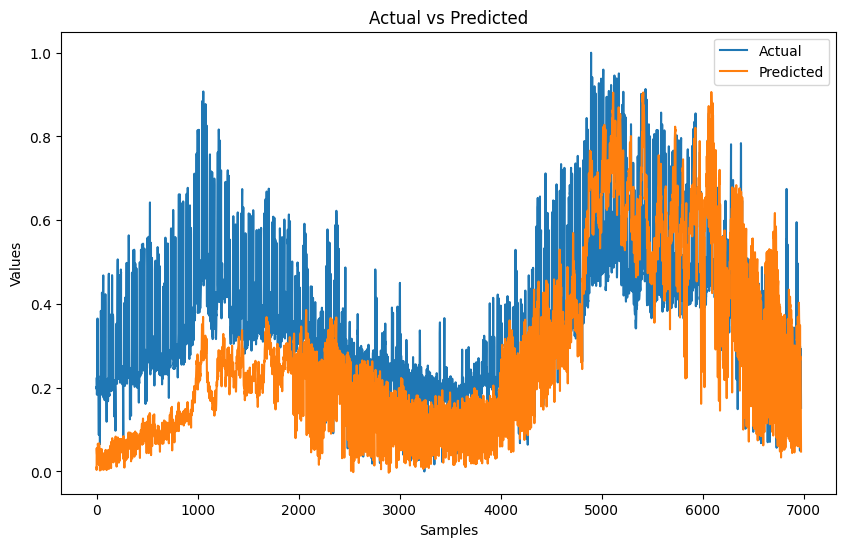

  1/218 [..............................] - ETA: 8s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 4ms/step


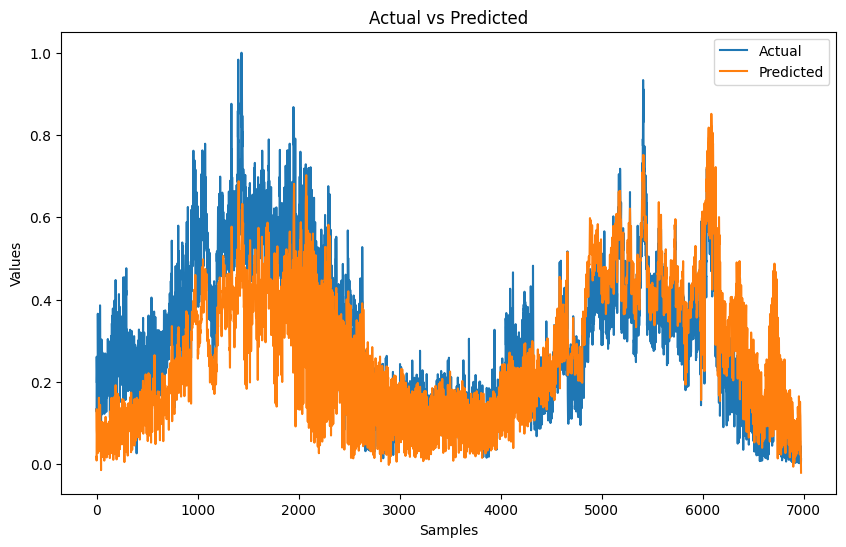

  1/208 [..............................] - ETA: 7s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


208/208 [==============================] - 1s 5ms/step


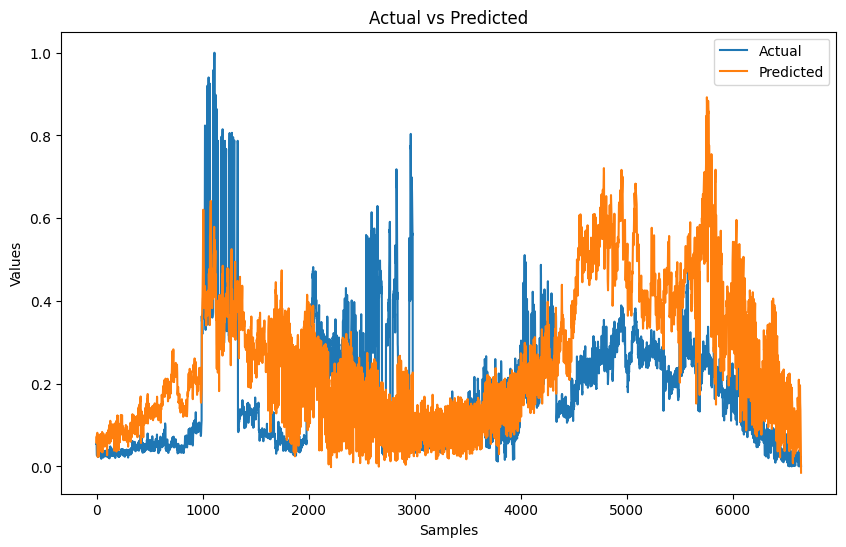

  1/218 [..............................] - ETA: 8s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


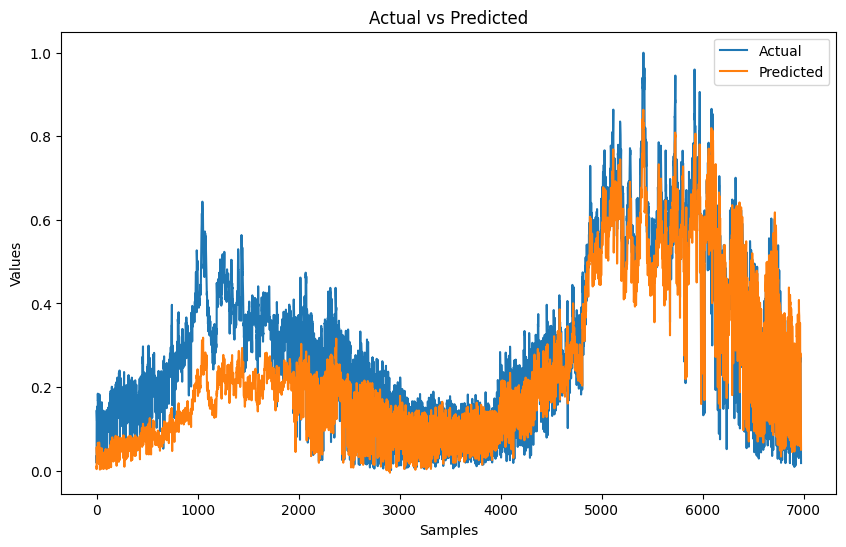

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 6ms/step


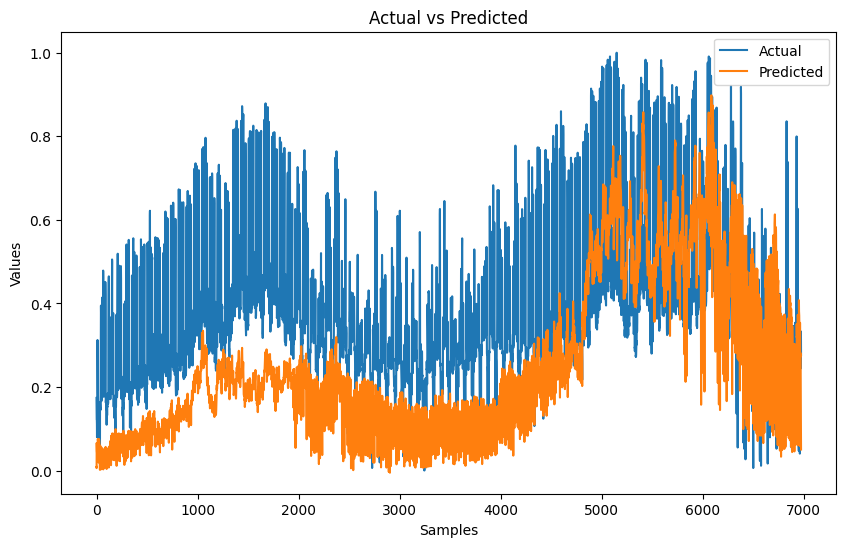

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 2s 9ms/step


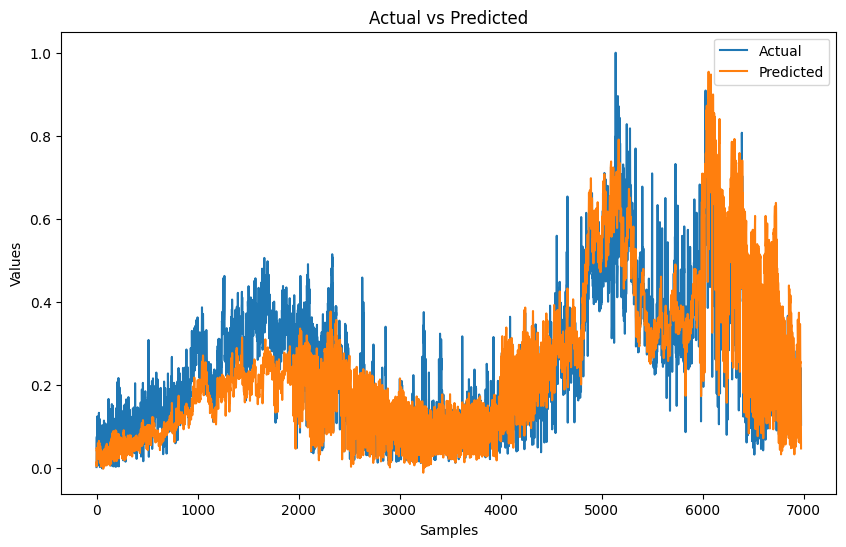

 12/218 [>.............................] - ETA: 0s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


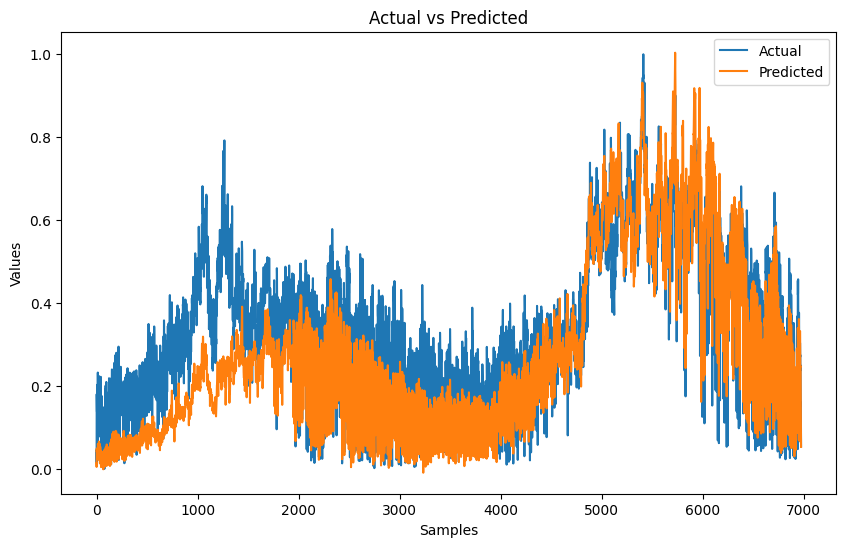

  1/218 [..............................] - ETA: 7s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


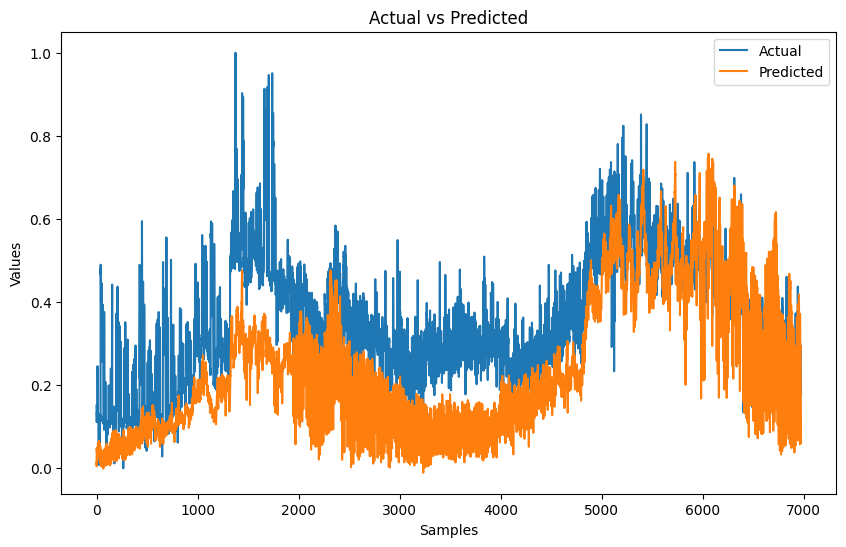

 13/208 [>.............................] - ETA: 0s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


208/208 [==============================] - 1s 6ms/step


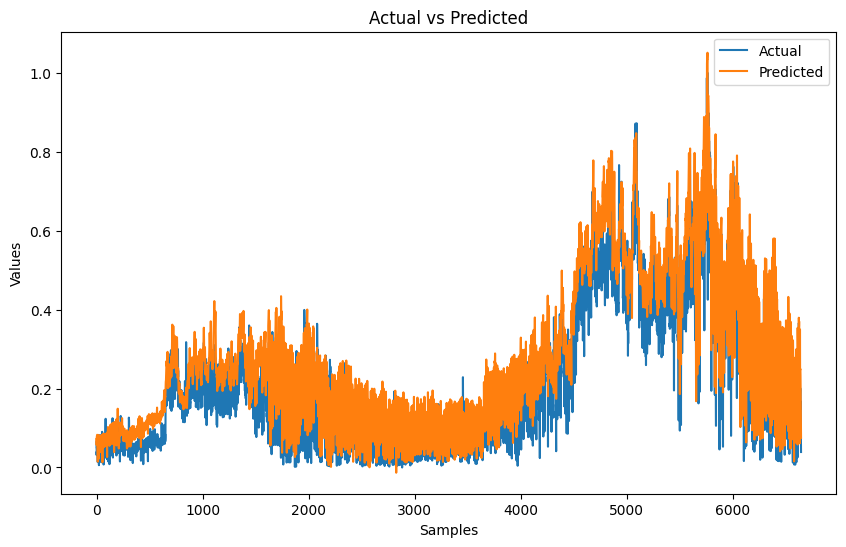

  1/218 [..............................] - ETA: 8s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 6ms/step


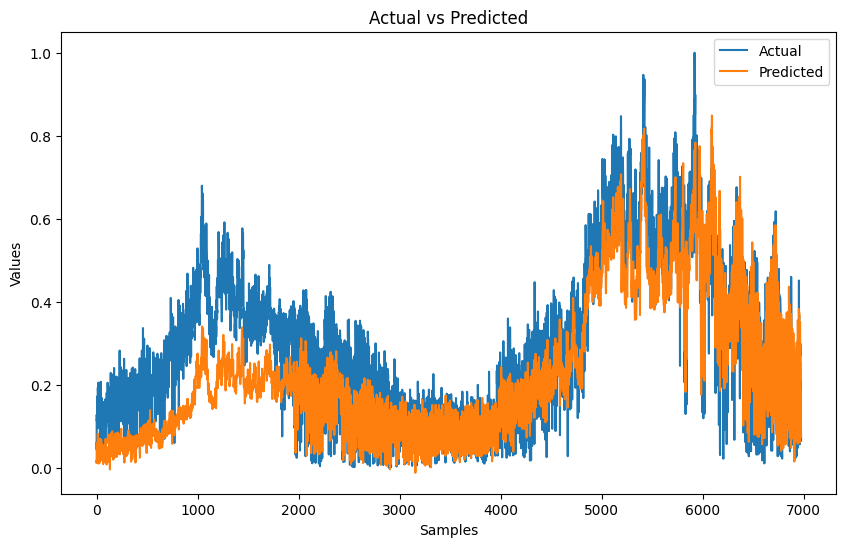

  1/218 [..............................] - ETA: 9s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 6ms/step


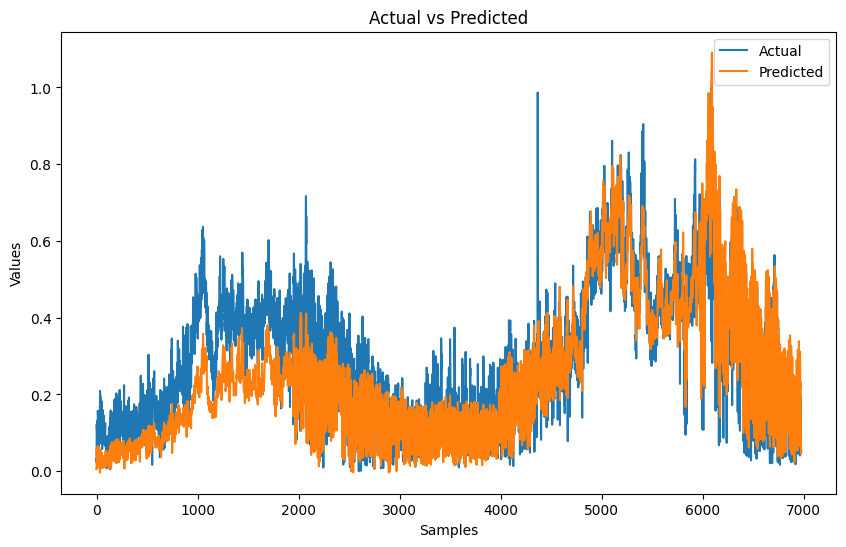

  1/218 [..............................] - ETA: 7s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


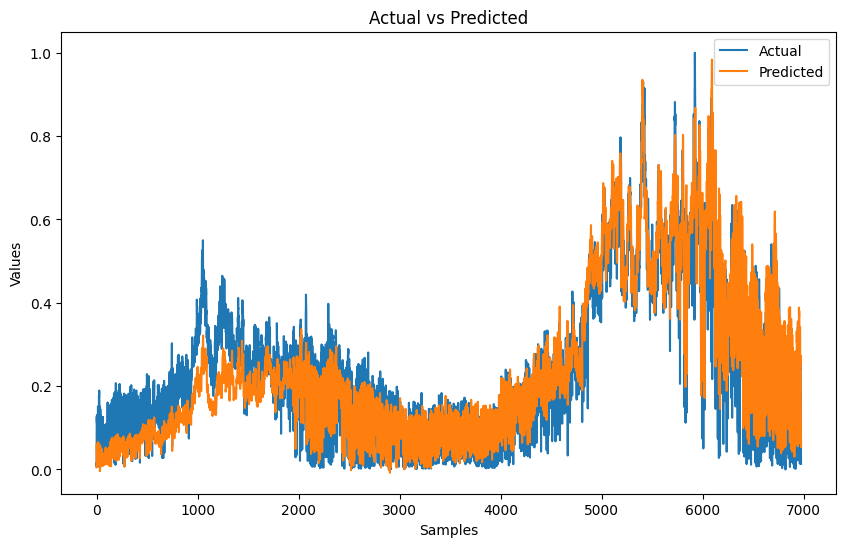

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 2s 7ms/step


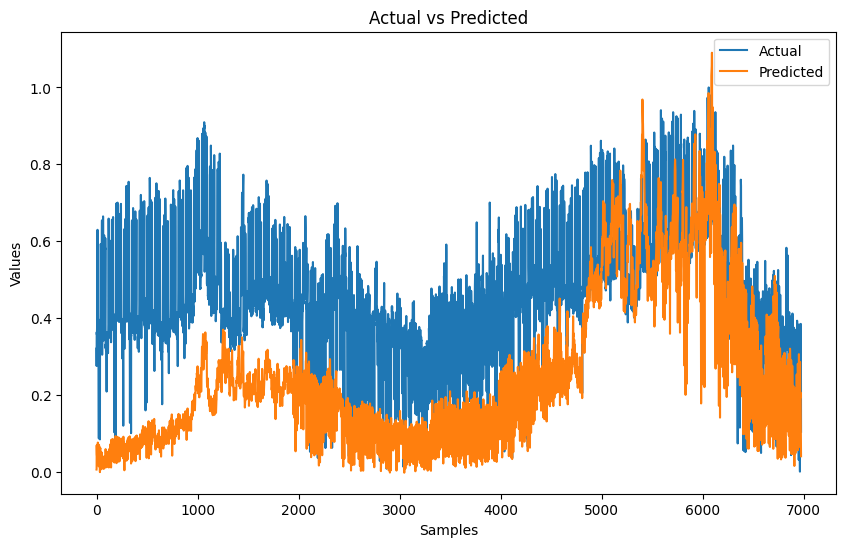

 12/218 [>.............................] - ETA: 0s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


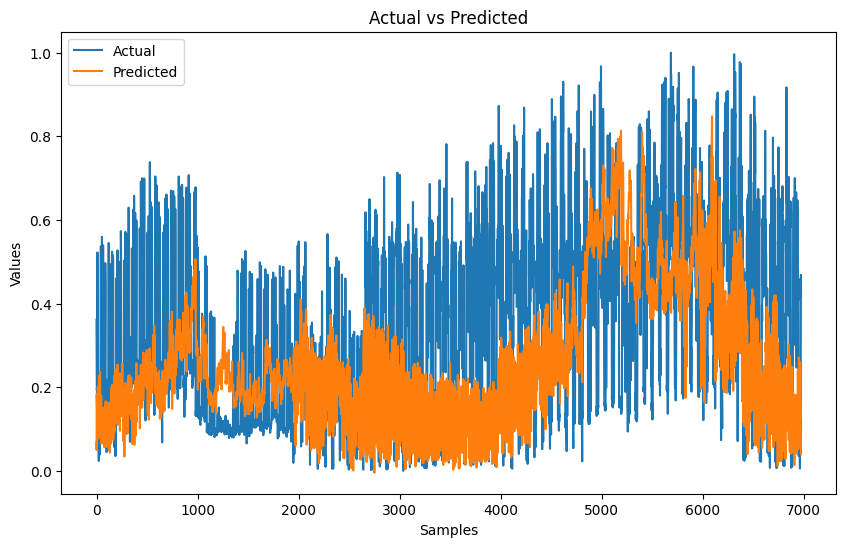

 13/218 [>.............................] - ETA: 0s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


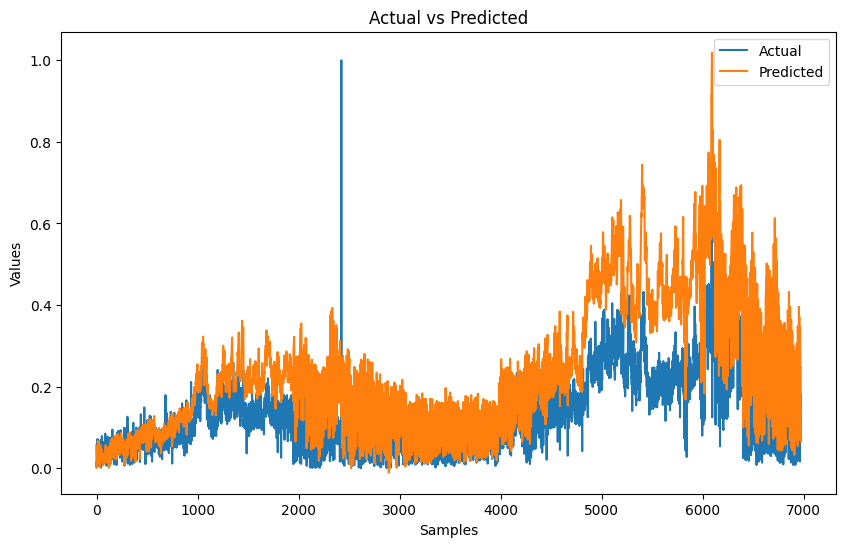

  1/218 [..............................] - ETA: 6s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


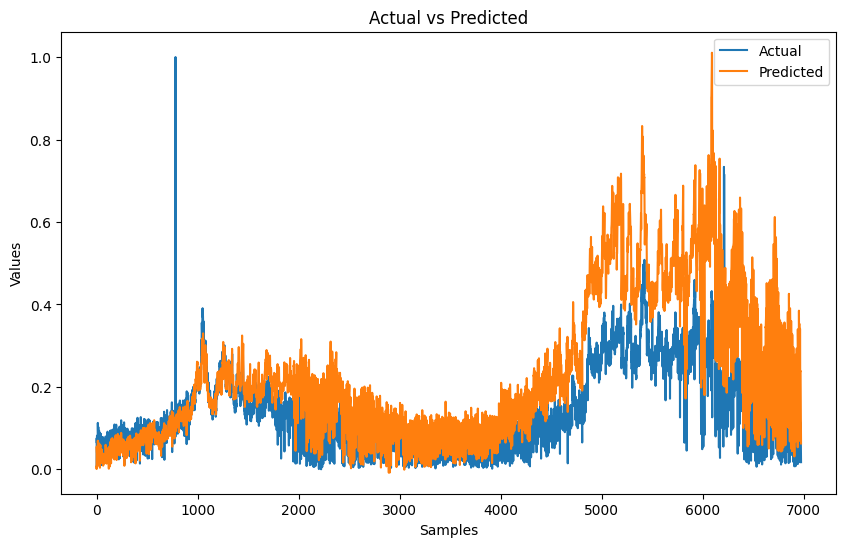

 13/218 [>.............................] - ETA: 0s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


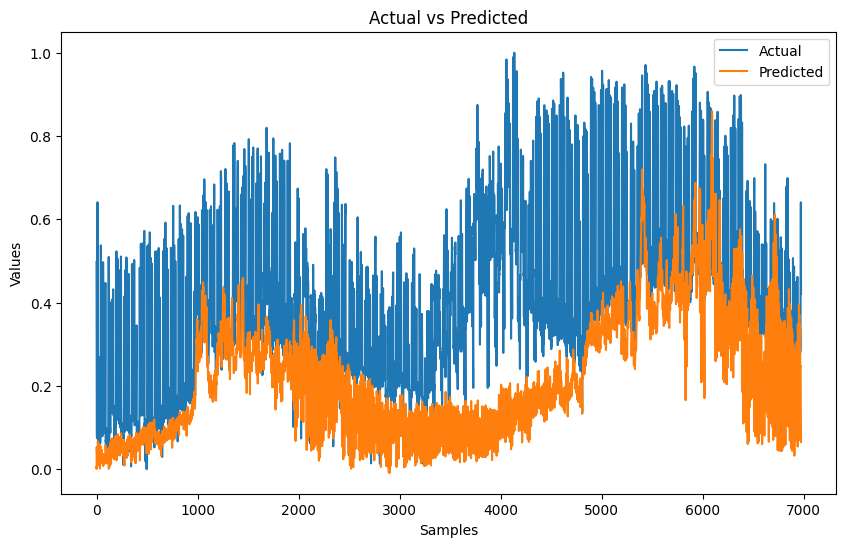

  1/218 [..............................] - ETA: 7s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 6ms/step


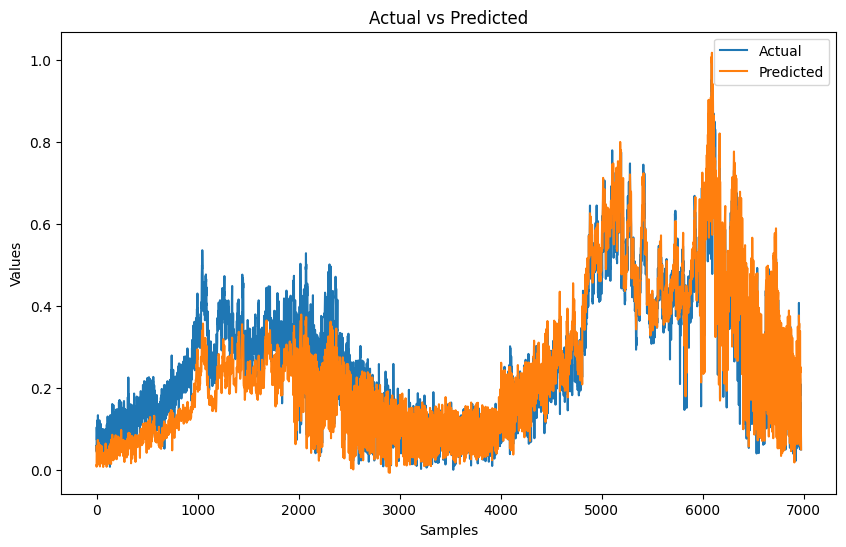

  1/218 [..............................] - ETA: 9s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 6ms/step


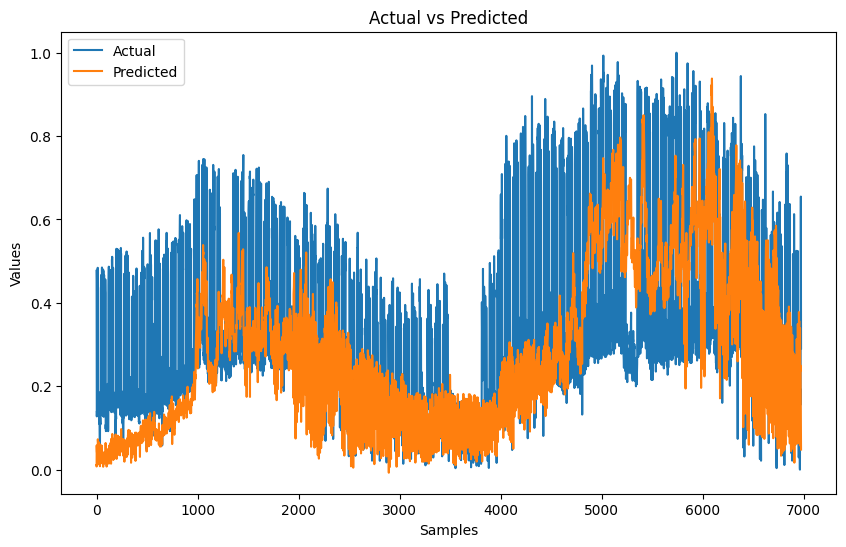

  1/218 [..............................] - ETA: 7s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


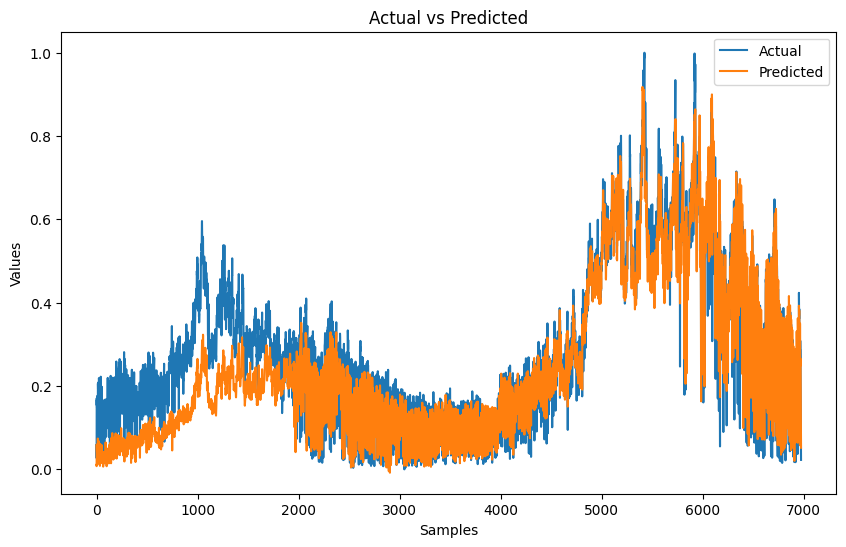

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 3s 12ms/step


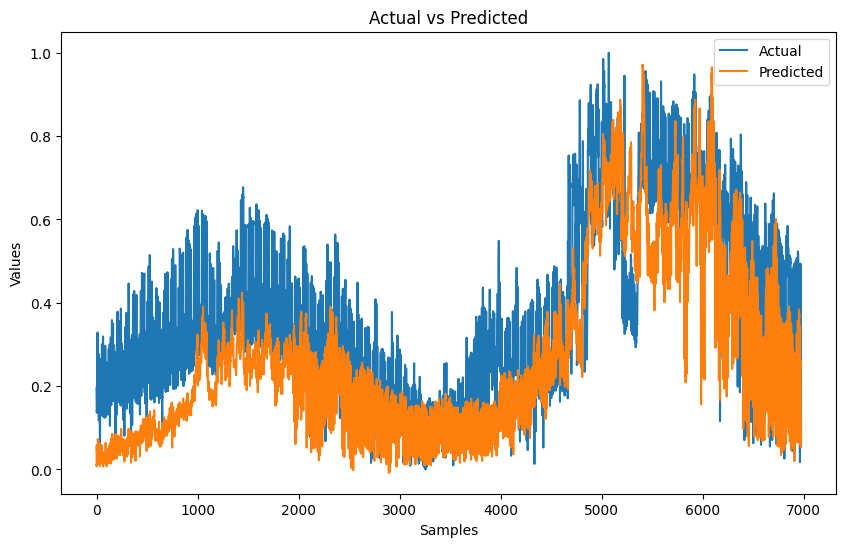

  9/218 [>.............................] - ETA: 1s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 6ms/step


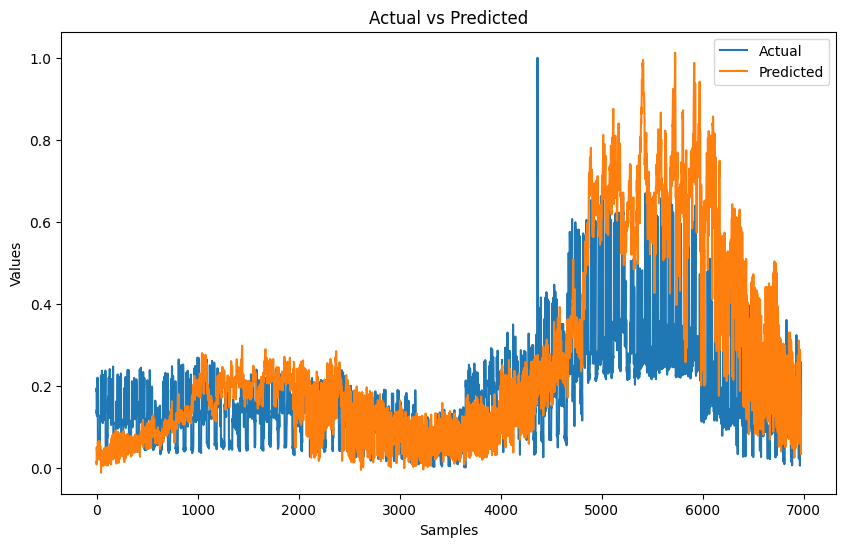

 12/218 [>.............................] - ETA: 0s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


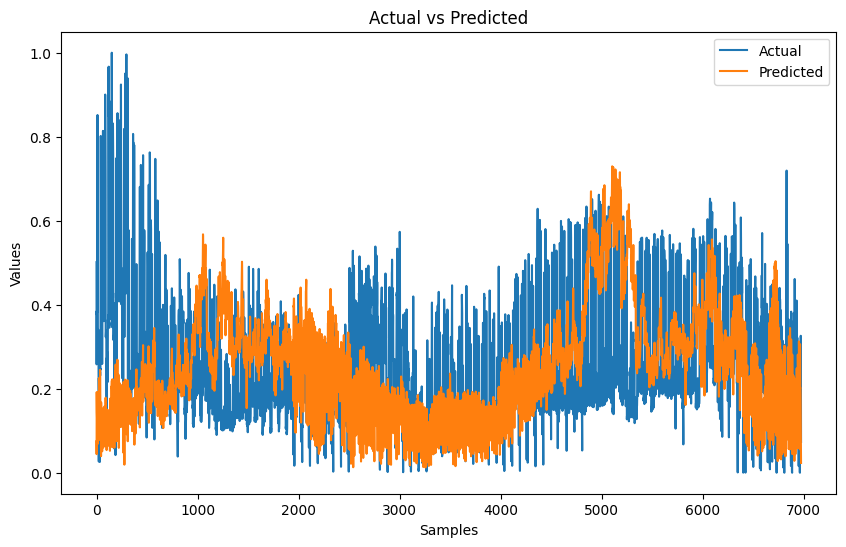

  1/218 [..............................] - ETA: 9s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


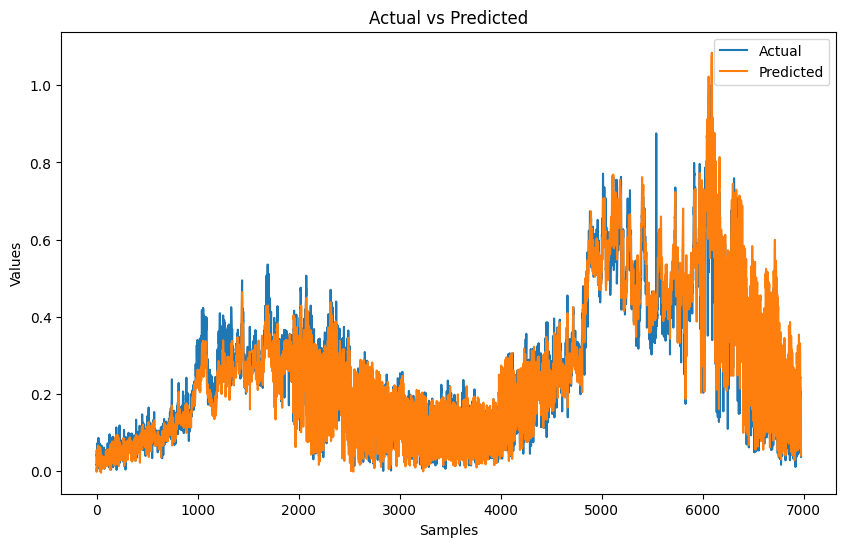

 13/218 [>.............................] - ETA: 0s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


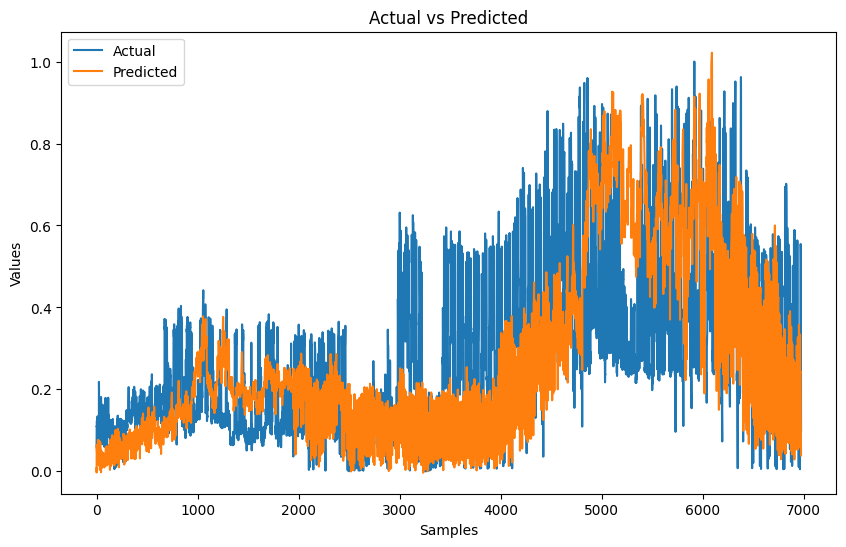

 12/218 [>.............................] - ETA: 0s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 4ms/step


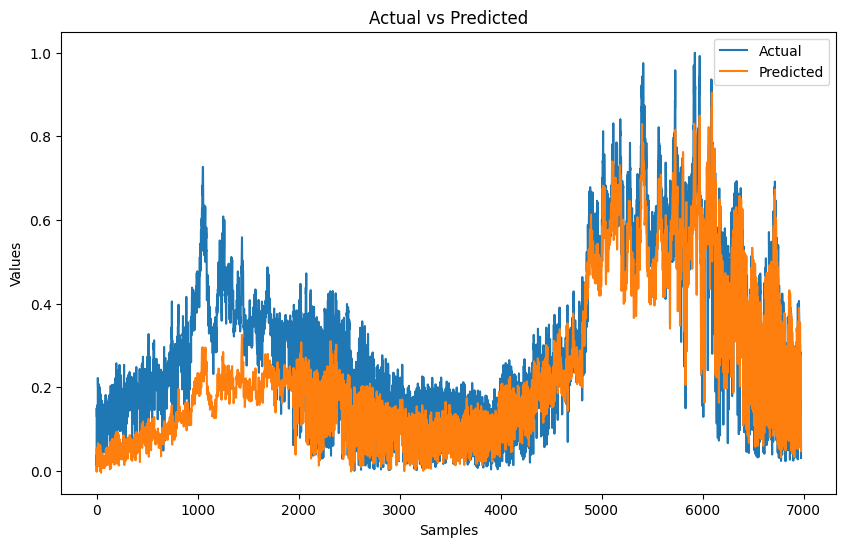

 13/218 [>.............................] - ETA: 0s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


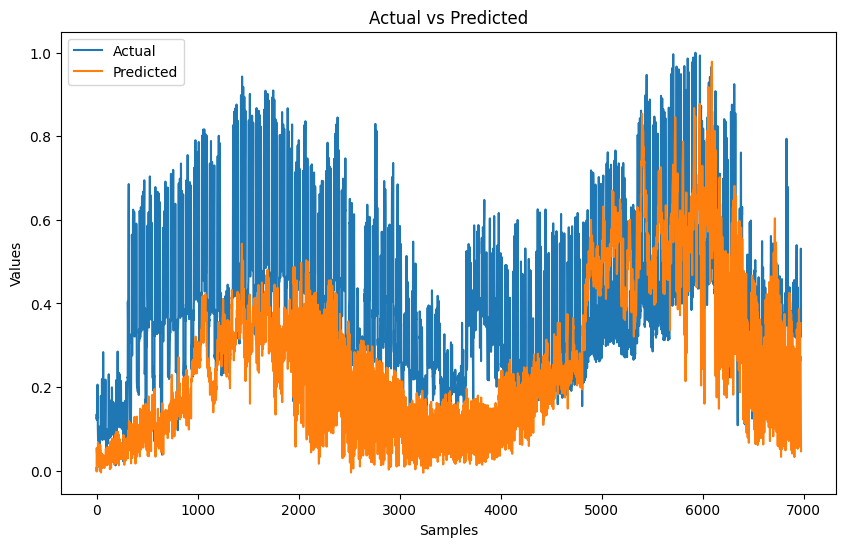

 15/218 [=>............................] - ETA: 0s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 5ms/step


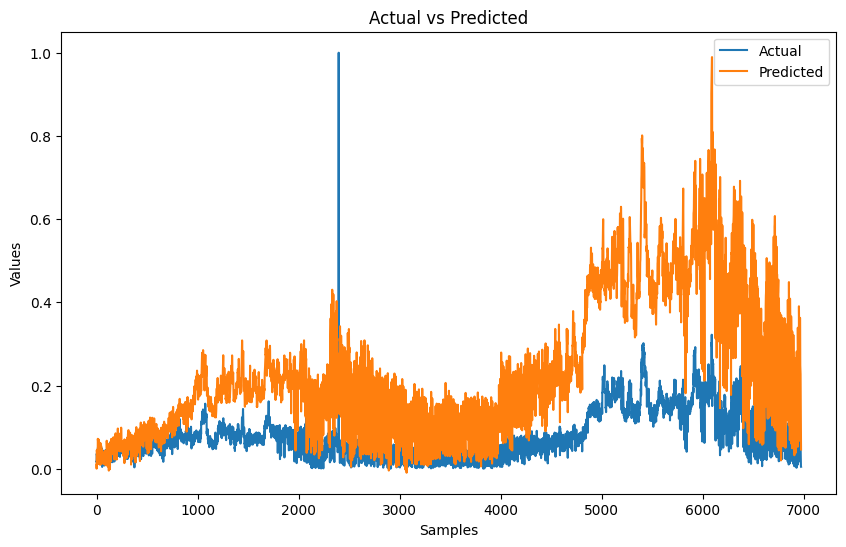

  1/218 [..............................] - ETA: 10s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 6ms/step


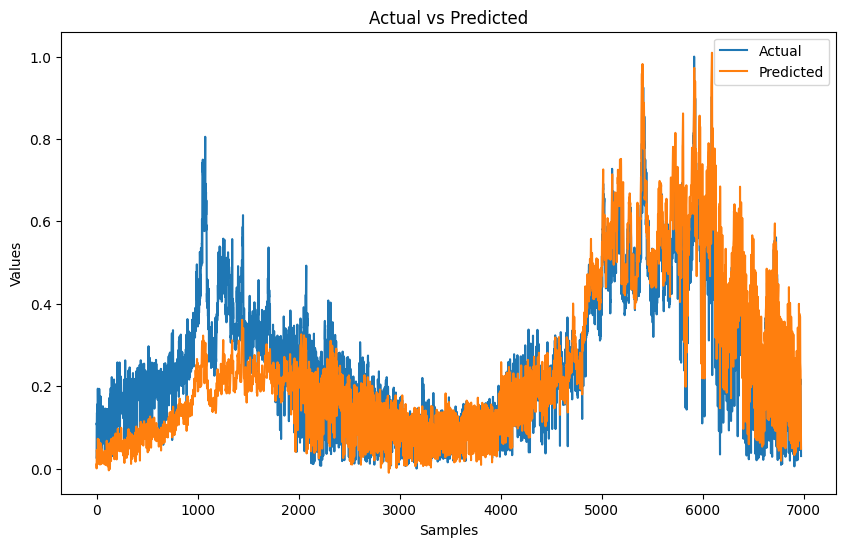

 13/218 [>.............................] - ETA: 0s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 4ms/step


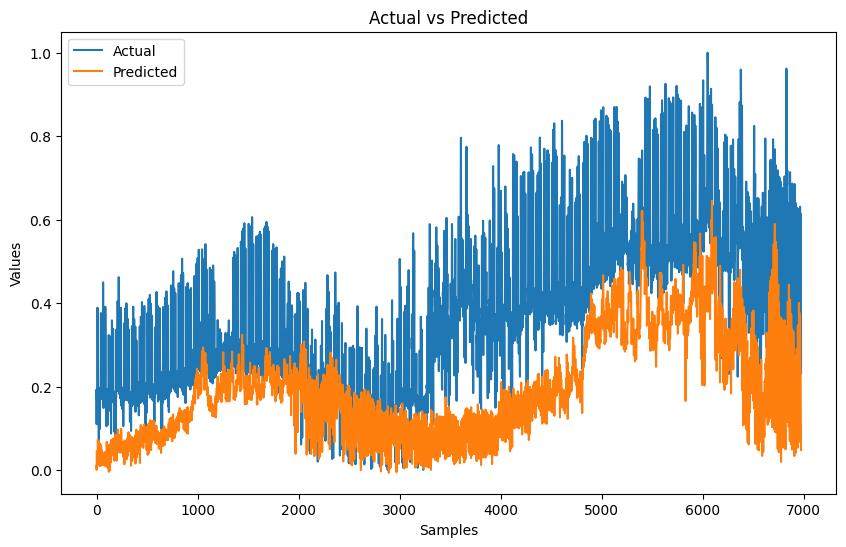

 13/218 [>.............................] - ETA: 0s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 2s 7ms/step


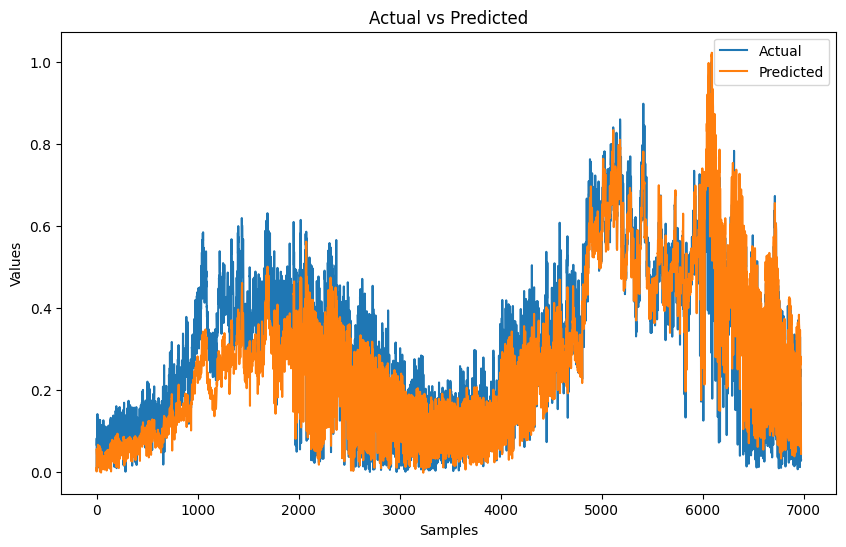

  1/218 [..............................] - ETA: 10s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 6ms/step


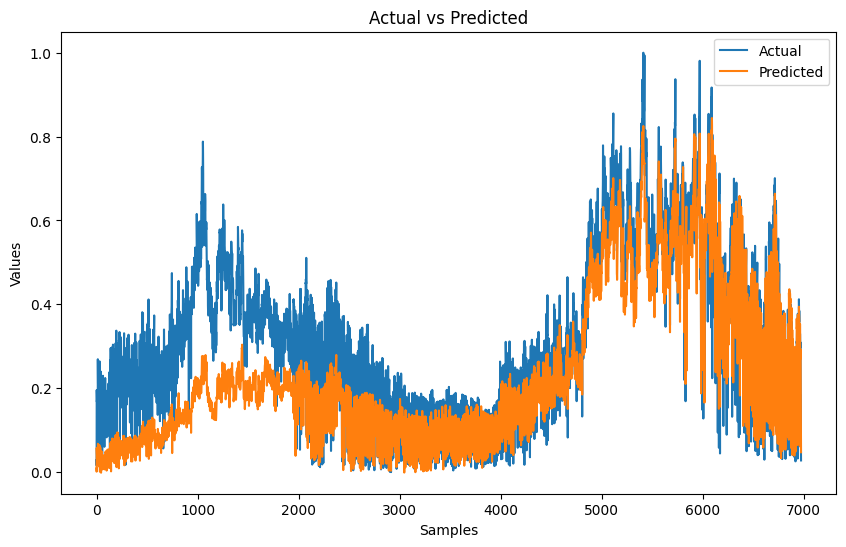

  1/218 [..............................] - ETA: 12s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 2s 8ms/step


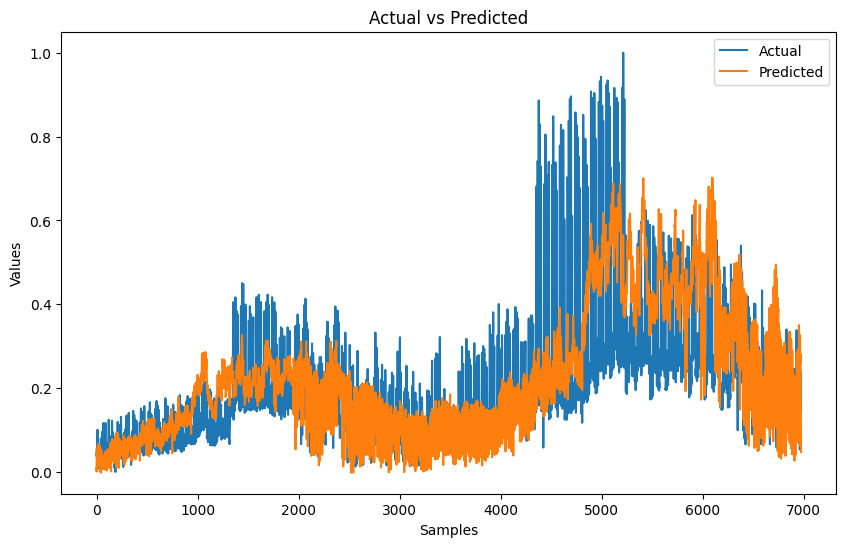

  1/218 [..............................] - ETA: 10s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 2s 9ms/step


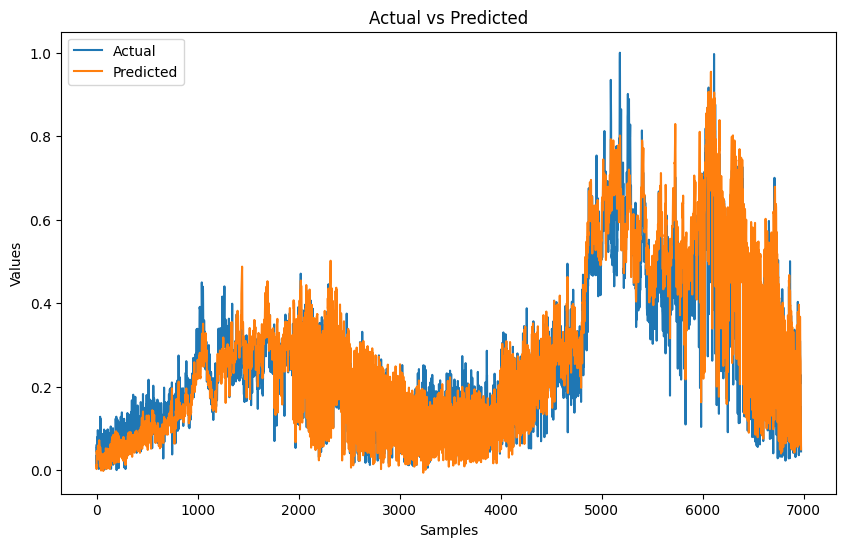

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 3s 14ms/step


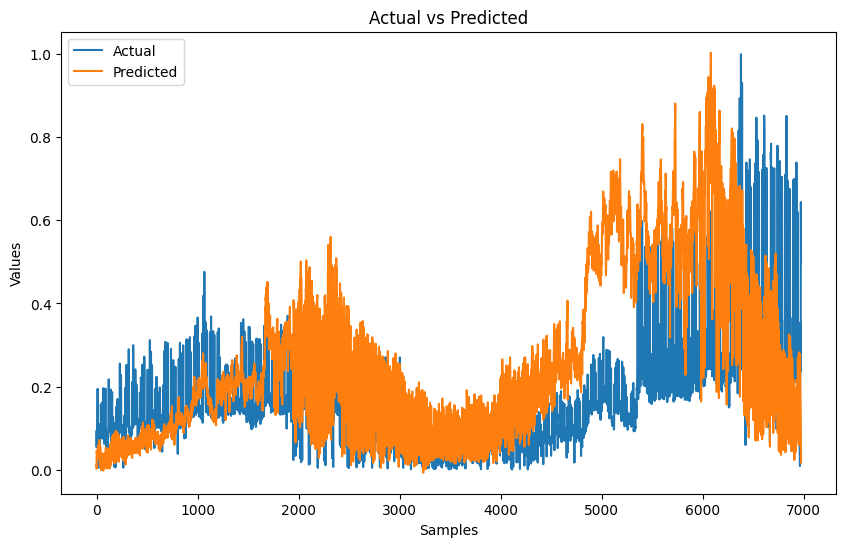

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 3s 12ms/step


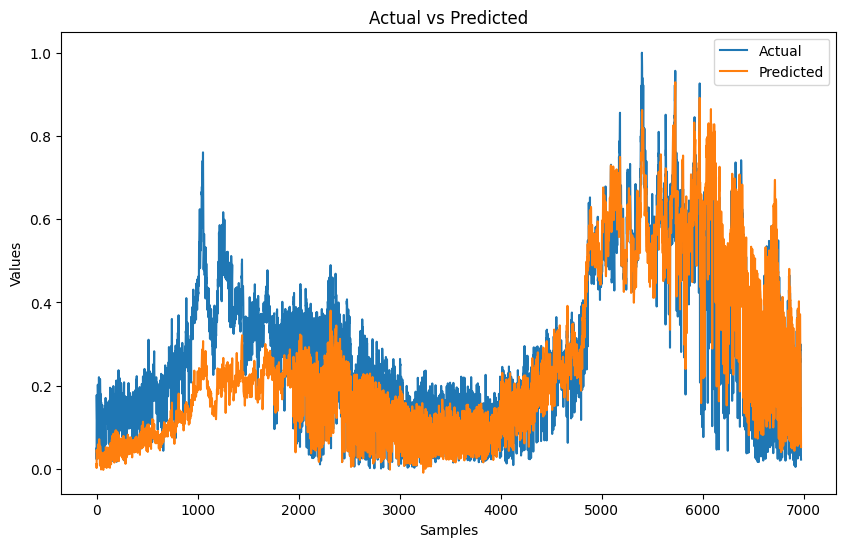

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 2s 7ms/step


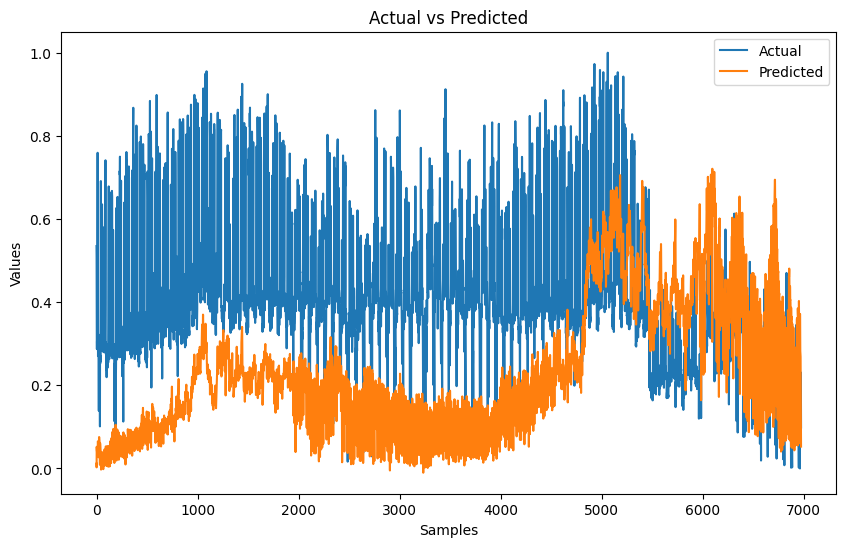

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 7ms/step


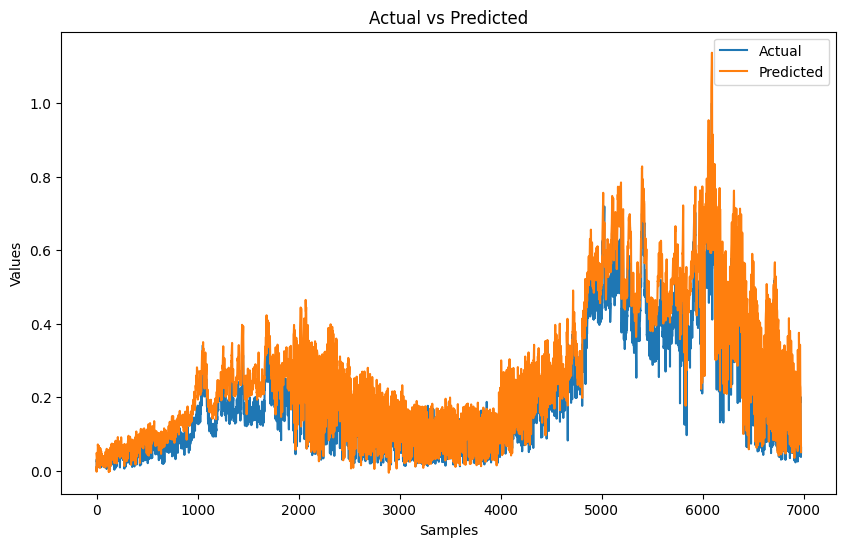

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 2s 8ms/step


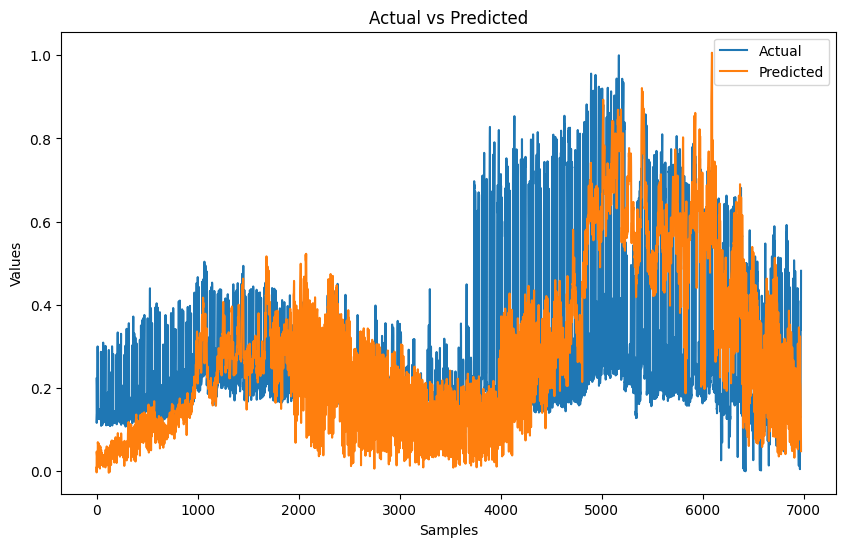

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 7ms/step


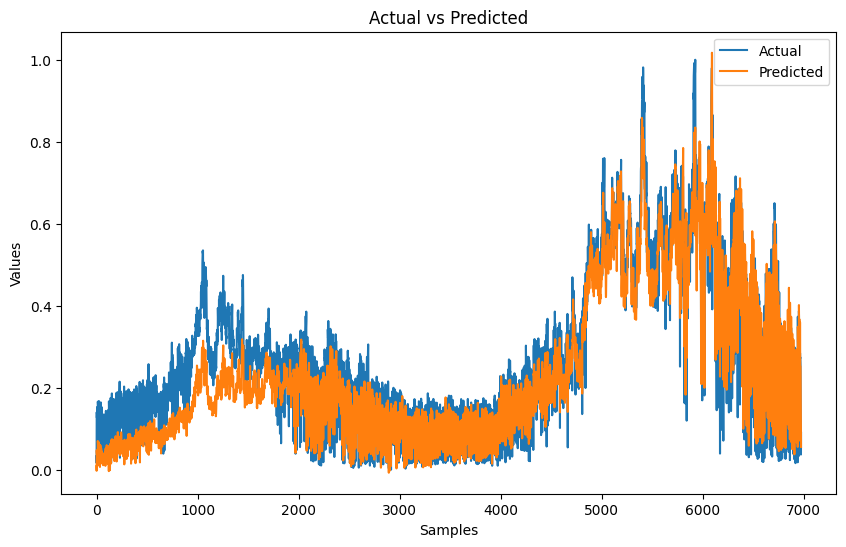

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 2s 8ms/step


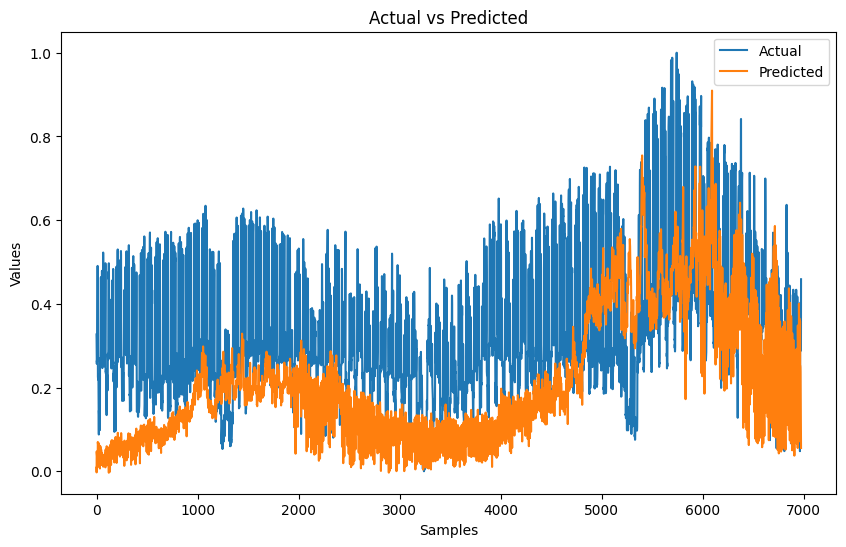

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 4s 18ms/step


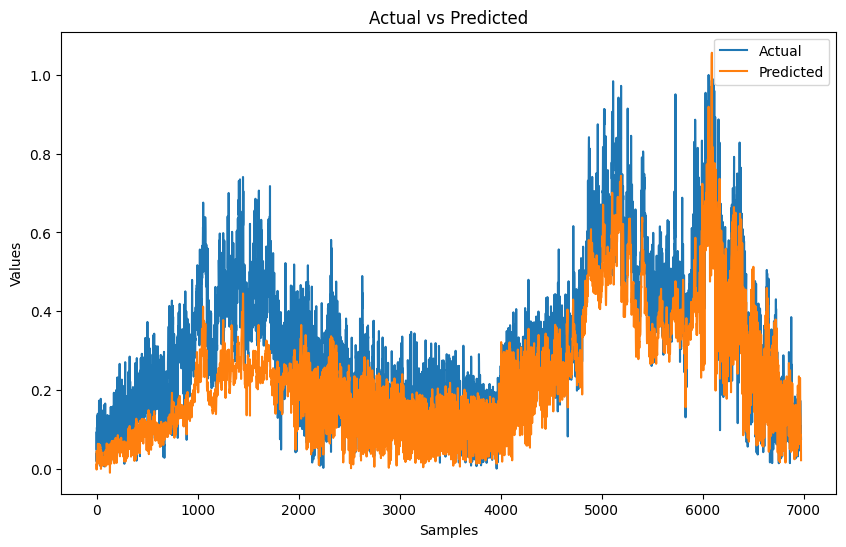

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


208/208 [==============================] - 3s 14ms/step


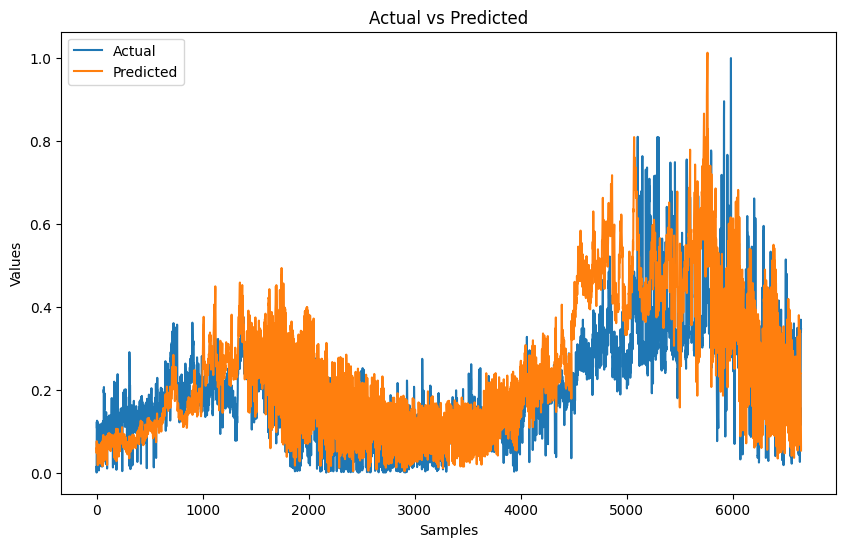

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 2s 9ms/step


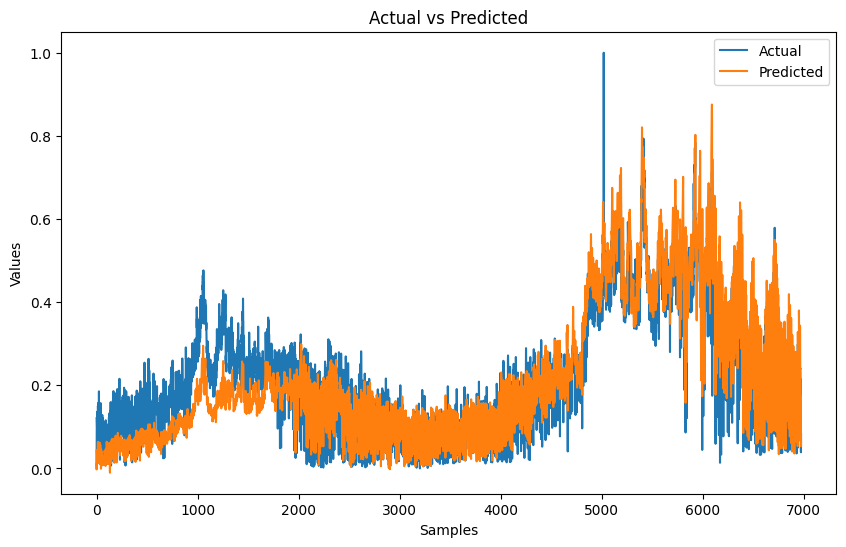

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 2s 10ms/step


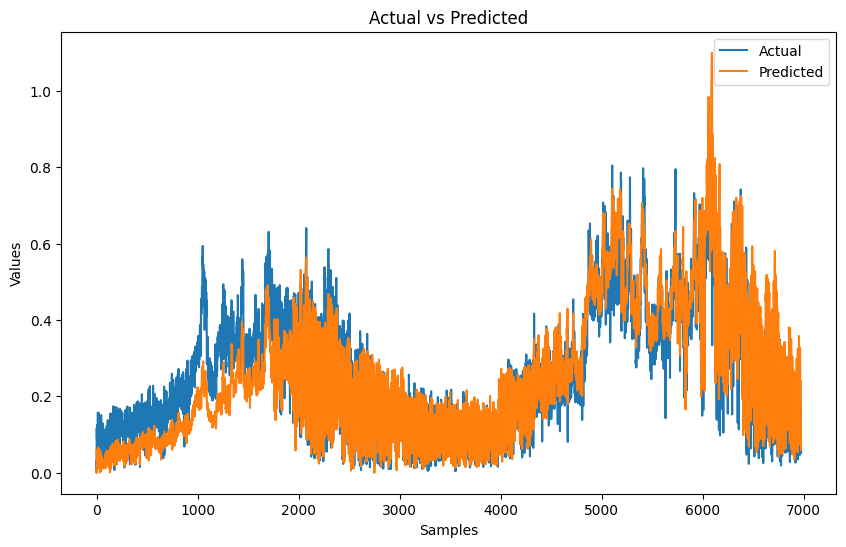

  1/218 [..............................] - ETA: 9s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 6ms/step


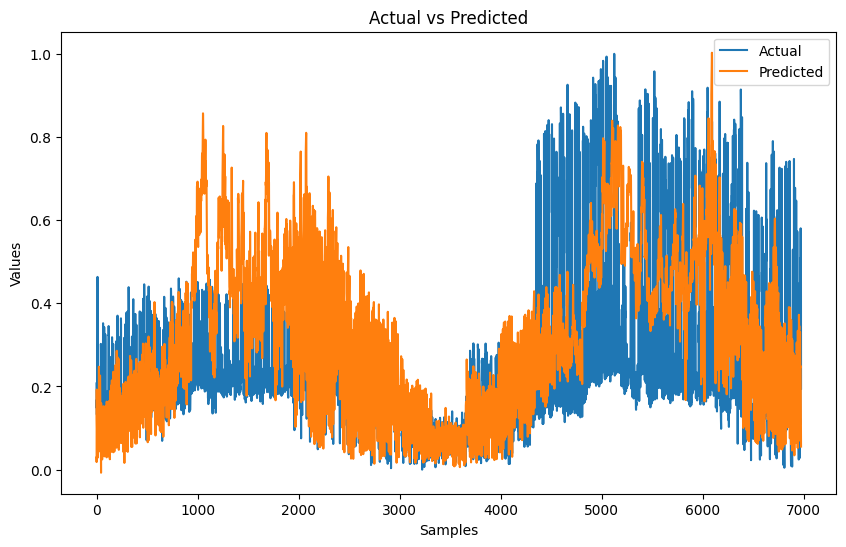

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 2s 7ms/step


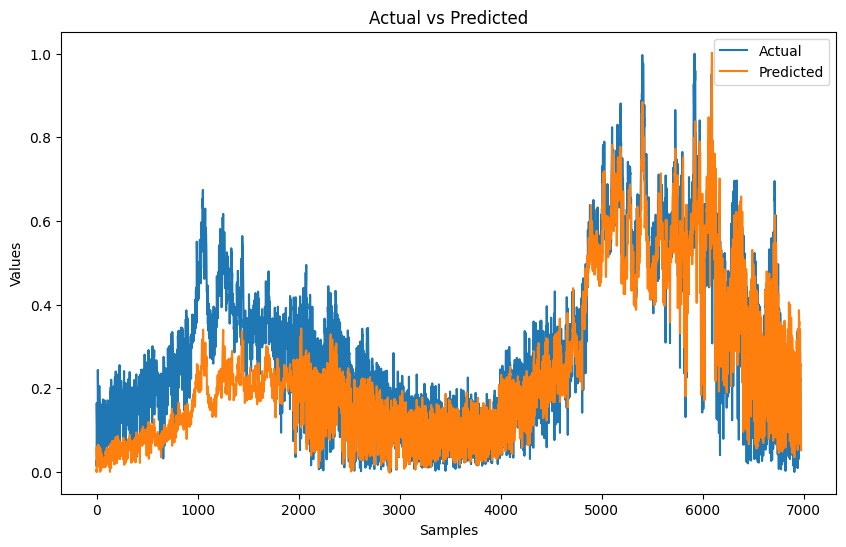

  1/218 [..............................] - ETA: 10s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 6ms/step


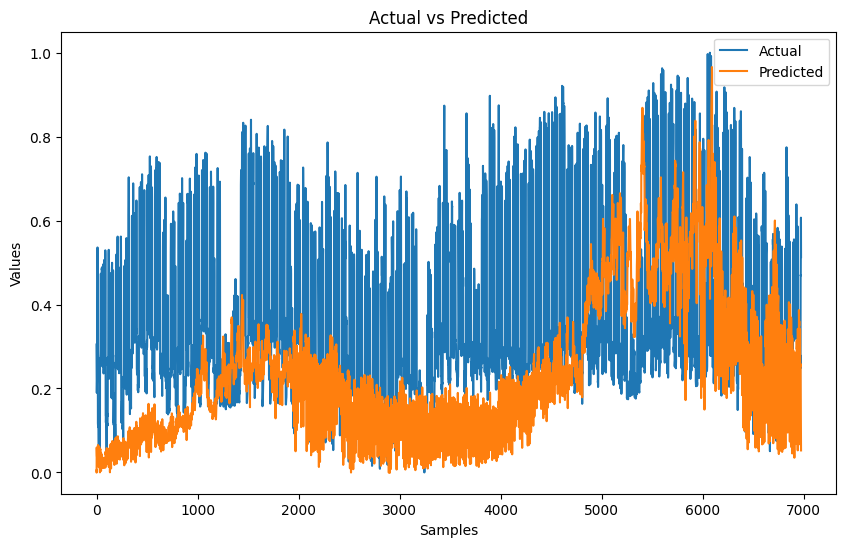

  1/187 [..............................] - ETA: 8s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


187/187 [==============================] - 2s 10ms/step


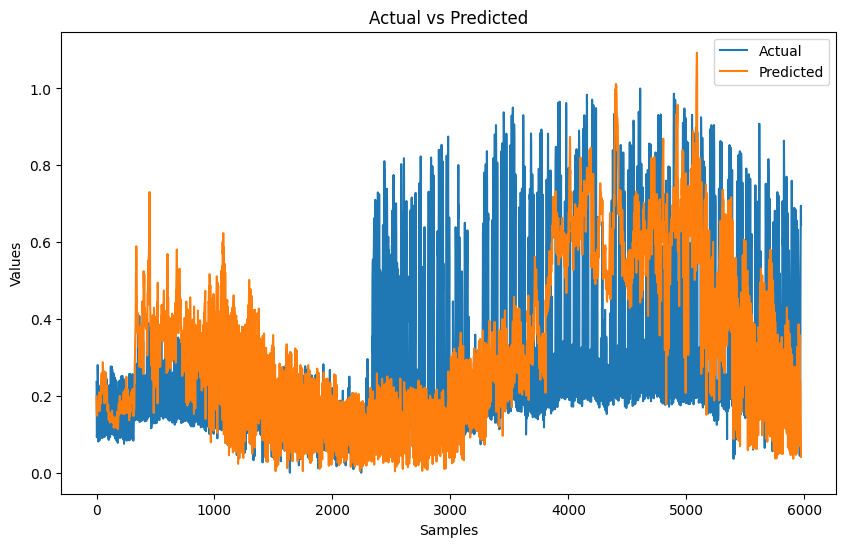

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 3s 13ms/step


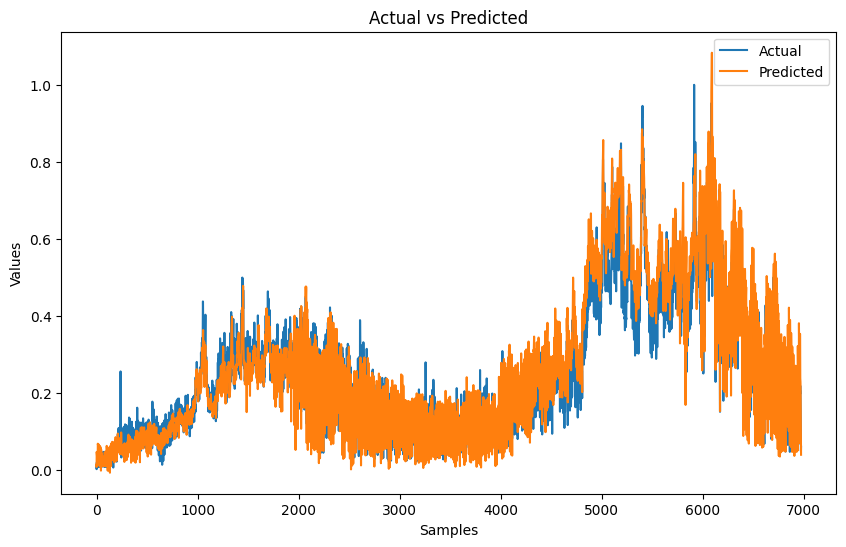

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 1s 6ms/step


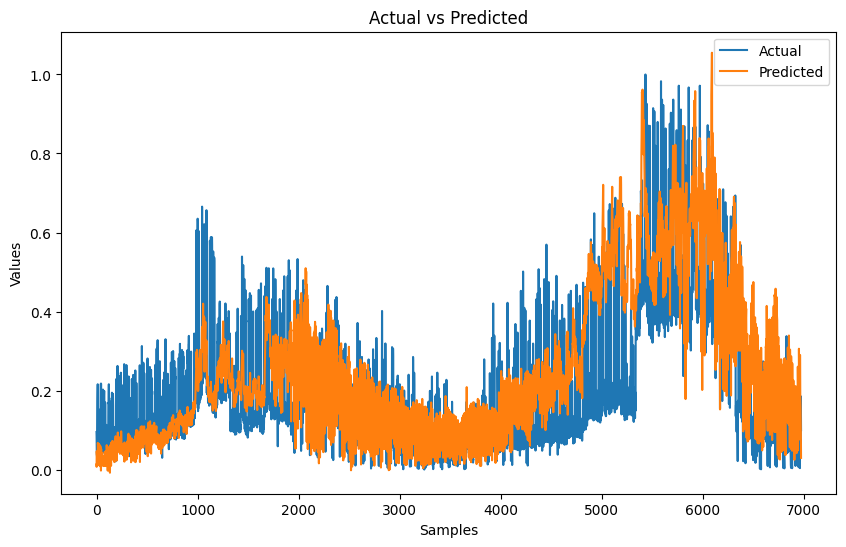

  1/218 [..............................] - ETA: 9s

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 2s 10ms/step


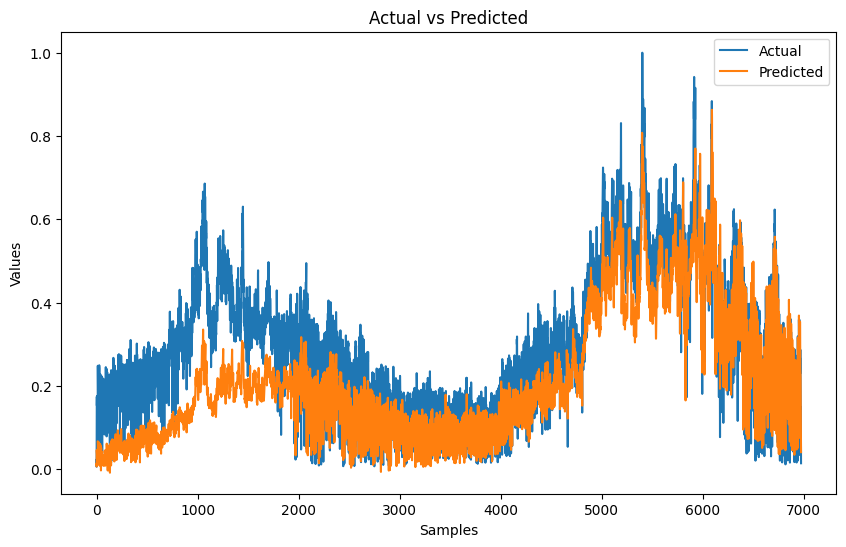

C:\Users\Ghada\AppData\Local\Temp\ipykernel_13780\1884007968.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)


218/218 [==============================] - 3s 11ms/step


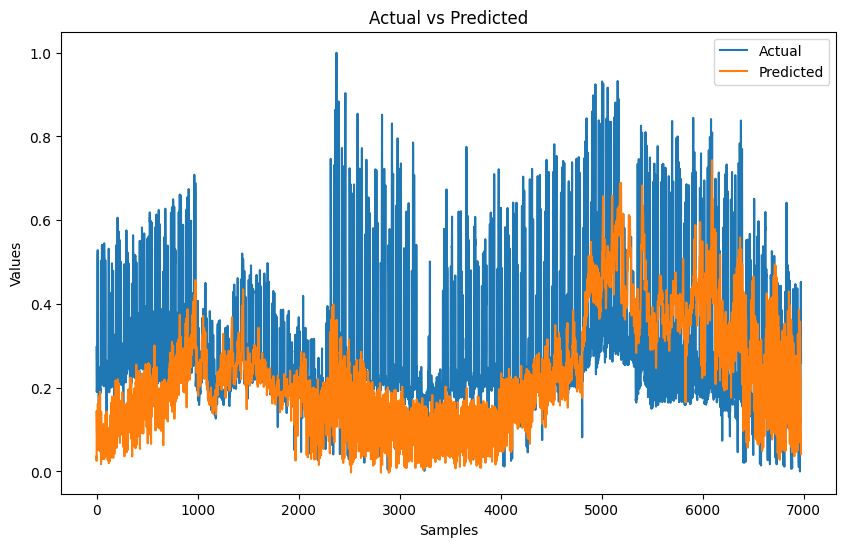

In [231]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from keras.models import load_model
import matplotlib.pyplot as plt


# Filtering for Cluster 1
cluster_data = clustering[clustering['Cluster'] == 1]

window_length = 20
num_samples = len(df_scaled) - window_length

# Initialize your scaler and model
scaler = MinMaxScaler()

# Process for each group in Cluster 2
results = []
for group, group_data in cluster_data.groupby(['county', 'product_type', 'is_business']):
    
    df = group_data
    df = df[[col for col in df.columns if col != 'target'] + ['target']]
    df.drop(columns=['datetime','Unnamed: 0','Cluster','client_id'], inplace=True)
    df.columns
   
   
    df_scaled = scaler.fit_transform(df)

# Prepare input-output pairs for training
    num_samples = len(df_scaled) - window_length

    X = np.zeros((num_samples, window_length, num_features))  # 26 features
    y = np.zeros((num_samples,))

    for i in range(num_samples):
        X[i] = df_scaled[i:i+window_length, :-1]
        y[i] = df_scaled[i+window_length, -1]  


# Reshape y to match model output shape
    y= y.reshape(-1, 1) 
    

# Make predictions on the test set
    y_pred = model.predict(X)
    
    plt.figure(figsize=(10,6))
    plt.plot(y, label='Actual')
    plt.plot(y_pred, label='Predicted')
    plt.title('Actual vs Predicted')
    plt.xlabel('Samples')
    plt.ylabel('Values')
    # Set the x-axis limits for the first 12 samples
    plt.legend()
    plt.show()


# train for the second cluster

In [232]:



df1 = grouped_data.get_group((3,1,2))

df1 = df1[[col for col in df1.columns if col != 'target'] + ['target']]
df1.drop(columns=['datetime','Unnamed: 0'], inplace=True)

Epoch 1/100
140/140 [==============================] - 7s 20ms/step - loss: 0.0355 - mse: 0.0355 - val_loss: 0.0238 - val_mse: 0.0238
Epoch 2/100
140/140 [==============================] - 2s 12ms/step - loss: 0.0206 - mse: 0.0206 - val_loss: 0.0197 - val_mse: 0.0197
Epoch 3/100
140/140 [==============================] - 2s 15ms/step - loss: 0.0180 - mse: 0.0180 - val_loss: 0.0190 - val_mse: 0.0190
Epoch 4/100
140/140 [==============================] - 2s 13ms/step - loss: 0.0159 - mse: 0.0159 - val_loss: 0.0175 - val_mse: 0.0175
Epoch 5/100
140/140 [==============================] - 2s 12ms/step - loss: 0.0149 - mse: 0.0149 - val_loss: 0.0146 - val_mse: 0.0146
Epoch 6/100
140/140 [==============================] - 2s 12ms/step - loss: 0.0128 - mse: 0.0128 - val_loss: 0.0136 - val_mse: 0.0136
Epoch 7/100
140/140 [==============================] - 2s 12ms/step - loss: 0.0127 - mse: 0.0127 - val_loss: 0.0151 - val_mse: 0.0151
Epoch 8/100
140/140 [==============================] - 2s 12ms

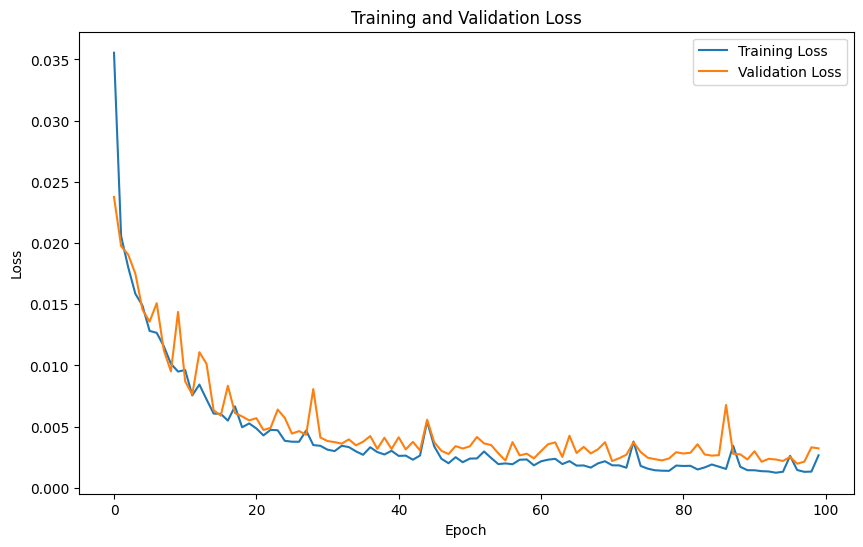

In [233]:
df_scaled1 = scaler.fit_transform(df1)

# Prepare input-output pairs for training
num_samples = len(df_scaled1) - window_length

X = np.zeros((num_samples, window_length, num_features))  # 26 features
y = np.zeros((num_samples,))

for i in range(num_samples):
    X[i] = df_scaled1[i:i+window_length, :-1]
    y[i] = df_scaled1[i+window_length, -1]  

# Split data into training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Reshape y to match model output shape
y_train = y_train.reshape(-1, 1)  # Reshape y_train to (num_samples, 1)

# Create and compile model
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])

# Train model
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

44/44 [==============================] - 1s 10ms/step
R² Score: 0.9246994125118171
Mean Absolute Error (MAE): 0.031326574400251786
Mean Squared Error (MSE): 0.0040366137684864425


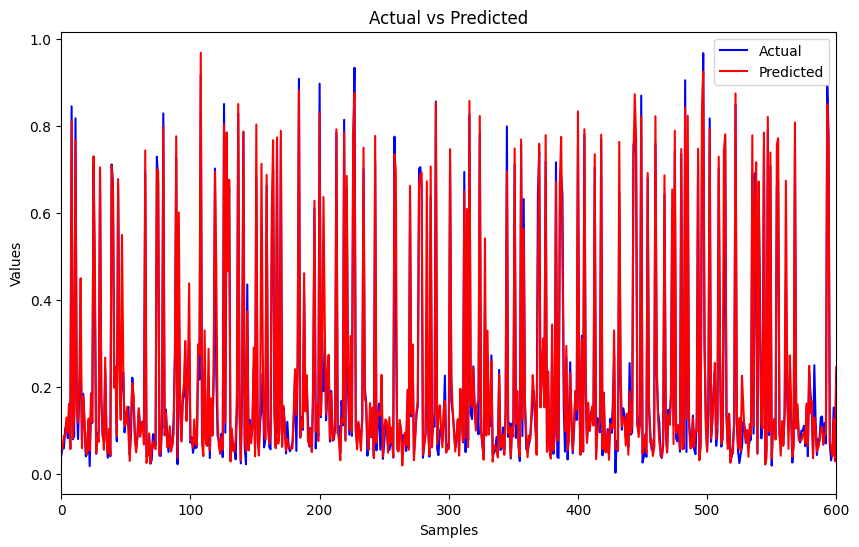

In [235]:
# Assuming y_test and y_pred are already defined and available

from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
y_pred = model.predict(X_test)
# Calculate R² score
r2 = r2_score(y_test, y_pred)
print(f"R² Score: {r2}")

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(y_test, y_pred)
print(f"Mean Absolute Error (MAE): {mae}")

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error (MSE): {mse}")

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test, label='Actual', color='blue')
plt.plot(y_pred, label='Predicted', color='red')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(0, 600)  # Set the x-axis limits for the first 110 samples
plt.legend()
plt.show()

# Cluster 3

In [236]:
df2 = grouped_data.get_group((3,1,13))

df2 = df2[[col for col in df2.columns if col != 'target'] + ['target']]
df2.drop(columns=['datetime','Unnamed: 0'], inplace=True)

Epoch 1/100
140/140 [==============================] - 6s 17ms/step - loss: 0.0232 - mse: 0.0232 - val_loss: 0.0119 - val_mse: 0.0119
Epoch 2/100
140/140 [==============================] - 1s 11ms/step - loss: 0.0099 - mse: 0.0099 - val_loss: 0.0077 - val_mse: 0.0077
Epoch 3/100
140/140 [==============================] - 1s 10ms/step - loss: 0.0074 - mse: 0.0074 - val_loss: 0.0054 - val_mse: 0.0054
Epoch 4/100
140/140 [==============================] - 1s 9ms/step - loss: 0.0062 - mse: 0.0062 - val_loss: 0.0048 - val_mse: 0.0048
Epoch 5/100
140/140 [==============================] - 1s 10ms/step - loss: 0.0051 - mse: 0.0051 - val_loss: 0.0045 - val_mse: 0.0045
Epoch 6/100
140/140 [==============================] - 2s 18ms/step - loss: 0.0043 - mse: 0.0043 - val_loss: 0.0037 - val_mse: 0.0037
Epoch 7/100
140/140 [==============================] - 2s 16ms/step - loss: 0.0042 - mse: 0.0042 - val_loss: 0.0037 - val_mse: 0.0037
Epoch 8/100
140/140 [==============================] - 2s 12ms/

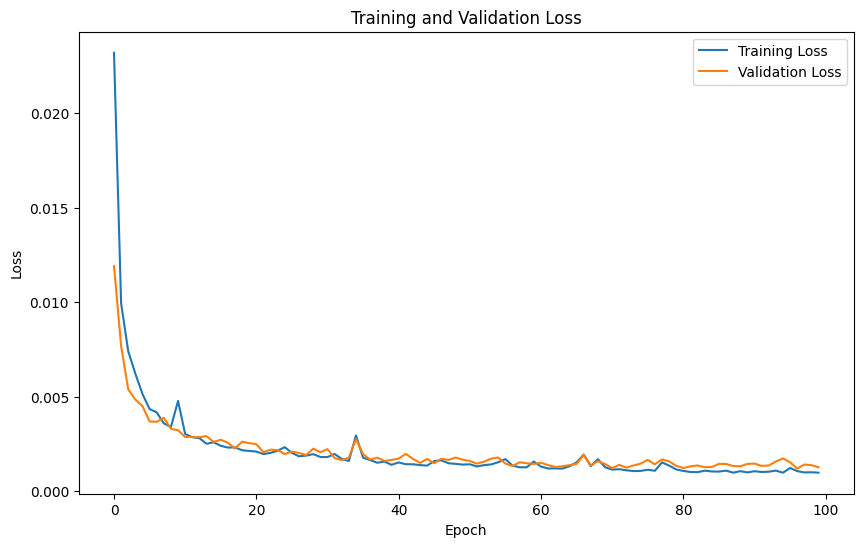

In [237]:
df_scaled2 = scaler.fit_transform(df2)

# Prepare input-output pairs for training
num_samples = len(df_scaled2) - window_length

X = np.zeros((num_samples, window_length, num_features))  # 26 features
y = np.zeros((num_samples,))

for i in range(num_samples):
    X[i] = df_scaled2[i:i+window_length, :-1]
    y[i] = df_scaled2[i+window_length, -1]  

# Split data into training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Reshape y to match model output shape
y_train = y_train.reshape(-1, 1)  # Reshape y_train to (num_samples, 1)

# Create and compile model
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])

# Train model
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

44/44 [==============================] - 0s 6ms/step
R² Score: 0.9722546885079492
Mean Absolute Error (MAE): 0.02415044486964208
Mean Squared Error (MSE): 0.0013918964982394333


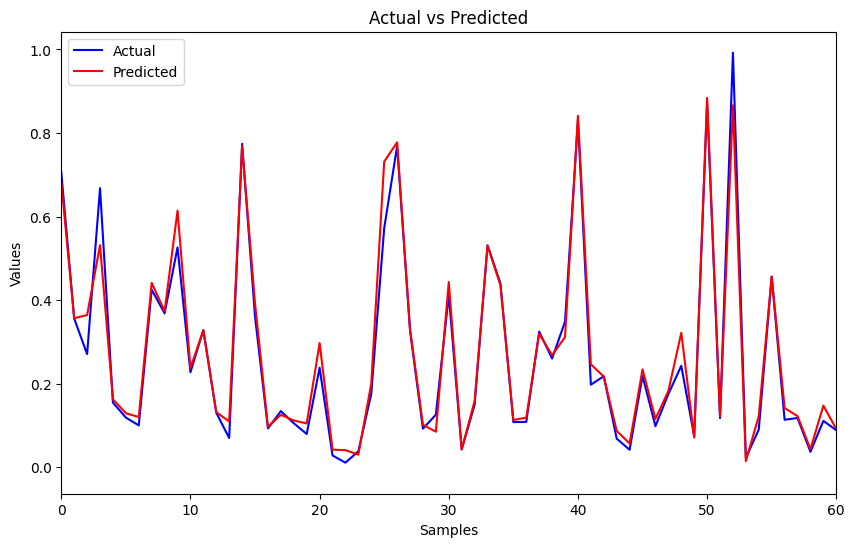

In [242]:
y_pred = model.predict(X_test)
# Calculate R² score
r2 = r2_score(y_test, y_pred)
print(f"R² Score: {r2}")

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(y_test, y_pred)
print(f"Mean Absolute Error (MAE): {mae}")

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error (MSE): {mse}")

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test, label='Actual', color='blue')
plt.plot(y_pred, label='Predicted', color='red')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(0, 60)  # Set the x-axis limits for the first 110 samples
plt.legend()
plt.show()

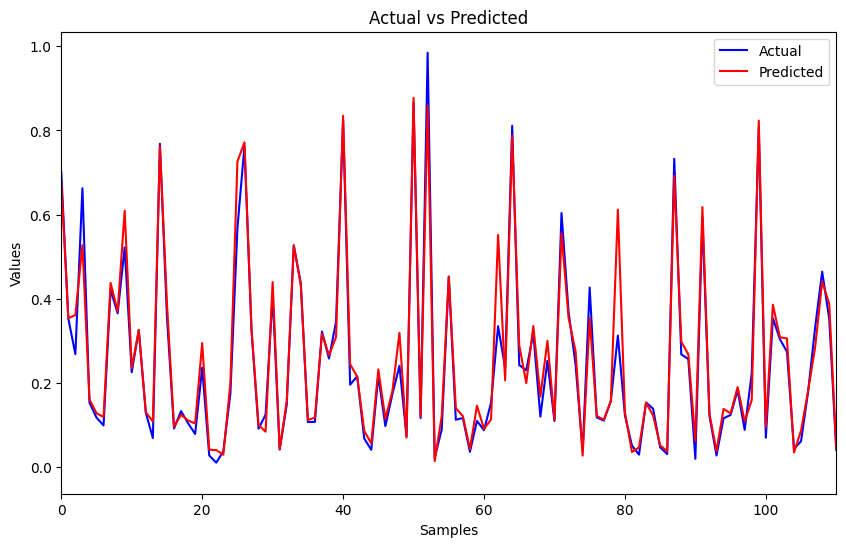

In [253]:
y_test = y_test.reshape(-1, 1)
target_scaler = MinMaxScaler()
target_scaler.fit(y_test)




# Reshape y_test to match the expected shape by scaler


# Inverse transform y_test and y_pred back to original scale
y_test_actual = target_scaler.inverse_transform(y_test)
y_pred_actual = target_scaler.inverse_transform(y_pred)

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test_actual, label='Actual', color='blue')
plt.plot(y_pred_actual, label='Predicted', color='red')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(0, 110)  # Set the x-axis limits for the first 110 samples
plt.legend()
plt.show()


In [245]:
y_test.shape 

(1395,)

# Cluster 4

In [256]:
df3 = grouped_data.get_group((0,1,5))

df3 = df3[[col for col in df3.columns if col != 'target'] + ['target']]
df3.drop(columns=['datetime','Unnamed: 0'], inplace=True)

Epoch 1/100
133/133 [==============================] - 8s 22ms/step - loss: 0.0340 - mse: 0.0340 - val_loss: 0.0173 - val_mse: 0.0173
Epoch 2/100
133/133 [==============================] - 1s 11ms/step - loss: 0.0142 - mse: 0.0142 - val_loss: 0.0093 - val_mse: 0.0093
Epoch 3/100
133/133 [==============================] - 1s 11ms/step - loss: 0.0090 - mse: 0.0090 - val_loss: 0.0075 - val_mse: 0.0075
Epoch 4/100
133/133 [==============================] - 1s 10ms/step - loss: 0.0091 - mse: 0.0091 - val_loss: 0.0093 - val_mse: 0.0093
Epoch 5/100
133/133 [==============================] - 1s 11ms/step - loss: 0.0068 - mse: 0.0068 - val_loss: 0.0061 - val_mse: 0.0061
Epoch 6/100
133/133 [==============================] - 1s 10ms/step - loss: 0.0059 - mse: 0.0059 - val_loss: 0.0066 - val_mse: 0.0066
Epoch 7/100
133/133 [==============================] - 1s 10ms/step - loss: 0.0062 - mse: 0.0062 - val_loss: 0.0051 - val_mse: 0.0051
Epoch 8/100
133/133 [==============================] - 1s 10ms

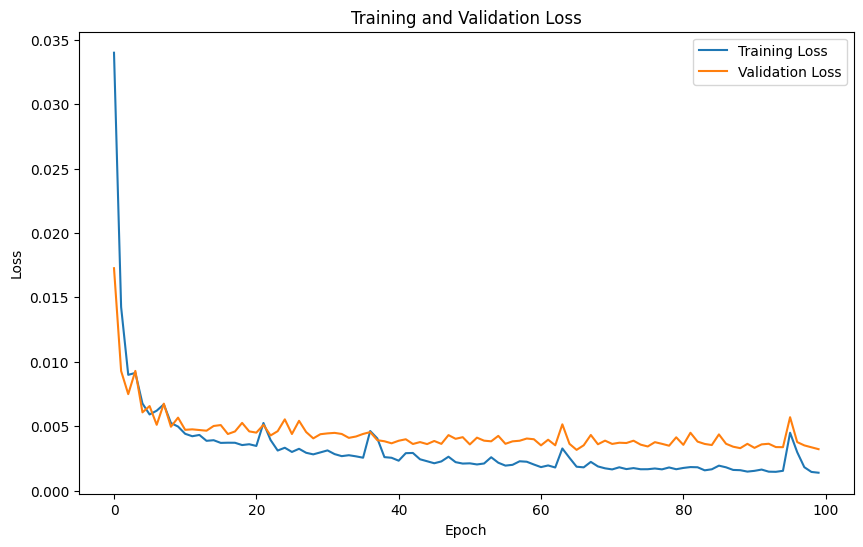

In [261]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt

# Assuming df3 is your DataFrame and it has been properly scaled already
scaler1 = MinMaxScaler()
scaler2 = MinMaxScaler()

# Prepare input-output pairs for training
num_samples = len(df3) - window_length
num_features = df3.shape[1] - 1  # Assuming the last column is the target variable

X = np.zeros((num_samples, window_length, num_features))  # 26 features
y = np.zeros((num_samples,))

for i in range(num_samples):
    X[i] = df3.iloc[i:i+window_length, :-1].values
    y[i] = df3.iloc[i+window_length, -1]

# Reshape X to 2D array for scaling
X_reshaped = X.reshape(-1, num_features)
X_scaled = scaler2.fit_transform(X_reshaped)
X = X_scaled.reshape(num_samples, window_length, num_features)

# Scale y
y = y.reshape(-1, 1)  # Reshape y to 2D array for scaling
y = scaler1.fit_transform(y).flatten()

# Split data into training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and compile model (assuming `model` is already defined)
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])

# Train model
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


42/42 [==============================] - 11s 17ms/step
R² Score: 0.9609282137937336
Mean Absolute Error (MAE): 0.03481493812339434
Mean Squared Error (MSE): 0.003936054439898763


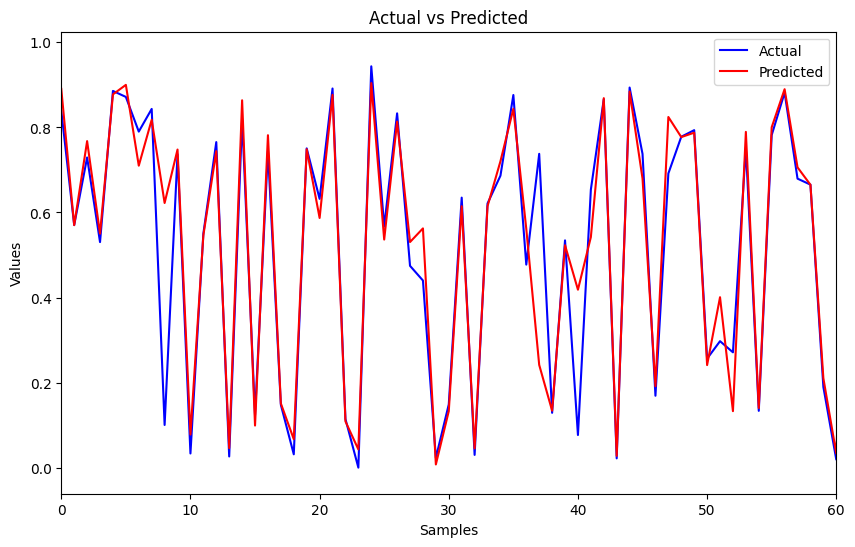

In [262]:
y_pred = model.predict(X_test)
# Calculate R² score
r2 = r2_score(y_test, y_pred)
print(f"R² Score: {r2}")

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(y_test, y_pred)
print(f"Mean Absolute Error (MAE): {mae}")

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error (MSE): {mse}")

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test, label='Actual', color='blue')
plt.plot(y_pred, label='Predicted', color='red')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(0, 60)  # Set the x-axis limits for the first 110 samples
plt.legend()
plt.show()

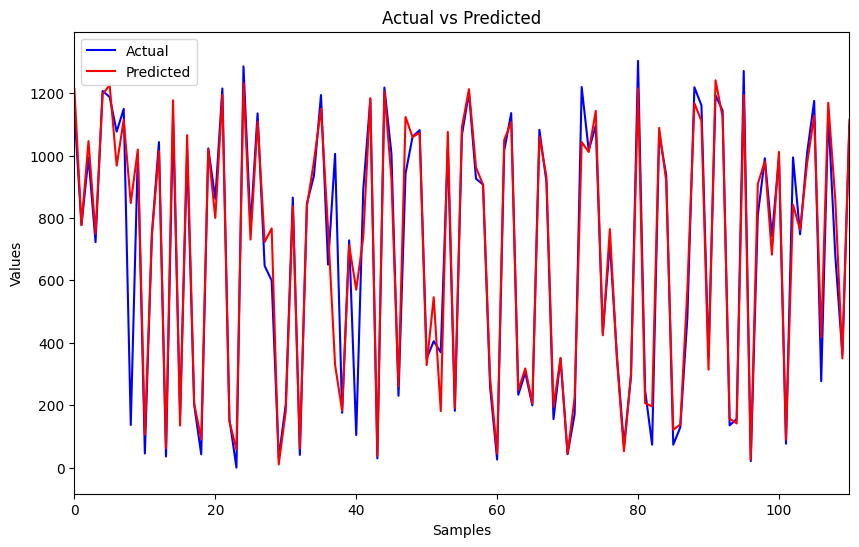

In [264]:


y_test = np.reshape(y_test, (-1, 1))

# Reshape y_test to match the expected shape by scaler


# Inverse transform y_test and y_pred back to original scale
y_test_actual = scaler1.inverse_transform(y_test)
y_pred_actual = scaler1.inverse_transform(y_pred)

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test_actual, label='Actual', color='blue')
plt.plot(y_pred_actual, label='Predicted', color='red')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(0, 110)  # Set the x-axis limits for the first 110 samples
plt.legend()
plt.show()

# Cluster 5

In [267]:
df4 = grouped_data.get_group((1,1,3))

df4 = df4[[col for col in df4.columns if col != 'target'] + ['target']]
df4.drop(columns=['datetime','Unnamed: 0'], inplace=True)

In [271]:
df4.shape

(6994, 27)

Epoch 1/100
140/140 [==============================] - 8s 26ms/step - loss: 0.0095 - mse: 0.0095 - val_loss: 0.0042 - val_mse: 0.0042
Epoch 2/100
140/140 [==============================] - 3s 22ms/step - loss: 0.0041 - mse: 0.0041 - val_loss: 0.0031 - val_mse: 0.0031
Epoch 3/100
140/140 [==============================] - 3s 20ms/step - loss: 0.0031 - mse: 0.0031 - val_loss: 0.0029 - val_mse: 0.0029
Epoch 4/100
140/140 [==============================] - 2s 13ms/step - loss: 0.0027 - mse: 0.0027 - val_loss: 0.0027 - val_mse: 0.0027
Epoch 5/100
140/140 [==============================] - 2s 15ms/step - loss: 0.0026 - mse: 0.0026 - val_loss: 0.0024 - val_mse: 0.0024
Epoch 6/100
140/140 [==============================] - 2s 15ms/step - loss: 0.0023 - mse: 0.0023 - val_loss: 0.0024 - val_mse: 0.0024
Epoch 7/100
140/140 [==============================] - 2s 15ms/step - loss: 0.0022 - mse: 0.0022 - val_loss: 0.0022 - val_mse: 0.0022
Epoch 8/100
140/140 [==============================] - 2s 14ms

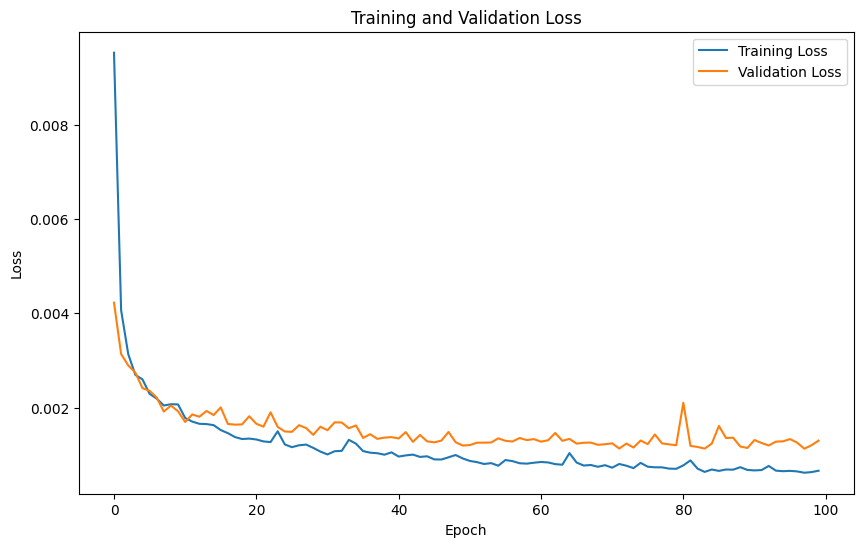

In [268]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt

# Assuming df3 is your DataFrame and it has been properly scaled already
scaler1 = MinMaxScaler()
scaler2 = MinMaxScaler()

# Prepare input-output pairs for training
num_samples = len(df4) - window_length
num_features = df4.shape[1] - 1  # Assuming the last column is the target variable

X = np.zeros((num_samples, window_length, num_features))  # 26 features
y = np.zeros((num_samples,))

for i in range(num_samples):
    X[i] = df4.iloc[i:i+window_length, :-1].values
    y[i] = df4.iloc[i+window_length, -1]

# Reshape X to 2D array for scaling
X_reshaped = X.reshape(-1, num_features)
X_scaled = scaler2.fit_transform(X_reshaped)
X = X_scaled.reshape(num_samples, window_length, num_features)

# Scale y
y = y.reshape(-1, 1)  # Reshape y to 2D array for scaling
y = scaler1.fit_transform(y).flatten()

# Split data into training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and compile model (assuming `model` is already defined)
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])

# Train model
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

44/44 [==============================] - 2s 6ms/step
R² Score: 0.9607047548271155
Mean Absolute Error (MAE): 0.026036469422585022
Mean Squared Error (MSE): 0.001429378460535182


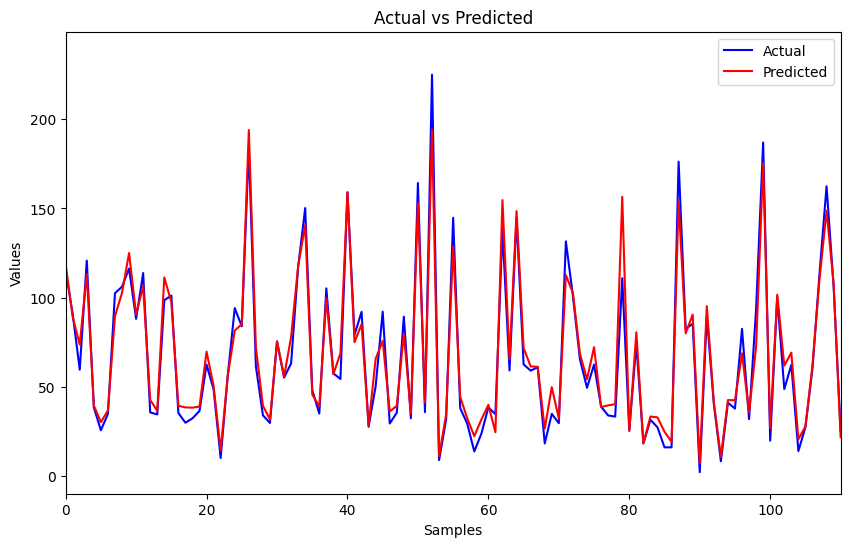

In [269]:

y_pred = model.predict(X_test)
# Calculate R² score
r2 = r2_score(y_test, y_pred)
print(f"R² Score: {r2}")

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(y_test, y_pred)
print(f"Mean Absolute Error (MAE): {mae}")

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error (MSE): {mse}")

y_test = np.reshape(y_test, (-1, 1))

# Reshape y_test to match the expected shape by scaler


# Inverse transform y_test and y_pred back to original scale
y_test_actual = scaler1.inverse_transform(y_test)
y_pred_actual = scaler1.inverse_transform(y_pred)

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test_actual, label='Actual', color='blue')
plt.plot(y_pred_actual, label='Predicted', color='red')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(0, 110)  # Set the x-axis limits for the first 110 samples
plt.legend()
plt.show()

In [270]:
X_test.shape

(1395, 20, 26)

# Cluster 6

In [274]:
num_features = 26
window_length = 1
hidden_dim = 64
output_dim = 1  # For predicting a single value
model = SegRNN_Sample(num_features, window_length, hidden_dim)

Epoch 1/100
140/140 [==============================] - 10s 18ms/step - loss: 0.0230 - mse: 0.0230 - val_loss: 0.0098 - val_mse: 0.0098
Epoch 2/100
140/140 [==============================] - 2s 16ms/step - loss: 0.0107 - mse: 0.0107 - val_loss: 0.0096 - val_mse: 0.0096
Epoch 3/100
140/140 [==============================] - 3s 22ms/step - loss: 0.0093 - mse: 0.0093 - val_loss: 0.0086 - val_mse: 0.0086
Epoch 4/100
140/140 [==============================] - 2s 12ms/step - loss: 0.0083 - mse: 0.0083 - val_loss: 0.0070 - val_mse: 0.0070
Epoch 5/100
140/140 [==============================] - 2s 13ms/step - loss: 0.0079 - mse: 0.0079 - val_loss: 0.0072 - val_mse: 0.0072
Epoch 6/100
140/140 [==============================] - 2s 11ms/step - loss: 0.0073 - mse: 0.0073 - val_loss: 0.0065 - val_mse: 0.0065
Epoch 7/100
140/140 [==============================] - 2s 12ms/step - loss: 0.0072 - mse: 0.0072 - val_loss: 0.0063 - val_mse: 0.0063
Epoch 8/100
140/140 [==============================] - 2s 11m

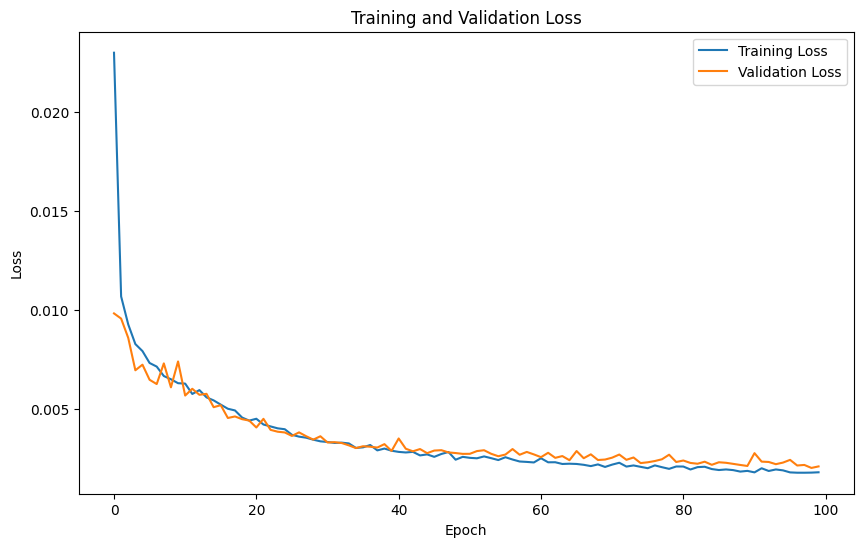

In [275]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt

# Assuming df3 is your DataFrame and it has been properly scaled already
scaler1 = MinMaxScaler()
scaler2 = MinMaxScaler()

# Prepare input-output pairs for training
num_samples = len(df4) - window_length
num_features = df4.shape[1] - 1  # Assuming the last column is the target variable

X = np.zeros((num_samples, window_length, num_features))  # 26 features
y = np.zeros((num_samples,))

for i in range(num_samples):
    X[i] = df4.iloc[i:i+window_length, :-1].values
    y[i] = df4.iloc[i+window_length, -1]

# Reshape X to 2D array for scaling
X_reshaped = X.reshape(-1, num_features)
X_scaled = scaler2.fit_transform(X_reshaped)
X = X_scaled.reshape(num_samples, window_length, num_features)

# Scale y
y = y.reshape(-1, 1)  # Reshape y to 2D array for scaling
y = scaler1.fit_transform(y).flatten()

# Split data into training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and compile model (assuming `model` is already defined)
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])

# Train model
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

44/44 [==============================] - 0s 7ms/step
R² Score: 0.9348276494309058
Mean Absolute Error (MAE): 0.03232603824767586
Mean Squared Error (MSE): 0.002359049789008447


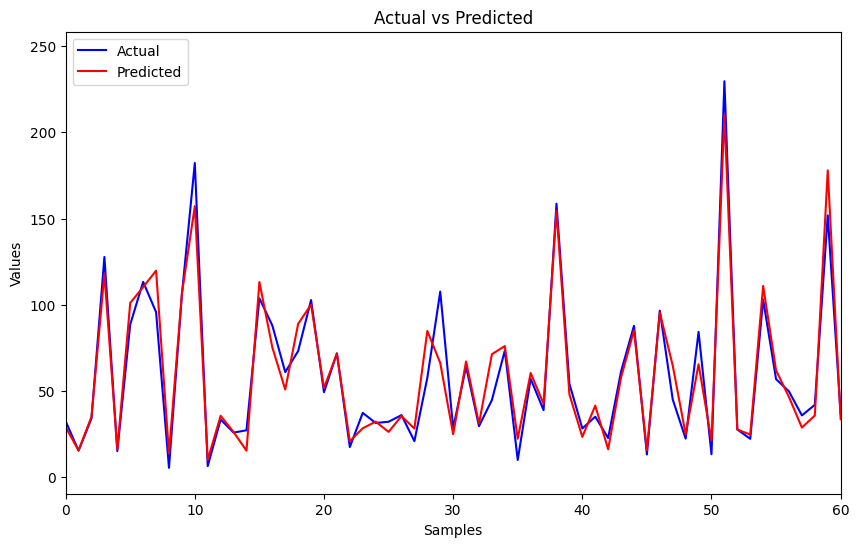

In [279]:

y_pred = model.predict(X_test)
# Calculate R² score
r2 = r2_score(y_test, y_pred)
print(f"R² Score: {r2}")

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(y_test, y_pred)
print(f"Mean Absolute Error (MAE): {mae}")

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error (MSE): {mse}")

y_test = np.reshape(y_test, (-1, 1))

# Reshape y_test to match the expected shape by scaler


# Inverse transform y_test and y_pred back to original scale
y_test_actual = scaler1.inverse_transform(y_test)
y_pred_actual = scaler1.inverse_transform(y_pred)

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(y_test_actual, label='Actual', color='blue')
plt.plot(y_pred_actual, label='Predicted', color='red')
plt.title('Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.xlim(0, 60)  # Set the x-axis limits for the first 110 samples
plt.legend()
plt.show()

In [290]:
import torch
import torch.nn as nn

class SegRNN(nn.Module):
    def __init__(self, input_size, hidden_size, num_segments, window_size):
        super(SegRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_segments = num_segments
        self.window_size = window_size
        
        # Encoding phase components
        self.encoder_projection = nn.Sequential(
            nn.Linear(input_size, hidden_size),
            nn.ReLU()
        )
        self.gru_encoder = nn.GRU(hidden_size, hidden_size)
        
        # Decoding phase components
        self.gru_decoder = nn.GRU(hidden_size, hidden_size)
        self.decoder_projection = nn.Linear(hidden_size, window_size)
    
    def forward(self, x):
        # Reshape input to (batch_size, L, C) -> (batch_size, L, C)
        batch_size, L, C = x.size()
        x = x.view(batch_size, L * C)
        
        # Encoding phase
        encoded_segments = []
        for i in range(self.num_segments):
            segment = x[:, i*self.window_size:(i+1)*self.window_size]
            encoded_segment = self.encoder_projection(segment)
            encoded_segment = encoded_segment.unsqueeze(0)  # Add batch dimension
            _, h_n = self.gru_encoder(encoded_segment)
            encoded_segments.append(h_n.squeeze(0))
        encoded_features = torch.stack(encoded_segments)
        
        # Decoding phase
        decoder_output = []
        decoder_hidden = encoded_features[-1].unsqueeze(0)  # Use last encoded feature as initial hidden state
        for i in range(self.num_segments):  # Predict each segment independently
            decoder_out, decoder_hidden = self.gru_decoder(decoder_hidden, decoder_hidden)
            decoded_segment = self.decoder_projection(decoder_out.squeeze(0))
            decoder_output.append(decoded_segment)
        decoder_output = torch.stack(decoder_output, dim=1).view(batch_size, self.num_segments * self.window_size)
        
        return decoder_output

# Example usage:
input_size = 5594*26  # Total number of features in each time step
hidden_size = 64 # Hidden state size
num_segments = 50 # Number of segments
window_size = 1  # Window size for each segment




NameError: name 'x' is not defined

In [281]:
df4.shape

(6994, 27)

In [282]:
X_train.shape

(5594, 1, 26)

In [284]:
import pandas as pd
import torch
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Assuming 'data' is your DataFrame with shape (6994, 27)
X = df4.iloc[:, :-1].values  # Features (all columns except the last one)
y = df4.iloc[:, -1].values   # Target (last column)

# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features (optional but recommended for neural networks)
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Convert numpy arrays to PyTorch tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test, dtype=torch.float32)


In [285]:
from torch.utils.data import Dataset, DataLoader

class MyDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y
        
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

# Create train and test datasets
train_dataset = MyDataset(X_train_tensor, y_train_tensor)
test_dataset = MyDataset(X_test_tensor, y_test_tensor)

# Create data loaders
batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size)


In [303]:
class SegRNN(nn.Module):
    def __init__(self, input_size, hidden_size, num_segments, window_size):
        super(SegRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_segments = num_segments
        self.window_size = window_size
        
        # Encoding phase components
        self.encoder_projection = nn.Sequential(
            nn.Linear(input_size, hidden_size),
            nn.ReLU()
        )
        self.gru_encoder = nn.GRU(hidden_size, hidden_size)
        
        # Decoding phase components
        self.gru_decoder = nn.GRU(hidden_size, hidden_size)
        self.decoder_projection = nn.Linear(hidden_size, window_size)
        
    # Ensure that window_size aligns with decoder_projection output size
 # Ensure this matches the expected output size of decoder_projection

# Verify forward pass in the SegRNN model
    def forward(self, x):
    # Encoding phase
        encoded_segments = []
        for i in range(self.num_segments):
            segment = x[:, i*self.window_size:(i+1)*self.window_size]
            encoded_segment = self.encoder_projection(segment)
            encoded_segment = encoded_segment.unsqueeze(0)  # Add batch dimension
            _, h_n = self.gru_encoder(encoded_segment)
            encoded_segments.append(h_n.squeeze(0))
        encoded_features = torch.stack(encoded_segments)
    
    # Decoding phase
        decoder_output = []
        decoder_hidden = encoded_features[-1].unsqueeze(0)  # Use last encoded feature as initial hidden state
        for i in range(self.num_segments):  # Predict each segment independently
            decoder_out, decoder_hidden = self.gru_decoder(decoder_hidden, decoder_hidden)
            decoded_segment = self.decoder_projection(decoder_out.squeeze(0))
            decoder_output.append(decoded_segment)
            decoder_output = torch.stack(decoder_output, dim=1).view(-1, self.num_segments * self.window_size)
    
        return decoder_output


# Create an instance of the SegRNN model
input_size = X_train.shape[1] # Number of features
hidden_size = 64
num_segments = 4  # Example: Divide input sequence into 4 segments
window_size = input_size // num_segments
model = SegRNN(input_size=input_size, hidden_size=hidden_size, num_segments=num_segments, window_size=window_size)
window_size = input_size // num_segments
assert window_size == 6

In [304]:
criterion = nn.L1Loss()  # Mean Absolute Error
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)


In [305]:
num_epochs = 10

for epoch in range(num_epochs):
    model.train()
    train_loss = 0.0
    
    for batch_X, batch_y in train_loader:
        optimizer.zero_grad()
        output = model(batch_X)
        loss = criterion(output, batch_y.view(-1, 1))
        loss.backward()
        optimizer.step()
        train_loss += loss.item() * batch_X.size(0)
    
    train_loss /= len(train_loader.dataset)
    
    # Evaluate on test set
    model.eval()
    test_loss = 0.0
    
    with torch.no_grad():
        for batch_X, batch_y in test_loader:
            output = model(batch_X)
            loss = criterion(output, batch_y.view(-1, 1))
            test_loss += loss.item() * batch_X.size(0)
    
    test_loss /= len(test_loader.dataset)
    
    print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}')


RuntimeError: mat1 and mat2 shapes cannot be multiplied (64x6 and 26x64)

In [289]:
# Print the shape of batch_X to verify dimensions
print(f"Batch X shape: {batch_X.shape}")  # Should be (batch_size, input_size)

# Check input_size used when creating the model
print(f"Input size expected by model: {input_size}")

# Update model definition if necessary to match input_size
model = SegRNN(input_size=input_size, hidden_size=hidden_size, num_segments=num_segments, window_size=window_size)

# Ensure that the model is in training mode before processing batches
model.train()

# Continue with training loop and debugging


Batch X shape: torch.Size([64, 26])
Input size expected by model: 26


SegRNN(
  (encoder_projection): Sequential(
    (0): Linear(in_features=26, out_features=64, bias=True)
    (1): ReLU()
  )
  (gru_encoder): GRU(64, 64)
  (gru_decoder): GRU(64, 64)
  (decoder_projection): Linear(in_features=64, out_features=6, bias=True)
)

In [306]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class SegRNN(nn.Module):
    def __init__(self, input_dim_d, input_dim_w, input_dim_L, hidden_dim, output_dim_d, output_dim_w, output_dim_H, num_layers, dropout=0.5):
        super(SegRNN, self).__init__()

        # Encoding phase
        self.transform_w = nn.Linear(input_dim_w, hidden_dim)
        self.transform_L = nn.Linear(input_dim_L, hidden_dim)
        self.relu = nn.ReLU()

        self.gru_encoder = nn.GRU(input_dim_d + hidden_dim * 2, hidden_dim, num_layers, batch_first=True)

        # Decoding phase
        self.gru_decoder = nn.GRU(hidden_dim * 2, hidden_dim, num_layers, batch_first=True)
        self.dropout = nn.Dropout(dropout)
        self.fc_d = nn.Linear(hidden_dim, output_dim_d)
        self.fc_w = nn.Linear(hidden_dim, output_dim_w)
        self.fc_H = nn.Linear(hidden_dim, output_dim_H)

    def forward(self, X_d, X_w, X_L, rel_enc, ch_enc):
        # Apply linear transformation and ReLU to X_w and X_L
        X_w_transformed = self.relu(self.transform_w(X_w))
        X_L_transformed = self.relu(self.transform_L(X_L))

        # Concatenate transformed inputs with X_d
        X_combined = torch.cat((X_d, X_w_transformed, X_L_transformed), dim=-1)

        # Pass through the GRU encoder
        h_enc, _ = self.gru_encoder(X_combined)

        # Get the last hidden state from the encoder
        h_last = h_enc[:, -1, :]

        # Concatenate with relative and channel encodings
        h_combined = torch.cat((h_last, rel_enc, ch_enc), dim=-1)
        h_combined = h_combined.unsqueeze(1).repeat(1, h_enc.size(1), 1)

        # Pass through the GRU decoder
        h_dec, _ = self.gru_decoder(h_combined)

        # Apply dropout
        h_dec = self.dropout(h_dec)

        # Apply linear transformation to get the final outputs
        Y_d = self.fc_d(h_dec)
        Y_w = self.fc_w(h_dec)
        Y_H = self.fc_H(h_dec)

        return Y_d, Y_w, Y_H
 # Output shapes should match the specified output dimensions